In [52]:
import xarray as xr
import numpy as np
import cftime
import nc_time_axis
import pandas as pd
import matplotlib.pyplot as plt 
from matplotlib import ticker, cm
#from cftime import datetime 
from datetime import datetime, timedelta
#import datetime as dt
import matplotlib.colors as colors
import math
import random
import matplotlib.cm as mcm
from matplotlib.ticker import MaxNLocator
#jet = mcm.get_cmap('jet')
jet = mcm.get_cmap('jet') if isinstance(mcm.get_cmap('jet'), str) else mcm.get_cmap('jet')
import netCDF4 as nc
import sys
import os
import psutil
import netCDF4 as nc
import cartopy.crs as ccrs # CRS stands for "Coordinate reference systems" for map projection
from cartopy.crs import PlateCarree
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from dateutil import tz
import pytz
import time
from time import process_time
from tqdm import tqdm
from dask.distributed import LocalCluster, Client
import dask.array as da
import dask.dataframe as dd
import dask
from dask import delayed
from dask.diagnostics import ProgressBar  # Import the ProgressBar class
import calendar
import glob
%matplotlib inline 
#import line_profiler
#%load_ext line_profiler

/tmp/ipykernel_527593/1870643686.py:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  jet = mcm.get_cmap('jet') if isinstance(mcm.get_cmap('jet'), str) else mcm.get_cmap('jet')


# Define_variables Function

In [59]:
def define_variables(lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape, newlat_shape, intlat_shape, crit_freq_on):

    Mptdens_sh = np.ndarray((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #(25, 336, 96, 144, 2, 3)  #Metal density in local time
    Mptdens_diff = np.ndarray((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)   #Difference between Metal density and average

    SpEs_sh_nan = np.empty((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape))  
    SpEs_sh_nan[:] = np.NaN #An array the same size as SpEs_sh filled with NaNs. Used for seletion criteria calculation

    Mptdens_avg_temp = np.empty((lev_shape, lat_shape, 3, time_it_shape, ds_months_shape), dtype=float)  #Temporary array used in calculation rebinning from 10min -> 30 min LT bins
    Mptdens_avg_b = np.empty((lev_shape, lat_shape, 48, time_it_shape, ds_months_shape), dtype=float)    #10 min bins (144 lon) -> 30 min bins (48 lon)
    #-------------------------------------------------
    Mptdens_avv1_b = np.empty((lev_shape, newlat_shape, time_it_shape, ds_months_shape), dtype=float)   #Mptdens_avv1 interpolated onto 1' lat array

    Mptdens_avv1_b_5d = np.empty((lev_shape, intlat_shape, time_it_shape, ds_months_shape), dtype=float) #Average M+ density in 5' lat slices (as ft of lev)
    max_Mptdens_avv1_b_5d = np.empty((intlat_shape, time_it_shape, ds_months_shape), dtype=float)        #Max of Mptdens_avv1_b_5d over lev dim

    #Equivalent to Mptdens_avv1_b_5d and max_Mptdens_avv1_b_5d but assigned to the correct index on a normal 96-long lat axis (so can use these in selectin criteria)
    Mptdens_avv1b5d_l = np.empty((lev_shape, lat_shape, time_it_shape, ds_months_shape), dtype=float) 
    max_Mptdens_avv1b5d_l = np.empty((lat_shape, time_it_shape, ds_months_shape), dtype=float) 
    #-------------------------------------------------
    Mptdens_avg_bb = np.empty((lev_shape, newlat_shape, 48, time_it_shape, ds_months_shape), dtype=float)  #binned into 30 min LT bins and binned into 1' lat slices


    Mptdens_avg_bb_5d = np.empty(  (lev_shape,intlat_shape, 48, time_it_shape, ds_months_shape )   , dtype=float )  #Mptdens_avg_b binned into 30 min LT bins and averaged in 5' lat slices
    Mptdens_avg_bb_5d_avg = np.empty((lev_shape, intlat_shape, 48, ds_months_shape), dtype=float)   #Monthly avg at each height/lat/lon
    Mptdens_avg_bb_5d_avglev = np.empty((intlat_shape, 48, ds_months_shape), dtype=float)  #Monthly avg over all levs
    Mptdens_avg_bb_5d_dsavg = np.ndarray((lev_shape, intlat_shape, 48), dtype = float)   #Dataset avg at each height/lat/lon
    Mptdens_avg_bb_5d_dsavglev = np.ndarray((intlat_shape, 48), dtype = float) #Dataset avg over all levs


    if crit_freq_on==1:
        edens_sh = np.ndarray((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #(25, 336, 96, 144, 2, 3) #e density in local time
        SpEs_e = np.ndarray((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #The e density where SpEs have been identified using Fe+ density  
        maxSpEs__e = np.ndarray((time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #max of SpEs_e in cm-3
        maxSpEs_e = np.ndarray((time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #max of SpEs_e in m-3
        foEs__m = np.ndarray((time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #Critical freq in Hz (calculated using max e- density over lev dim in m-3)
        foEs_m = np.ndarray((time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #Critical freq in MHz (calculated using max e- density over lev dim in m-3)
        foEs_m_av = np.ndarray((lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #Avg of foEs_m over lev dimension
        foEs_m_av_mth = np.ndarray((lat_shape, lon_shape, ds_months_shape), dtype = float) #Average of foEs_m_av over month
        foEs_m_av_ds = np.ndarray((lat_shape, lon_shape), dtype = float) #AVerage of foEs_m_av_mth over dataset (e.g. 3mth)  

    SpEs = np.ndarray((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #SpEs occurence frequency 
    SpEs_freq = np.empty((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape)) #SpE occurence in each grid space as 1s/0s
    SpEs_freq_time = np.empty((lev_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape))     #total SpE occurences in 2 week time period
    SpEs_Occ_Freq = np.ndarray((lev_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)  # SpEs_freq_time / no of timesteps -> occ freq as a %
    SpEs_Occ_Freq_temp = np.empty((lev_shape, lat_shape, 3, time_it_shape, ds_months_shape), dtype=float)  #Temporary array used in the calculation for 10 min bins (144 lon) -> 30 min bins (48 lon)
    #-------------------------------------------------
    SpEs_Occ_Fr_b = np.empty((lev_shape, lat_shape, 48, time_it_shape, ds_months_shape), dtype=float)    #10 min bins (144 lon) -> 30 min bins (48 lon)
    SpEs_Occ_Fr_b_avg = np.ndarray((lev_shape, lat_shape, 48, ds_months_shape), dtype = float)  #Monthly avg at each height/lat/lon
    SpEs_Occ_Fr_b_avglev = np.ndarray((lat_shape, 48, ds_months_shape), dtype = float)  #Monthly avg over all levs
    SpEs_Occ_Fr_b_dsavg = np.ndarray((lev_shape, lat_shape, 48), dtype = float)   #Dataset avg at each height/lat/lon
    SpEs_Occ_Fr_b_dsavglev = np.ndarray((lat_shape, 48), dtype = float) #Dataset avg over all levs

    SpEs_Occ_Fr_b_avgLT = np.ndarray((lev_shape, lat_shape, ds_months_shape), dtype = float)  #Monthly avg over all LTs
    SpEs_Occ_Fr_b_dsavgLT = np.ndarray((lev_shape, lat_shape), dtype = float)  #dataset avg over all LTs
    #-------------------------------------------------
    SpEs_Occ_Fr_bb = np.empty((lev_shape, newlat_shape, 48, time_it_shape, ds_months_shape), dtype=float) #SpEs_Occ_Fr_b interpolated onto newlat grid 1' spacing (180 long) (was 1.89')

    SpEs_Occ_Fr_bb_5d = np.empty(  (lev_shape,intlat_shape, 48, time_it_shape, ds_months_shape )   , dtype=float )  #SpEs_Occ_Fr_bb averaged into 5' lat slices
    SpEs_Occ_Fr_bb_5d_avg = np.empty((lev_shape, intlat_shape, 48, ds_months_shape), dtype=float)   #Monthly avg at each height/lat/lon
    SpEs_Occ_Fr_bb_5d_avglev = np.empty((intlat_shape, 48, ds_months_shape), dtype=float)   #Monthly avg over all levs
    SpEs_Occ_Fr_bb_5d_dsavg = np.ndarray((lev_shape, intlat_shape, 48), dtype = float)   #Dataset avg at each height/lat/lon
    SpEs_Occ_Fr_bb_5d_dsavglev = np.ndarray((intlat_shape, 48), dtype = float) #Dataset avg over all levs

    #Lat-Lon
    Mptdensns = np.ndarray((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)  #(25, 336, 96, 144, 2, 3)
    Mptdens_nsavg = np.ndarray((lev_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
    Mptdens_nsstd = np.ndarray((lev_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
    Mptdens_nsdiff = np.ndarray((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)   #Difference between Metal density and average
    Mptdens_nsavv1_b = np.empty((lev_shape, newlat_shape, time_it_shape, ds_months_shape), dtype=float)   #Mptdens_nsavv1 interpolated onto 1' lat array
    Mptdens_nsavv1_b_5d = np.empty((lev_shape, intlat_shape, time_it_shape, ds_months_shape), dtype=float) #Average M+ density in 5' lat slices (as ft of lev)
    max_Mptdens_nsavv1_b_5d = np.empty((intlat_shape, time_it_shape, ds_months_shape), dtype=float)        #Max of Mptdens_nsavv1_b_5d over lev dim
    #Equivalent to Mptdens_nsavv1_b_5d and max_Mptdens_nsavv1_b_5d but assigned to the correct index on a normal 96-long lat axis (so can use these in selectin criteria)
    Mptdens_nsavv1b5d_l = np.empty((lev_shape, lat_shape, time_it_shape, ds_months_shape), dtype=float) 
    max_Mptdens_nsavv1b5d_l = np.empty((lat_shape, time_it_shape, ds_months_shape), dtype=float) 

    if crit_freq_on==1:
        edensns = np.ndarray((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)  #(25, 336, 96, 144, 2, 3)
        SpEs_nse = np.ndarray((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #The e density where SpEs have been identified using Fe+ density
        maxSpEs__nse = np.ndarray((time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #max of SpEs_e in cm-3
        maxSpEs_nse = np.ndarray((time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #max of SpEs_e in m-3
        foEsns__m = np.ndarray((time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #Critical freq in Hz (calculated using max e- density over lev dim in m-3)
        foEsns_m = np.ndarray((time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #Critical freq in MHz (calculated using max e- density over lev dim in m-3)
        foEsns_m_av = np.ndarray((lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #Avg of foEs_m over lev dimension
        foEsns_m_av_mth = np.ndarray((lat_shape, lon_shape, ds_months_shape), dtype = float) #Average of foEs_m_av over month
        foEsns_m_av_ds = np.ndarray((lat_shape, lon_shape), dtype = float) #AVerage of foEs_m_av_mth over dataset (e.g. 3mth)  

    SpEsns = np.ndarray((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) #SpEs occurence frequency   
    SpEsns_freq_bool = np.empty((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape)) #SpE occurence in each grid space as True/False 
    SpEsns_freq = np.empty((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape)) #SpE occurence in each grid space as 1s/0s
    SpEsns_freq_time = np.empty((lev_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape))     #total SpE occurences in 2 week time period
    SpEsns_Occ_Freq = np.ndarray((lev_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)  # SpEs_freq_time / no of timesteps -> occ freq as a %
    SpEsns_Occ_Fr_avg = np.ndarray((lev_shape, lat_shape, lon_shape, ds_months_shape), dtype = float) #(25,96,144,3)
    SpEsns_Occ_Fr_avglev = np.ndarray((lat_shape, lon_shape, ds_months_shape), dtype = float)   #(96, 144, 3) 
    SpEsns_Occ_Fr_dsavg = np.ndarray((lev_shape, lat_shape, lon_shape), dtype = float)   #(25,96,144)
    SpEsns_Occ_Fr_dsavglev = np.ndarray((lat_shape, lon_shape), dtype = float)   #(#96, 144)
    
    #return locals()
    #return Mptdens_sh, Mptdens_diff, SpEs_sh_nan, Mptdens_avg_temp, Mptdens_avg_b, Mptdens_avv1_b, Mptdens_avv1_b_5d, max_Mptdens_avv1_b_5d, Mptdens_avv1b5d_l, max_Mptdens_avv1b5d_l, Mptdens_avg_bb, Mptdens_avg_bb_5d, Mptdens_avg_bb_5d_avg, Mptdens_avg_bb_5d_avglev, Mptdens_avg_bb_5d_dsavg, Mptdens_avg_bb_5d_dsavglev, edens_sh, SpEs_e, maxSpEs__e, maxSpEs_e, foEs__m, foEs_m, foEs_m_av, foEs_m_av_mth, foEs_m_av_ds, SpEs, SpEs_freq, SpEs_freq_time, SpEs_Occ_Freq, SpEs_Occ_Freq_temp, SpEs_Occ_Fr_b, SpEs_Occ_Fr_b_avg, SpEs_Occ_Fr_b_avglev, SpEs_Occ_Fr_b_dsavg, SpEs_Occ_Fr_b_dsavglev, SpEs_Occ_Fr_b_avgLT, SpEs_Occ_Fr_b_dsavgLT, SpEs_Occ_Fr_bb, SpEs_Occ_Fr_bb_5d, SpEs_Occ_Fr_bb_5d_avg, SpEs_Occ_Fr_bb_5d_avglev, SpEs_Occ_Fr_bb_5d_dsavg, SpEs_Occ_Fr_bb_5d_dsavglev, Mptdensns, Mptdens_nsavg, Mptdens_nsstd, Mptdens_nsdiff, Mptdens_nsavv1_b, Mptdens_nsavv1_b_5d, max_Mptdens_nsavv1_b_5d, Mptdens_nsavv1b5d_l, max_Mptdens_nsavv1b5d_l, edensns, SpEs_nse, maxSpEs__nse, maxSpEs_nse, foEsns__m, foEsns_m, foEsns_m_av, foEsns_m_av_mth, foEsns_m_av_ds, SpEsns, SpEsns_freq_bool, SpEsns_freq, SpEsns_freq_time, SpEsns_Occ_Freq, SpEsns_Occ_Fr_avg, SpEsns_Occ_Fr_avglev, SpEsns_Occ_Fr_dsavg, SpEsns_Occ_Fr_dsavglev
    
    if crit_freq_on == 1:
        return Mptdens_sh, Mptdens_diff, SpEs_sh_nan, Mptdens_avg_temp, Mptdens_avg_b, Mptdens_avv1_b, Mptdens_avv1_b_5d, max_Mptdens_avv1_b_5d, Mptdens_avv1b5d_l, max_Mptdens_avv1b5d_l, Mptdens_avg_bb, Mptdens_avg_bb_5d, Mptdens_avg_bb_5d_avg, Mptdens_avg_bb_5d_avglev, Mptdens_avg_bb_5d_dsavg, Mptdens_avg_bb_5d_dsavglev, edens_sh, SpEs_e, maxSpEs__e, maxSpEs_e, foEs__m, foEs_m, foEs_m_av, foEs_m_av_mth, foEs_m_av_ds, SpEs, SpEs_freq, SpEs_freq_time, SpEs_Occ_Freq, SpEs_Occ_Freq_temp, SpEs_Occ_Fr_b, SpEs_Occ_Fr_b_avg, SpEs_Occ_Fr_b_avglev, SpEs_Occ_Fr_b_dsavg, SpEs_Occ_Fr_b_dsavglev, SpEs_Occ_Fr_b_avgLT, SpEs_Occ_Fr_b_dsavgLT, SpEs_Occ_Fr_bb, SpEs_Occ_Fr_bb_5d, SpEs_Occ_Fr_bb_5d_avg, SpEs_Occ_Fr_bb_5d_avglev, SpEs_Occ_Fr_bb_5d_dsavg, SpEs_Occ_Fr_bb_5d_dsavglev, Mptdensns, Mptdens_nsavg, Mptdens_nsstd, Mptdens_nsdiff, Mptdens_nsavv1_b, Mptdens_nsavv1_b_5d, max_Mptdens_nsavv1_b_5d, Mptdens_nsavv1b5d_l, max_Mptdens_nsavv1b5d_l, edensns, SpEs_nse, maxSpEs__nse, maxSpEs_nse, foEsns__m, foEsns_m, foEsns_m_av, foEsns_m_av_mth, foEsns_m_av_ds, SpEsns, SpEsns_freq_bool, SpEsns_freq, SpEsns_freq_time, SpEsns_Occ_Freq, SpEsns_Occ_Fr_avg, SpEsns_Occ_Fr_avglev, SpEsns_Occ_Fr_dsavg, SpEsns_Occ_Fr_dsavglev

    else:
        # Calculate variables when crit_freq_on is 0
        edens_sh = None
        SpEs_e = None
        maxSpEs__e = None
        maxSpEs_e = None
        foEs__m = None
        foEs_m = None
        foEs_m_av = None
        foEs_m_av_mth = None
        foEs_m_av_ds = None
        
        edensns = None
        SpEs_nse = None
        maxSpEs__nse = None
        maxSpEs_nse = None
        foEsns__m = None
        foEsns_m = None
        foEsns_m_av = None
        foEsns_m_av_mth = None
        foEsns_m_av_ds = None

        return Mptdens_sh, Mptdens_diff, SpEs_sh_nan, Mptdens_avg_temp, Mptdens_avg_b, Mptdens_avv1_b, Mptdens_avv1_b_5d, max_Mptdens_avv1_b_5d, Mptdens_avv1b5d_l, max_Mptdens_avv1b5d_l, Mptdens_avg_bb, Mptdens_avg_bb_5d, Mptdens_avg_bb_5d_avg, Mptdens_avg_bb_5d_avglev, Mptdens_avg_bb_5d_dsavg, Mptdens_avg_bb_5d_dsavglev, edens_sh, SpEs_e, maxSpEs__e, maxSpEs_e, foEs__m, foEs_m, foEs_m_av, foEs_m_av_mth, foEs_m_av_ds, SpEs, SpEs_freq, SpEs_freq_time, SpEs_Occ_Freq, SpEs_Occ_Freq_temp, SpEs_Occ_Fr_b, SpEs_Occ_Fr_b_avg, SpEs_Occ_Fr_b_avglev, SpEs_Occ_Fr_b_dsavg, SpEs_Occ_Fr_b_dsavglev, SpEs_Occ_Fr_b_avgLT, SpEs_Occ_Fr_b_dsavgLT, SpEs_Occ_Fr_bb, SpEs_Occ_Fr_bb_5d, SpEs_Occ_Fr_bb_5d_avg, SpEs_Occ_Fr_bb_5d_avglev, SpEs_Occ_Fr_bb_5d_dsavg, SpEs_Occ_Fr_bb_5d_dsavglev, Mptdensns, Mptdens_nsavg, Mptdens_nsstd, Mptdens_nsdiff, Mptdens_nsavv1_b, Mptdens_nsavv1_b_5d, max_Mptdens_nsavv1_b_5d, Mptdens_nsavv1b5d_l, max_Mptdens_nsavv1b5d_l, edensns, SpEs_nse, maxSpEs__nse, maxSpEs_nse, foEsns__m, foEsns_m, foEsns_m_av, foEsns_m_av_mth, foEsns_m_av_ds, SpEsns, SpEsns_freq_bool, SpEsns_freq, SpEsns_freq_time, SpEsns_Occ_Freq, SpEsns_Occ_Fr_avg, SpEsns_Occ_Fr_avglev, SpEsns_Occ_Fr_dsavg, SpEsns_Occ_Fr_dsavglev

# Save_results Function

In [66]:
def save_results(run_name, Crit_name, Monthfolderstr, lev_sl, timear, lat, intlat, lon, time_ar_2wk, ds_months, Zavg_sl, times_str_min, times_str_max, SpEs_Occ_Fr_b_dsavglevLT, SpEs_Occ_Fr_b_dsavglev, SpEs_Occ_Fr_b_dsavg, SpEs_Occ_Fr_b_avg, SpEs_Occ_Fr_bb_5d_dsavg, SpEs_Occ_Fr_bb_5d_avg, SpEsns_Occ_Fr_dsavglev, SpEsns_Occ_Fr_avglev, SpEsns_Occ_Fr_dsavg, SpEsns_Occ_Fr_avg, SpEs):
    
    #output_file = f'Nc_Files/SpE_Output/{str(run_name)}_{Crit_name}_SpE_Output_{str(Monthfolderstr)}.nc'
    output_file = f'Nc_Files/SpE_Output/{str(run_name)}_SpE_Output_{str(Monthfolderstr)}.nc'
    

    with nc.Dataset(output_file, 'w') as dataset:

        # Create dimensions
        dataset.createDimension('lev_sl', len(lev_sl))
        dataset.createDimension('time', len(timear))
        dataset.createDimension('lat', len(lat))
        dataset.createDimension('latsl', len(intlat))
        dataset.createDimension('lon', len(lon))
        dataset.createDimension('LT', 48)
        dataset.createDimension('LT_L', 144)
        dataset.createDimension('timesl', 2)
        dataset.createDimension('mth', 3)

        # Create coordinate variables
        lev_coord = dataset.createVariable('lev_sl', 'f8', ('lev_sl',))
        time_coord = dataset.createVariable('time', 'f8', ('time',))
        lat_coord = dataset.createVariable('lat', 'f8', ('lat',))
        latsl_coord = dataset.createVariable('latsl', 'f8', ('latsl',))
        lon_coord = dataset.createVariable('lon', 'f8', ('lon',))
        LT_coord = dataset.createVariable('LT', 'f8', ('LT',))
        LT_L_coord = dataset.createVariable('LT_L', 'f8', ('LT_L',))
        timesl_coord = dataset.createVariable('timesl', 'f8', ('timesl',))
        mth_coord = dataset.createVariable('mth', 'f8', ('mth',))

        # Assign values to coordinate variables
        lev_coord[:] = lev_sl[:]
        time_coord[:] = timear[:]
        lat_coord[:] = lat[:]
        latsl_coord[:] = intlat[:]
        lon_coord[:] = lon[:]
        LT_coord[:] = np.arange(0, 24, 24/48)  #0-23.5, 48 long
        LT_L_coord[:] = testcheck = np.arange(0, 24, 24/144)   #0-23.833, 144 long
        timesl_coord[:] = time_ar_2wk[:]
        mth_coord[:] = ds_months[:]

        # Create and save arrays as variables

        Zavg_sl_v = dataset.createVariable('Zavg_sl', 'f8', ('lev_sl',))
        Zavg_sl_v[:] = Zavg_sl[:]
        Zavg_sl_v.setncattr('units', 'km')
        Zavg_sl_v.setncattr('description', 'Average Geopotential height')

        times_str_min_v = dataset.createVariable('times_str_min', 'S21', ('mth', 'timesl'))
        times_str_min_v[:] = times_str_min[:]
        times_str_min_v.setncattr('description', 'Timeslice min')

        times_str_max_v = dataset.createVariable('times_str_max', 'S21', ('mth', 'timesl'))
        times_str_max_v[:] = times_str_max[:]
        times_str_max_v.setncattr('description', 'Timeslice min')

        SpEs_Occ_Fr_b_dsavglevLT_v = dataset.createVariable('SpEs_Occ_Fr_b_dsavglevLT', 'f8', ('lat',))
        SpEs_Occ_Fr_b_dsavglevLT_v[:] = SpEs_Occ_Fr_b_dsavglevLT[:]
        SpEs_Occ_Fr_b_dsavglevLT_v.setncattr('units', '%')
        SpEs_Occ_Fr_b_dsavglevLT_v.setncattr('description', 'Occ Freq - ds average over all heights (lat)')

        SpEs_Occ_Fr_b_dsavglev_v = dataset.createVariable('SpEs_Occ_Fr_b_dsavglev', 'f8', ('lat', 'LT'))
        SpEs_Occ_Fr_b_dsavglev_v[:] = SpEs_Occ_Fr_b_dsavglev[:]
        SpEs_Occ_Fr_b_dsavglev_v.setncattr('units', '%')
        SpEs_Occ_Fr_b_dsavglev_v.setncattr('description', 'Occ Freq - ds average over all heights (lat,LT)')

        SpEs_Occ_Fr_b_avglev_v = dataset.createVariable('SpEs_Occ_Fr_b_avglev', 'f8', ('lat', 'LT', 'mth'))
        SpEs_Occ_Fr_b_avglev_v[:] = SpEs_Occ_Fr_b_avglev[:]
        SpEs_Occ_Fr_b_avglev_v.setncattr('units', '%')
        SpEs_Occ_Fr_b_avglev_v.setncattr('description', 'Occ Freq - monthly average over all heights (lat,LT,mth)')

        SpEs_Occ_Fr_b_dsavg_v = dataset.createVariable('SpEs_Occ_Fr_b_dsavg', 'f8', ('lev_sl', 'lat', 'LT'))
        SpEs_Occ_Fr_b_dsavg_v[:] = SpEs_Occ_Fr_b_dsavg[:]
        SpEs_Occ_Fr_b_dsavg_v.setncattr('units', '%')
        SpEs_Occ_Fr_b_dsavg_v.setncattr('description', 'Occ Freq - ds average at each height (lev_sl,lat,LT)')

        SpEs_Occ_Fr_b_avg_v = dataset.createVariable('SpEs_Occ_Fr_b_avg', 'f8', ('lev_sl', 'lat', 'LT', 'mth'))
        SpEs_Occ_Fr_b_avg_v[:] = SpEs_Occ_Fr_b_avg[:]
        SpEs_Occ_Fr_b_avg_v.setncattr('units', '%')
        SpEs_Occ_Fr_b_avg_v.setncattr('description', 'Occ Freq - monthly average at each height (lev_sl,lat,LT,mth)')

        SpEs_Occ_Fr_b_dsavgLT_v = dataset.createVariable('SpEs_Occ_Fr_b_dsavgLT', 'f8', ('lev_sl', 'lat'))
        SpEs_Occ_Fr_b_dsavgLT_v[:] = SpEs_Occ_Fr_b_dsavgLT[:]
        SpEs_Occ_Fr_b_dsavgLT_v.setncattr('units', '%')
        SpEs_Occ_Fr_b_dsavgLT_v.setncattr('description', 'Occ Freq - ds average over all LTs (lev_sl,lat)')

        SpEs_Occ_Fr_b_avgLT_v = dataset.createVariable('SpEs_Occ_Fr_b_avgLT', 'f8', ('lev_sl', 'lat', 'mth'))
        SpEs_Occ_Fr_b_avgLT_v[:] = SpEs_Occ_Fr_b_avgLT[:]
        SpEs_Occ_Fr_b_avgLT_v.setncattr('units', '%')
        SpEs_Occ_Fr_b_avgLT_v.setncattr('description', 'Occ Freq - monthly average over all LTs (lev_sl,lat,mth)')

        SpEs_Occ_Fr_bb_5d_dsavg_v = dataset.createVariable('SpEs_Occ_Fr_bb_5d_dsavg', 'f8', ('lev_sl', 'latsl', 'LT'))
        SpEs_Occ_Fr_bb_5d_dsavg_v[:] = SpEs_Occ_Fr_bb_5d_dsavg[:]
        SpEs_Occ_Fr_bb_5d_dsavg_v.setncattr('units', '%')
        SpEs_Occ_Fr_bb_5d_dsavg_v.setncattr('description', 'Occ Freq - ds average at each height in 5deg lat band (lev_sl,latsl,LT)')

        SpEs_Occ_Fr_bb_5d_avg_v = dataset.createVariable('SpEs_Occ_Fr_bb_5d_avg', 'f8', ('lev_sl', 'latsl', 'LT', 'mth'))
        SpEs_Occ_Fr_bb_5d_avg_v[:] = SpEs_Occ_Fr_bb_5d_avg[:]
        SpEs_Occ_Fr_bb_5d_avg_v.setncattr('units', '%')
        SpEs_Occ_Fr_bb_5d_avg_v.setncattr('description', 'Occ Freq - monthly average at each height in 5deg lat band (lev_sl,latsl,LT,mth)')

        SpEsns_Occ_Fr_dsavglev_v = dataset.createVariable('SpEsns_Occ_Fr_dsavglev', 'f8', ('lat', 'lon'))
        SpEsns_Occ_Fr_dsavglev_v[:] = SpEsns_Occ_Fr_dsavglev[:]
        SpEsns_Occ_Fr_dsavglev_v.setncattr('units', '%')
        SpEsns_Occ_Fr_dsavglev_v.setncattr('description', 'Occ Freq - ds average over all heights (lat,lon)')

        SpEsns_Occ_Fr_avglev_v = dataset.createVariable('SpEsns_Occ_Fr_avglev', 'f8', ('lat', 'lon', 'mth'))
        SpEsns_Occ_Fr_avglev_v[:] = SpEsns_Occ_Fr_avglev[:]
        SpEsns_Occ_Fr_avglev_v.setncattr('units', '%')
        SpEsns_Occ_Fr_avglev_v.setncattr('description', 'Occ Freq - monthly average over all heights (lat,lon,mth)')

        SpEsns_Occ_Fr_dsavg_v = dataset.createVariable('SpEsns_Occ_Fr_dsavg', 'f8', ('lev_sl', 'lat', 'lon'))
        SpEsns_Occ_Fr_dsavg_v[:] = SpEsns_Occ_Fr_dsavg[:]
        SpEsns_Occ_Fr_dsavg_v.setncattr('units', '%')
        SpEsns_Occ_Fr_dsavg_v.setncattr('description', 'Occ Freq - ds average at each height (lev_sl,lat,lon)')

        SpEsns_Occ_Fr_avg_v = dataset.createVariable('SpEsns_Occ_Fr_avg', 'f8', ('lev_sl', 'lat', 'lon', 'mth'))
        SpEsns_Occ_Fr_avg_v[:] = SpEsns_Occ_Fr_avg[:]
        SpEsns_Occ_Fr_avg_v.setncattr('units', '%')
        SpEsns_Occ_Fr_avg_v.setncattr('description', 'Occ Freq - monthly average at each height (lev_sl,lat,lon,mth)')

        
        # LOCAL TIME
        SpEs_v = dataset.createVariable('SpEs', 'f8', ('lev_sl', 'time', 'lat', 'LT_L', 'timesl', 'mth'))
        SpEs_v[:] = SpEs[:]
        SpEs_v.setncattr('units', '%')
        SpEs_v.setncattr('description', 'Metal density (LT(144)) where Es layer identified (lev_sl,time,lat,LT_L,timesl,mth)')

        Mptdens_sh_v = dataset.createVariable('Mptdens_sh', 'f8', ('lev_sl', 'time', 'lat', 'LT_L', 'timesl', 'mth'))
        Mptdens_sh_v[:] = Mptdens_sh[:]
        Mptdens_sh_v.setncattr('units', 'cm-3')
        Mptdens_sh_v.setncattr('description', 'Metal density (LT(144)) (lev_sl,time,lat,LT_L,timesl,mth)')

        
        # LAT-LON
        SpEsns_v = dataset.createVariable('SpEsns', 'f8', ('lev_sl', 'time', 'lat', 'lon', 'timesl', 'mth'))
        SpEsns_v[:] = SpEsns[:]
        SpEsns_v.setncattr('units', '%')
        SpEsns_v.setncattr('description', 'Metal density (lon) where Es layer identified (lev_sl,time,lat,lon,timesl,mth)')

        Mptdensns_v = dataset.createVariable('Mptdensns', 'f8', ('lev_sl', 'time', 'lat', 'lon', 'timesl', 'mth'))
        Mptdensns_v[:] = Mptdensns[:]
        Mptdensns_v.setncattr('units', 'cm-3')
        Mptdensns_v.setncattr('description', 'Metal density (lon) (lev_sl,time,lat,lon,timesl,mth)')

    print(f"Results saved to {output_file}")

# Dimension sizes & other parameters

In [67]:
def setup_parameters():
    # Set time parameters - No of time samples to iterate over (2x 2 week periods)
    time_it_shape = 2   
    time_ind_2wk_min = [0, 336]
    time_ind_2wk_max = [335, 671]

    # Set time parameters - No of timesteps in one time sample (2 week period)
    time_shape = 336
    timear = np.arange(0, time_shape)  # 2 week period (hourly data)

    # Lon parameters
    lon_shape = 144
    lonar = np.arange(0, lon_shape)        
    it_arr = np.arange(0, 48)  # array 0->47   #0.5h LT bins
    it_ar = np.arange(1, 48)  # array 1->47 # Used to bin LT (144x 10 min bins) into 0.5h LT bins. N.B. Starting from index1 as index0 is calculated differently

    # Lat parameters
    lat_shape = 96
    latar = np.arange(0, lat_shape)

    # Lat grid in 1' increments
    newlat = np.arange(-89.5, 90.5, 1)
    newlat_shape = 180

    # Lat grid in 5' slices (each index is centrepoint of slice)
    intlat = np.arange(-87.5, 92.5, 5)
    intlat_shape = 36
    intlat_ar = np.arange(0, intlat_shape)  # array 0->35

    # Slice arrays (lev, altitude) between chosen range
    lev_sl_idx_min = 41      # Old 42
    lev_sl_idx_max = 60      # Old 66
    lev_shape = (lev_sl_idx_max - lev_sl_idx_min) + 1 #20         # Old 25
    levar = np.arange(0, lev_shape) #0-19          # Old 0-24

    # Create an array with offset needed for each UT time step (24h period)
    # Offset by 15 degrees lon each time, lon axis is in 2.5 degree intervals
    offset = np.arange(0, 24) * 15 / 2.5 
    offset = offset.astype(int)
    offset = np.tile(offset, 336)  # tile the array for 2 weeks of 1hrly timesteps 2wks * 168timesteps = 336

    # Return all the defined arrays as a tuple
    return time_it_shape, time_ind_2wk_min, time_ind_2wk_max, time_shape, timear, lon_shape, lonar, it_arr, it_ar, lat_shape, latar, newlat, newlat_shape, intlat, intlat_shape, intlat_ar, lev_sl_idx_min, lev_sl_idx_max, lev_shape, levar, offset


# Main calculations - for SpEs and crit freq

In [70]:
dst.variables['Z3'].shape #(126, 744, 96, 144)

(126, 744, 96, 144)

In [69]:
start_time = time.process_time() 


#////////////////////////////  Things to check/change before running  ////////////////////////////////////
crit_freq_on = 0

### REMOVED THIS FROM FILE PATH ###
#Crit_name = 'No_glbavg' # Current criteria name
Crit_name = 'B' # Current criteria name


run_name = 'Wuhu_IonTr_run'    #'Jianfei_run','Wuhu_IonTr_run_6m'


# ds_months_sets = [['12','01','02'], ['03','04','05'], ['06','07','08'], ['09','10','11']]
# Monthstr_sets = [['Dec', 'Jan', 'Feb'], ['Mar', 'Apr', 'May'], ['Jun', 'Jul', 'Aug'], ['Sep', 'Oct', 'Nov']]
# season_set = ['winter', 'spring', 'summer', 'autumn']

# ds_months_sets = [['12','01','02']]
# Monthstr_sets = [['Dec', 'Jan', 'Feb']]
# season_set = ['winter']

# ds_months_sets = [['09','10','11']]
# Monthstr_sets = [['Sep', 'Oct', 'Nov']]
# season_set = ['autumn']

ds_months_sets = [ ['03','04','05'], ['06','07','08'], ['09','10','11']]
Monthstr_sets = [ ['Mar', 'Apr', 'May'], ['Jun', 'Jul', 'Aug'], ['Sep', 'Oct', 'Nov']]
season_set = [ 'spring', 'summer', 'autumn']



#/////////////////////////////////////////////////////////////////////////////////////////////////////////


for set_idx in range(len(ds_months_sets)):
    ds_months = ds_months_sets[set_idx]
    ds_months_shape = len(ds_months)
    Monthstr = Monthstr_sets[set_idx]
    print(season_set[set_idx])

    #--------------------------------------------------------------------------------------------------
    time_ar_2wk = np.arange(0,2)
    if ds_months_shape == 1:
        times_str_min = np.array( (time_ar_2wk) , dtype=str  ) 
        times_str_max = np.array( (time_ar_2wk) , dtype=str  ) 
    elif ds_months_shape ==2:
        times_str_min = np.array( (time_ar_2wk,time_ar_2wk) , dtype=str  ) 
        times_str_max = np.array( (time_ar_2wk,time_ar_2wk) , dtype=str  ) 
    elif ds_months_shape ==3:   
        times_str_min = np.array( (time_ar_2wk,time_ar_2wk,time_ar_2wk) , dtype=str  ) 
        times_str_max = np.array( (time_ar_2wk,time_ar_2wk,time_ar_2wk) , dtype=str  ) 
    #--------------------------------------------------------------------------------------------------

    Monthfolderstr = Monthstr[0] + '-' + Monthstr[-1]
    if ds_months_shape == 1:
        Monthfolderstr = Monthstr[0]

    ds_months_ar = np.arange(0,ds_months_shape)   #[0,1,2]
    #--------------------------------------------------------------------------------------------------

    
    #Call setup parameters function
    time_it_shape, time_ind_2wk_min, time_ind_2wk_max, time_shape, timear, lon_shape,lonar, it_arr, it_ar, lat_shape, latar, newlat, newlat_shape, intlat, intlat_shape, intlat_ar, lev_sl_idx_min, lev_sl_idx_max, lev_shape, levar, offset = setup_parameters()
    #setup_parameters()
    
    #------------------ Variables for selection criteria ----------------------------------------------
    sigma_val = 1   #1sigma~68%   1.5sigma~87%   2sigma~95%
    sigma_val_str = str(sigma_val)


    Mptdens_sh, Mptdens_diff, SpEs_sh_nan, Mptdens_avg_temp, Mptdens_avg_b, Mptdens_avv1_b, Mptdens_avv1_b_5d, max_Mptdens_avv1_b_5d, Mptdens_avv1b5d_l, max_Mptdens_avv1b5d_l, Mptdens_avg_bb, Mptdens_avg_bb_5d, Mptdens_avg_bb_5d_avg, Mptdens_avg_bb_5d_avglev, Mptdens_avg_bb_5d_dsavg, Mptdens_avg_bb_5d_dsavglev, edens_sh, SpEs_e, maxSpEs__e, maxSpEs_e, foEs__m, foEs_m, foEs_m_av, foEs_m_av_mth, foEs_m_av_ds, SpEs, SpEs_freq, SpEs_freq_time, SpEs_Occ_Freq, SpEs_Occ_Freq_temp, SpEs_Occ_Fr_b, SpEs_Occ_Fr_b_avg, SpEs_Occ_Fr_b_avglev, SpEs_Occ_Fr_b_dsavg, SpEs_Occ_Fr_b_dsavglev, SpEs_Occ_Fr_b_avgLT, SpEs_Occ_Fr_b_dsavgLT, SpEs_Occ_Fr_bb, SpEs_Occ_Fr_bb_5d, SpEs_Occ_Fr_bb_5d_avg, SpEs_Occ_Fr_bb_5d_avglev, SpEs_Occ_Fr_bb_5d_dsavg, SpEs_Occ_Fr_bb_5d_dsavglev, Mptdensns, Mptdens_nsavg, Mptdens_nsstd, Mptdens_nsdiff, Mptdens_nsavv1_b, Mptdens_nsavv1_b_5d, max_Mptdens_nsavv1_b_5d, Mptdens_nsavv1b5d_l, max_Mptdens_nsavv1b5d_l, edensns, SpEs_nse, maxSpEs__nse, maxSpEs_nse, foEsns__m, foEsns_m, foEsns_m_av, foEsns_m_av_mth, foEsns_m_av_ds, SpEsns, SpEsns_freq_bool, SpEsns_freq, SpEsns_freq_time, SpEsns_Occ_Freq, SpEsns_Occ_Fr_avg, SpEsns_Occ_Fr_avglev, SpEsns_Occ_Fr_dsavg, SpEsns_Occ_Fr_dsavglev = define_variables(lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape, newlat_shape, intlat_shape, crit_freq_on)

    #--------------------------------------------------------------------------------------------------

    for ids in ds_months_ar:
        #===================================================================================================
        loop_start_time = time.process_time() 
        #===================================================================================================
        if run_name=='Jianfei_run':
            file1name =f'Nc_Files/Jianfei_WACCMX_files/waccmx_Fe_Fep_{ds_months[ids]}.nc'
            ds = xr.open_dataset(file1name)
        elif run_name=='Wuhu_IonTr_run':
            file1name=f'Nc_Files/ACP_CESM213_FX2000_f19_f19_mg16_Na_Fe_Mg_iontransport/ACP_CESM213_FX2000_f19_f19_mg16_Na_Fe_Mg_iontransport.cam.h2.0001-{ds_months[ids]}-*.nc'
            ds = xr.open_mfdataset(file1name)
        elif run_name=='Wuhu_IonTr_run_6m':
            file1name=f'Nc_Files/CESM213_FX2000_f19_f19_mg16_Na_Fe_Mg_Si_Ca_K_iontransport/CESM213_FX2000_f19_f19_mg16_Na_Fe_Mg_Si_Ca_K_iontransport.cam.h2.0001-{ds_months[ids]}-*.nc' 
            ds = xr.open_mfdataset(file1name)
        #===================================================================================================

        print(f'Dataset: Month {str(ds_months[ids])}') 

        timee = ds.variables['time']
        start_cftime_date = f'0001-{str(ds_months[ids])}-01'
        times = xr.cftime_range(start=start_cftime_date, periods=672, freq="1H", calendar="noleap")    

        lon = ds.variables['lon']
        lat = ds.variables['lat']
        lev = ds.variables['lev']
        dst = ds.transpose("lev", ...)
        #===================================================================================================

        if run_name=='Jianfei_run':
            file2name='Nc_Files/Jianfei_WACCMX_files/waccmx_Z3_T_e_' + ds_months[ids] + '.nc' 
            ds2 = xr.open_dataset(file2name) 
            ds2t = ds2.transpose("lev", ...)
            temp = ds2t.variables['T']
            geopH = ds2t.variables['Z3'] / 1000 #m-> km
            if crit_freq_on==1:
                elect = ds2t.variables['e']
        elif run_name=='Wuhu_IonTr_run' or run_name=='Wuhu_IonTr_run_6m':
            temp = dst.variables['T']
            elect = dst.variables['e']
            geopH = dst.variables['Z3'] / 1000 #m-> km    #(126, 744, 96, 144)
        #===================================================================================================

        #Mpt = dst.variables['Fep'] 
        
        Fept = dst.variables['Fep']
        Mgpt = dst.variables['Mgp']
        Napt = dst.variables['Nap']
        
        
        Zavg = geopH.mean(('time','lat', 'lon'))   #(126)
        Zavg_latlon = geopH.mean(('time'))    #(126, 96, 144)
        #===================================================================================================

        # Slice arrays (lev & alt) between chosen range & print
        lev_sl = lev[lev_sl_idx_min:lev_sl_idx_max+1]
        Zavg_sl = Zavg[lev_sl_idx_min:lev_sl_idx_max+1]  #(20)
        Zavg_latlon_sl = Zavg_latlon[lev_sl_idx_min:lev_sl_idx_max+1,:,:]  #(20, 96, 144)
        geopH_sl = geopH[lev_sl_idx_min:lev_sl_idx_max+1,:,:,:]    #(20, 744, 96, 144) 

        print(f'    Array lev = {str("%.1e" % lev[lev_sl_idx_max])}hPa : {str("%.1e" % lev[lev_sl_idx_min])}hPa'
                   + f' (approx {str("%.0f" % Zavg[lev_sl_idx_max])}km : {str("%.0f" % Zavg[lev_sl_idx_min])}km)'   )


        for it2 in time_ar_2wk:
            #===================================================================================================
            loop1_start_time = time.process_time() 
            #===================================================================================================

            #Select time indices for current loop iteration
            times_idx_min = time_ind_2wk_min[it2]
            times_idx_max = time_ind_2wk_max[it2]

            # Generate time strings for figure labelling
            if ds_months_shape>1:
                times_str_min[ids][it2] = str( times[times_idx_min] ) #~~#
                times_str_max[ids][it2] = str( times[times_idx_max] ) #~~#
                print( '      Time slice ' + str(it2+1) + ' = ' +times_str_min[ids][it2] + ' : ' + times_str_max[ids][it2] ) 
            else:
                times_str_min[it2] = str( times[times_idx_min] ) #~~#
                times_str_max[it2] = str( times[times_idx_max] ) #~~#
                print( '      Time slice ' + str(it2+1) + ' = ' + str( times_str_min[it2] ) + ' : ' + str( times_str_max[it2] ) ) 
            #===================================================================================================

            # Slice arrays by chosen alt range and time range 
            tempe = temp[lev_sl_idx_min:lev_sl_idx_max+1,times_idx_min:times_idx_max+1,:,:]
            
            # Mp_t = Mpt[lev_sl_idx_min:lev_sl_idx_max+1,times_idx_min:times_idx_max+1,:,:]
            Fep_t = Mpt[lev_sl_idx_min:lev_sl_idx_max+1,times_idx_min:times_idx_max+1,:,:]
            Mgp_t = Mpt[lev_sl_idx_min:lev_sl_idx_max+1,times_idx_min:times_idx_max+1,:,:]
            Nap_t = Mpt[lev_sl_idx_min:lev_sl_idx_max+1,times_idx_min:times_idx_max+1,:,:]

            if crit_freq_on==1:
                elec = elect[lev_sl_idx_min:lev_sl_idx_max+1,times_idx_min:times_idx_max+1,:,:]
            #===================================================================================================

            # VMR to number density calculation
            #Mptdens = ( Mp_t * 1e-6 * 100 * lev_sl ) / (1.380503e-23 * tempe) #Mptdens.shape = (25, 336, 96, 144)

            Feptdens = ( Fep_t * 1e-6 * 100 * lev_sl ) / (1.380503e-23 * tempe)
            Mgptdens = ( Mgp_t * 1e-6 * 100 * lev_sl ) / (1.380503e-23 * tempe)
            Naptdens = ( Nap_t * 1e-6 * 100 * lev_sl ) / (1.380503e-23 * tempe)
            
            Mptdens = Feptdens + (2 * Mgptdens ) + Naptdens
            
            if crit_freq_on==1:
                edens = ( elec * 1e-6 * 100 * lev_sl ) / (1.380503e-23 * tempe)


            #////////////////////////////////////////////////////////////////////////////////////////////////////////////////////
            #=========================For Lat-LT PLOTS. Must use shifted Mptdens============================
            #===================================================================================================
            #Iterate over timear (2wk period, hrly data), offset density at each UT by 15 degrees lon
            for it in timear: 
                Mptdens_sh[:,it,:,:,it2,ids] = np.roll(Mptdens[:,it,:,:], offset[it] , axis=2)
                geopH_sl_sh[:,it,:,:,]  #(20, 744, 96, 144) 
                if crit_freq_on==1:
                    edens_sh[:,it,:,:,it2,ids] = np.roll(edens[:,it,:,:], offset[it] , axis=2)
            #===================================================================================================
            # Calculate average of offset densities along time axis for 2wk sample
            Mptdens_avg = np.mean(Mptdens_sh,  axis=1) #-> (25, 96, 144, 2, 3)

            # Calculate std dev of offset densities along time axis
            Mptdens_std = np.std(Mptdens_sh, axis=1) #-> (25, 96, 144, 2, 3)

            # Calculate difference between density from model output and the average density       
            for it in timear:
                Mptdens_diff[:,it,:,:,it2,ids] = Mptdens_sh[:,it,:,:,it2,ids] - Mptdens_avg[:,:,:,it2,ids]      
            #===================================================================================================
            #Work out zonal avg M layer in 5' lat slices (for each 2wk time slice) & max over lev dim
            Mptdens_avv1 = np.mean(Mptdens_avg, axis=2) #avg Mptdens_avg over lon dim -> (25, 96, 2, 3). (equiv to Mptdens avg'd over timestep & lon dims)
            #- - - - - - - - - - - - - - - - - - - - - - - - - - - 
            for ilev in levar: #interpolate onto newlat grid 1' spacing (180 long)
                Mptdens_avv1_b[ilev,:,it2,ids] = np.interp( newlat, lat, Mptdens_avv1[ilev,:,it2,ids] )  

                for iintlat in intlat_ar: #average into 5' lat slices
                    Mptdens_avv1_b_5d[ilev,iintlat,it2,ids] = np.mean( Mptdens_avv1_b[ilev,(iintlat*5):((iintlat*5)+5),it2,ids] ) #'GLOBAL' AVG AT HEIGHT X IN 5' SLICES (25, 36, 2, 1)

            max_Mptdens_avv1_b_5d[:,it2,ids] = np.amax(Mptdens_avv1_b_5d[:,:,it2,ids], axis=0) # find max over lev dim  #PEAK OF 'GLOBAL' AVG M LAYER IN 5' SLICES (36, 2, 1)
            #===================================================================================================
            #Assigns correct lat slice (dim 26 long) to variable with normal lat axis (96 long) so this can be used in criteria below
            Z = 0
            X = -90
            Y = -85
            for ilat in latar:
                if lat[ilat] > Y :
                    X = X + 5
                    Y = Y + 5 
                    Z = Z + 1
                if (lat[ilat]>=X) & (lat[ilat]<=Y) :
                    max_Mptdens_avv1b5d_l[ ilat ,it2,ids] = max_Mptdens_avv1_b_5d[ Z ,it2,ids] #peak of layer over lev dim
                    Mptdens_avv1b5d_l[:, ilat ,it2,ids] = Mptdens_avv1_b_5d[:, Z ,it2,ids]  #metal layer as fct of height       
            #===================================================================================================
            # Where criteria set are met, set SpEs to Mptdens_sh, otherwise set to NaN

            #------------------------Crit_B* Using 5' lat slices for global avg--------------------------------  

            SpEs[:,:,:,:,it2,ids] = np.where(  ( Mptdens_diff[:,:,:,:,it2,ids]>( sigma_val*Mptdens_std[:,None,:,:,it2,ids]) )  &  ( Mptdens_sh[:,:,:,:,it2,ids] > ( 3. * Mptdens_avv1b5d_l[:,None,:,None,it2,ids] ) )          &  ( Mptdens_sh[:,:,:,:,it2,ids] > ( max_Mptdens_avv1b5d_l[None,None,:,None,it2,ids] ) )                              , Mptdens_sh[:,:,:,:,it2,ids] , SpEs_sh_nan[:,:,:,:,it2,ids] )
            #( Diff > x sigma ) #( Mpt > 3x glb average at height x in 5' slice)   #( Mpt > 1x glb avg layer peak in 5' slice) 
            if crit_freq_on==1: 
                SpEs_e[:,:,:,:,it2,ids] = np.where( SpEs[:,:,:,:,it2,ids]==Mptdens_sh[:,:,:,:,it2,ids], edens_sh[:,:,:,:,it2,ids] , SpEs_sh_nan[:,:,:,:,it2,ids] ) 

            
            #===================================================================================================
            if crit_freq_on==1:    
                #Calculate critical ionosonde frequency    
                maxSpEs__e[:,:,:,it2,ids] = np.nanmax(SpEs_e[:,:,:,:,it2,ids], axis=0)  #find max over lev dim
                maxSpEs_e[:,:,:,it2,ids] =maxSpEs__e[:,:,:,it2,ids] * 1e6   #cm-3 -> m-3

                foEs__m[:,:,:,it2,ids] = 8.98 * np.sqrt(maxSpEs_e[:,:,:,it2,ids])
                foEs_m[:,:,:,it2,ids] = foEs__m[:,:,:,it2,ids] / 1e6    #Hz -> MHz

                foEs_m_av[:,:,it2,ids] = np.nanmean( foEs_m[:,:,:,it2,ids], axis=0 ) #avg over lev dim

            #===================================================================================================
            #Calculate Occurence freq
        
            SpEs_freq[:,:,:,:,it2,ids] = np.isfinite(SpEs[:,:,:,:,it2,ids]) *1.  #Where SpEs is a number, set to True, otherwise set to False, then convert True/False to 1/0s
            
            SpEs_freq_time[:,:,:,it2,ids] = np.sum(SpEs_freq[:,:,:,:,it2,ids], axis=1) #Sum over Time dim to give SpEs_freq_time (total occurences in 2 week time period) -> (25,96,144,2,3)
            SpEs_Occ_Freq[:,:,:,it2,ids] = ( SpEs_freq_time[:,:,:,it2,ids] / time_shape ) *100.    #Divide by number of timesteps (336) to give occurence freq (%)  # (25,96,144,2)

            # Bin SpEs_Occ_Freq into 0.5h LT bins x48 (instead of 10min bins x144)

            for ilev in levar:
                for ilat in latar:
                    #Set first 0.5h bin to average of SpEs_Occ_Freq at indices -1,0,& 1 
                    SpEs_Occ_Freq_temp[ilev,ilat,0,it2,ids] = SpEs_Occ_Freq[ilev,ilat,-1,it2,ids]    # (25,96,144,2,3)
                    SpEs_Occ_Freq_temp[ilev,ilat,1,it2,ids] = SpEs_Occ_Freq[ilev,ilat,0,it2,ids]
                    SpEs_Occ_Freq_temp[ilev,ilat,2,it2,ids] = SpEs_Occ_Freq[ilev,ilat,1,it2,ids]
                    SpEs_Occ_Fr_b[ilev,ilat,0,it2,ids] = np.mean(SpEs_Occ_Freq_temp[ilev,ilat,:,it2,ids])

                    #Set first 0.5h bin to average of Mptdens_avg at indices -1,0,& 1 
                    Mptdens_avg_temp[ilev,ilat,0,it2,ids] = Mptdens_avg[ilev,ilat,-1,it2,ids]    # (25,96,144,2,3)
                    Mptdens_avg_temp[ilev,ilat,1,it2,ids] = Mptdens_avg[ilev,ilat,0,it2,ids]
                    Mptdens_avg_temp[ilev,ilat,2,it2,ids] = Mptdens_avg[ilev,ilat,1,it2,ids]
                    Mptdens_avg_b[ilev,ilat,0,it2,ids] = np.mean(Mptdens_avg_temp[ilev,ilat,:,it2,ids])

                    #Rebin the remaining indices 1->
                    for iit_ar in it_ar:
                        SpEs_Occ_Freq_temp[ilev,ilat,:,it2,ids] = SpEs_Occ_Freq[ilev,ilat,((iit_ar*3)-1):((iit_ar*3)+2),it2,ids]
                        SpEs_Occ_Fr_b[ilev,ilat,iit_ar,it2,ids] = np.mean(SpEs_Occ_Freq_temp[ilev,ilat,:,it2,ids])

                        Mptdens_avg_temp[ilev,ilat,:,it2,ids] = Mptdens_avg[ilev,ilat,((iit_ar*3)-1):((iit_ar*3)+2),it2,ids]
                        Mptdens_avg_b[ilev,ilat,iit_ar,it2,ids] = np.mean(Mptdens_avg_temp[ilev,ilat,:,it2,ids])

            #- - - - - - - - - - - - - - - - - - - - - - - - - - - 

            # Bin into 1' lat bins instead of 1.89' (180 long) then avg in 5' slices   

            for ilev in levar:
                for iit_arr in it_arr: #interpolate onto newlat grid 1' spacing (180 long) (was 1.89')
                    SpEs_Occ_Fr_bb[ilev,:,iit_arr,it2,ids] = np.interp( newlat, lat, SpEs_Occ_Fr_b[ilev,:,iit_arr,it2,ids] )  
                    Mptdens_avg_bb[ilev,:,iit_arr,it2,ids] = np.interp( newlat, lat, Mptdens_avg_b[ilev,:,iit_arr,it2,ids] )  

                    for iintlat in intlat_ar: #avg interpolated array into 5' slices
                        SpEs_Occ_Fr_bb_5d[ilev,iintlat,iit_arr,it2,ids] = np.mean(   SpEs_Occ_Fr_bb[ilev,(iintlat*5):((iintlat*5)+5),iit_arr,it2,ids] )   #average in 5' slices
                        Mptdens_avg_bb_5d[ilev,iintlat,iit_arr,it2,ids] = np.mean(   Mptdens_avg_bb[ilev,(iintlat*5):((iintlat*5)+5),iit_arr,it2,ids] )   #average in 5' slices

            #===================================================================================================        
            #////////////////////////////////////////////////////////////////////////////////////////////////////////////////////



            #////////////////////////////////////////////////////////////////////////////////////////////////////////////////////
            #=========================For Lat-LON PLOTS. Must use non-shifted Mptdens============================
            #===================================================================================================

            Mptdensns[:,:,:,:,it2,ids] = Mptdens[:,:,:,:] #(25, 336, 96, 144, 2, 3)
            if crit_freq_on==1:
                edensns[:,:,:,:,it2,ids] = edens[:,:,:,:] #(25, 336, 96, 144, 2, 3)

            # Calculate average of densities along time axis for 2wk sample
            Mptdens_nsavg[:,:,:,it2,ids] = np.mean(Mptdensns[:,:,:,:,it2,ids],  axis=1) #-> (25, 96, 144, 2, 3)

            # Calculate std dev of densities along time axis
            Mptdens_nsstd[:,:,:,it2,ids] = np.std(Mptdensns[:,:,:,:,it2,ids], axis=1) #-> (25, 96, 144, 2, 3)

            # Calculate difference between density from model output and the average density     
            for it in timear:
                Mptdens_nsdiff[:,it,:,:,it2,ids] = Mptdensns[:,it,:,:,it2,ids] - Mptdens_nsavg[:,:,:,it2,ids]      
            #===================================================================================================
            #Work out zonal avg M layer in 5' lat slices (for each 2wk time slice) & max over lev dim
            Mptdens_nsavv1 = np.mean(Mptdens_nsavg, axis=2) #avg Mptdens_avg over lon dim -> (25, 96, 2, 3). (equiv to Mptdens avg'd over timestep & lon dims)
            #- - - - - - - - - - - - - - - - - - - - - - - - - - - 
            for ilev in levar: #interpolate onto newlat grid 1' spacing (180 long)
                Mptdens_nsavv1_b[ilev,:,it2,ids] = np.interp( newlat, lat, Mptdens_nsavv1[ilev,:,it2,ids] )  

                for iintlat in intlat_ar: #average into 5' lat slices
                    Mptdens_nsavv1_b_5d[ilev,iintlat,it2,ids] = np.mean( Mptdens_nsavv1_b[ilev,(iintlat*5):((iintlat*5)+5),it2,ids] ) #'GLOBAL' AVG AT HEIGHT X IN 5' SLICES (25, 36, 2, 1)

            max_Mptdens_nsavv1_b_5d[:,it2,ids] = np.amax(Mptdens_nsavv1_b_5d[:,:,it2,ids], axis=0) # find max over lev dim  #PEAK OF 'GLOBAL' AVG M LAYER IN 5' SLICES (36, 2, 1)
            #===================================================================================================
            #Assigns correct lat slice (dim 26 long) to variable with normal lat axis (96 long) so this can be used in criteria below
            Z = 0
            X = -90
            Y = -85
            for ilat in latar:
                if lat[ilat] > Y :
                    X = X + 5
                    Y = Y + 5 
                    Z = Z + 1
                if (lat[ilat]>=X) & (lat[ilat]<=Y) :
                    max_Mptdens_nsavv1b5d_l[ ilat ,it2,ids] = max_Mptdens_nsavv1_b_5d[ Z ,it2,ids] #peak of layer over lev dim
                    Mptdens_nsavv1b5d_l[:, ilat ,it2,ids] = Mptdens_nsavv1_b_5d[:, Z ,it2,ids]  #metal layer as fct of height       
            #===================================================================================================

            # Where criteria set are met, set SpEs to Mptdens, otherwise set to NaN

            #------------------------Crit_B* Using 5' lat slices for global avg--------------------------------  

            SpEsns[:,:,:,:,it2,ids] = np.where(  ( Mptdens_nsdiff[:,:,:,:,it2,ids]>( sigma_val*Mptdens_nsstd[:,None,:,:,it2,ids]) )   &   ( Mptdensns[:,:,:,:,it2,ids] > ( 3. * Mptdens_nsavv1b5d_l[:,None,:,None,it2,ids] ) )  &  ( Mptdensns[:,:,:,:,it2,ids] > ( max_Mptdens_nsavv1b5d_l[None,None,:,None,it2,ids] ) ) , Mptdensns[:,:,:,:,it2,ids] , SpEs_sh_nan[:,:,:,:,it2,ids] )
 #( Diff > x sigma )    #( Mpt > 3x glb average at height x in 5' slice)   #( Mpt > 1x glb avg layer peak in 5' slice)       
            
            if crit_freq_on==1: 
                SpEs_nse[:,:,:,:,it2,ids] = np.where( SpEsns[:,:,:,:,it2,ids]==Mptdensns[:,:,:,:,it2,ids], edensns[:,:,:,:,it2,ids] , SpEs_sh_nan[:,:,:,:,it2,ids] ) 

            #===================================================================================================

            if crit_freq_on==1:    
                #Calculate critical ionosonde frequency    
                maxSpEs__nse[:,:,:,it2,ids] = np.nanmax(SpEs_nse[:,:,:,:,it2,ids], axis=0)  #find max over lev dim
                maxSpEs_nse[:,:,:,it2,ids] =maxSpEs__nse[:,:,:,it2,ids] * 1e6   #cm-3 -> m-3

                foEsns__m[:,:,:,it2,ids] = 8.98 * np.sqrt(maxSpEs_nse[:,:,:,it2,ids])
                foEsns_m[:,:,:,it2,ids] = foEsns__m[:,:,:,it2,ids] / 1e6    #Hz -> MHz

                foEsns_m_av[:,:,it2,ids] = np.nanmean( foEsns_m[:,:,:,it2,ids], axis=0 ) #avg over timestep dim

            #===================================================================================================
            #Calculate Occurence freq

            SpEsns_freq[:,:,:,:,it2,ids] = np.isfinite(SpEsns[:,:,:,:,it2,ids]) *1. #Convert True/False to 1/0s -> (25,336,96,144,2,3)

            SpEsns_freq_time[:,:,:,it2,ids] = np.sum(SpEsns_freq[:,:,:,:,it2,ids], axis=1) #Sum over Time dim to give SpEs_freq_time (total occurences in 2 week time period) -> (25,96,144,2,3)
            SpEsns_Occ_Freq[:,:,:,it2,ids] = ( SpEsns_freq_time[:,:,:,it2,ids] / time_shape ) *100.    #Divide by number of timesteps (336) to give occurence freq (%)  # (25,96,144,2,3)

             #===================================================================================================
             #===================================================================================================
            #////////////////////////////////////////////////////////////////////////////////////////////////////////////////////      






            #===================================================================================================
            loop1_end_time = time.process_time()
            loop1_time_taken = loop1_end_time - loop1_start_time
            loop1_time_taken_min = loop1_time_taken / 60.

            print('      Time slice ' + str(it2+1) + ' = ' + str(loop1_time_taken_min) + ' mins' ) 
            print('      ----------------------------------------')
            #===================================================================================================




        #--- Out of it2 loop (2wk time periods), still in ds loop (month) ---

        ###__Mptdens_avg__###
        #5' lat bins
        Mptdens_avg_bb_5d_avg[:,:,:,ids] = np.mean(Mptdens_avg_bb_5d[:,:,:,:,ids],  axis=3) #avg over it2 dim (avg both 2wk periods)  => Monthly avg  (25, 36, 48, 3)
        Mptdens_avg_bb_5d_avglev[:,:,ids] = np.mean(Mptdens_avg_bb_5d_avg[:,:,:,ids],  axis=0) #avg over lev dim   =>Monthly avg over all heights  (36, 48, 3)

        ###__SpEs_Occ_Fr__###
        #Specific lats (SpEs_Occ_Fr_b averaged in 0.5h LT slices but not into 5' lat slices)
        SpEs_Occ_Fr_b_avg[:,:,:,ids] = np.mean(SpEs_Occ_Fr_b[:,:,:,:,ids],  axis=3) #avg over it2 dim (avg both 2wk periods)  => Monthly avg (25, 96, 48, 3)
        SpEs_Occ_Fr_b_avglev[:,:,ids] = np.mean(SpEs_Occ_Fr_b_avg[:,:,:,ids],  axis=0) #avg over lev dim   => Monthly avg over all heights   ->(96, 48, 3)

        #LT avg ->(alt, lat, ids)   
        SpEs_Occ_Fr_b_avgLT[:,:,ids] = np.mean(SpEs_Occ_Fr_b_avg[:,:,:,ids],  axis=2)  #avg over LT dim =>  #alt-lat monthly avg (25, 96, 3) 

        #5' lat bins
        SpEs_Occ_Fr_bb_5d_avg[:,:,:,ids] = np.mean(SpEs_Occ_Fr_bb_5d[:,:,:,:,ids],  axis=3) #avg over it2 dim (avg both 2wk periods) => Monthly avg   ->(25, 36, 48, 3)
        SpEs_Occ_Fr_bb_5d_avglev[:,:,ids] = np.mean(SpEs_Occ_Fr_bb_5d_avg[:,:,:,ids],  axis=0) #avg over lev dim   =Monthly avg over all heights   ->(36, 48, 3)

        #Lat-Lon 
        SpEsns_Occ_Fr_avg[:,:,:,ids] = np.mean(SpEsns_Occ_Freq[:,:,:,:,ids],  axis=3) #avg over it2 dim (avg both 2wk periods)  => Monthly avg (25,96,144,3)
        SpEsns_Occ_Fr_avglev[:,:,ids] = np.mean(SpEsns_Occ_Fr_avg[:,:,:,ids],  axis=0) #avg over lev dim   => Monthly avg over all heights   ->(96, 144, 3) 


        ###__FoEs_Monthly_avg___###
        if crit_freq_on==1:
            #foEs_a_av_mth[:,:,ids] = np.nanmean( foEs_a_av[:,:,:,ids], axis=2 )
            foEs_m_av_mth[:,:,ids] = np.nanmean( foEs_m_av[:,:,:,ids], axis=2 )
            foEsns_m_av_mth[:,:,ids] = np.nanmean( foEsns_m_av[:,:,:,ids], axis=2 )




        #===================================================================================================
        loop_end_time = time.process_time()
        loop_time_taken = loop_end_time - loop_start_time
        loop_time_taken_min = loop_time_taken / 60.

        print('         Month ' + str(ds_months[ids]) + ' Time = ' + str(loop_time_taken_min) + ' mins' )  
        print('========================================')
        #===================================================================================================



    #--- Out of it2 loop (2wk time periods) AND ds loop (month) ---

    ###__Mptdens_avg__###
    #5' lat bins
    Mptdens_avg_bb_5d_dsavg[:,:,:] = np.mean(Mptdens_avg_bb_5d_avg[:,:,:,:],  axis=3) #avg over ids dim (avg all months)   =Whole Dataset avg   ->(25, 36, 48)
    Mptdens_avg_bb_5d_dsavglev[:,:] = np.mean(Mptdens_avg_bb_5d_dsavg[:,:,:],  axis=0) #avg over lev dim ->(36, 48)


    ###__SpEs_Occ_Fr__###
    #specific lats
    SpEs_Occ_Fr_b_dsavg[:,:,:] = np.mean(SpEs_Occ_Fr_b_avg[:,:,:,:],  axis=3) #avg over ids dim (avg all months)   =Whole Dataset avg   ->(25, 96, 48)
    SpEs_Occ_Fr_b_dsavglev[:,:] = np.mean(SpEs_Occ_Fr_b_dsavg[:,:,:],  axis=0) #avg over lev dim ->(96, 48)

    #LT avg ->(alt, lat) 
    SpEs_Occ_Fr_b_dsavgLT[:,:] = np.mean(SpEs_Occ_Fr_b_avgLT[:,:,:],  axis=2) #avg over ids dim ->(25, 96)

    #5' lat bins
    SpEs_Occ_Fr_bb_5d_dsavg[:,:,:] = np.mean(SpEs_Occ_Fr_bb_5d_avg[:,:,:,:],  axis=3) #avg over ids dim (avg all months)   =Whole Dataset avg   ->(25, 36, 48)
    SpEs_Occ_Fr_bb_5d_dsavglev[:,:] = np.mean(SpEs_Occ_Fr_bb_5d_dsavg[:,:,:],  axis=0) #avg over lev dim ->(36, 48)

    #Lat-Lon
    SpEsns_Occ_Fr_dsavg[:,:,:] = np.mean(SpEsns_Occ_Fr_avg[:,:,:,:],  axis=3) #avg over ids dim (avg all months)  => Whole Dataset avg (25,96,144)
    SpEsns_Occ_Fr_dsavglev[:,:] = np.mean(SpEsns_Occ_Fr_dsavg[:,:,:],  axis=0) #avg over lev dim ->(96, 144)


    ###__FoEs_ds_avg___###
    if crit_freq_on==1:
        #foEs_a_av_ds[:,:] = np.nanmean( foEs_a_av_mth[:,:,:], axis=2 )
        foEs_m_av_ds[:,:] = np.nanmean( foEs_m_av_mth[:,:,:], axis=2 )
        foEsns_m_av_ds[:,:] = np.nanmean( foEsns_m_av_mth[:,:,:], axis=2 )



    #Occ freq (lat, LT) averaged over LT -> Occ freq as fct of lat only
    SpEs_Occ_Fr_b_dsavglevLT = np.mean(SpEs_Occ_Fr_b_dsavglev, axis=1)



    #===================================================================================================
    end_time = time.process_time()
    time_taken = end_time - start_time
    time_taken_min = time_taken / 60.
    print('========================================')
    print('Calculation Time = ' + str(time_taken_min) + ' mins' )  


    save_results(run_name, Crit_name, Monthfolderstr, lev_sl, timear, lat, intlat, lon, time_ar_2wk, ds_months, Zavg_sl, times_str_min, times_str_max, SpEs_Occ_Fr_b_dsavglevLT, SpEs_Occ_Fr_b_dsavglev, SpEs_Occ_Fr_b_dsavg, SpEs_Occ_Fr_b_avg, SpEs_Occ_Fr_bb_5d_dsavg, SpEs_Occ_Fr_bb_5d_avg, SpEsns_Occ_Fr_dsavglev, SpEsns_Occ_Fr_avglev, SpEsns_Occ_Fr_dsavg, SpEsns_Occ_Fr_avg, SpEs)
    
    


    

spring
Dataset: Month 03
    Array lev = 1.3e-03hPa : 1.1e-05hPa (approx 90km : 133km)
      Time slice 1 = 0001-03-01 00:00:00 : 0001-03-14 23:00:00
      Time slice 1 = 2.318907678233336 mins
      ----------------------------------------
      Time slice 2 = 0001-03-15 00:00:00 : 0001-03-28 23:00:00
      Time slice 2 = 2.1802530808500022 mins
      ----------------------------------------
         Month 03 Time = 4.849899631616665 mins
Dataset: Month 04
    Array lev = 1.3e-03hPa : 1.1e-05hPa (approx 90km : 133km)
      Time slice 1 = 0001-04-01 00:00:00 : 0001-04-14 23:00:00
      Time slice 1 = 2.0764955507666665 mins
      ----------------------------------------
      Time slice 2 = 0001-04-15 00:00:00 : 0001-04-28 23:00:00
      Time slice 2 = 2.1846497181666678 mins
      ----------------------------------------
         Month 04 Time = 4.872174166116667 mins
Dataset: Month 05
    Array lev = 1.3e-03hPa : 1.1e-05hPa (approx 90km : 133km)
      Time slice 1 = 0001-05-01 00:00:

KeyboardInterrupt: 

In [64]:
output_file = f'Nc_Files/SpE_Output/{str(run_name)}_SpE_Output_{str(Monthfolderstr)}.nc'
    
ds = xr.open_dataset(output_file)
ds

<xarray.Dataset>
Dimensions:                   (lev_sl: 20, time: 336, lat: 96, latsl: 36,
                               lon: 144, LT: 48, LT_L: 144, timesl: 2, mth: 3)
Coordinates:
  * lev_sl                    (lev_sl) float64 1.147e-05 1.473e-05 ... 0.001329
  * time                      (time) float64 0.0 1.0 2.0 ... 333.0 334.0 335.0
  * lat                       (lat) float64 -90.0 -88.11 -86.21 ... 88.11 90.0
  * latsl                     (latsl) float64 -87.5 -82.5 -77.5 ... 82.5 87.5
  * lon                       (lon) float64 0.0 2.5 5.0 ... 352.5 355.0 357.5
  * LT                        (LT) float64 0.0 0.5 1.0 1.5 ... 22.5 23.0 23.5
  * LT_L                      (LT_L) float64 0.0 0.1667 0.3333 ... 23.67 23.83
  * timesl                    (timesl) float64 0.0 1.0
  * mth                       (mth) float64 12.0 1.0 2.0
Data variables: (12/20)
    Zavg_sl                   (lev_sl) float64 ...
    times_str_min             (mth, timesl) object ...
    times_str_max             (mth, timesl) object ...
    SpEs_Occ_Fr_b_dsavglevLT  (lat) float64 ...
    SpEs_Occ_Fr_b_dsavglev    (lat, LT) float64 ...
    SpEs_Occ_Fr_b_avglev      (lat, LT, mth) float64 ...
    ...                        ...
    SpEsns_Occ_Fr_dsavg       (lev_sl, lat, lon) float64 ...
    SpEsns_Occ_Fr_avg         (lev_sl, lat, lon, mth) float64 ...
    SpEs                      (lev_sl, time, lat, LT_L, timesl, mth) float64 ...
    Mptdens_sh                (lev_sl, time, lat, LT_L, timesl, mth) float64 ...
    SpEsns                    (lev_sl, time, lat, lon, timesl, mth) float64 ...
    Mptdensns                 (lev_sl, time, lat, lon, timesl, mth) float64 ...

In [65]:
ds['SpEs_Occ_Fr_b_avgLT'][:,:,1].values

array([[0.00000000e+00, 3.30687831e-02, 2.63516865e-01, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 7.54381614e-02, 1.53976521e-01, ...,
        1.08506944e-01, 9.30059524e-03, 0.00000000e+00],
       [0.00000000e+00, 9.50727513e-02, 1.25041336e-01, ...,
        4.42294974e-01, 6.82043651e-02, 0.00000000e+00],
       ...,
       [0.00000000e+00, 9.37500000e+00, 8.36846892e+00, ...,
        6.77600033e+00, 6.80493552e+00, 0.00000000e+00],
       [0.00000000e+00, 9.95473710e+00, 8.45734127e+00, ...,
        5.00992063e+00, 5.32200728e+00, 0.00000000e+00],
       [0.00000000e+00, 1.03112599e+01, 8.28786376e+00, ...,
        3.93001819e+00, 4.08606151e+00, 0.00000000e+00]])

# Old Code

In [ ]:
### TESTING ###

In [13]:
#Mptdens_avg.shape #(25, 96, 144, 2, 3)
#tester = np.isnan(Mptdens_avg[:,:,:,:,:]).sum() #0
#tester = np.isinf(Mptdens_avg[:,:,:,:,:]).sum() #345600

# tester = np.isinf(Mptdens_avg[:,:,:,0,0]).sum() #0
# tester = np.isinf(Mptdens_avg[:,:,:,1,0]).sum() #0

# tester = np.isinf(Mptdens_avg[:,:,:,0,1]).sum() #345600
# tester = np.isinf(Mptdens_avg[:,:,:,1,1]).sum() #0

# tester = np.isinf(Mptdens_avg[:,:,:,0,2]).sum() #0
# tester = np.isinf(Mptdens_avg[:,:,:,1,2]).sum() #0


#Mptdens_sh.shape  #(25, 336, 96, 144, 2, 3)
# tester = np.isnan(Mptdens_sh[:,:,:,:,:,:]).sum() #0
# tester = np.isinf(Mptdens_sh[:,:,:,:,:,:]).sum() #6220800

# tester = np.isinf(Mptdens_sh[:,:,:,:,0,0]).sum() #0
# tester = np.isinf(Mptdens_sh[:,:,:,:,1,0]).sum() #0

tester = np.isinf(Mptdens_sh[:,:,:,:,0,1]).sum() #61800 first time slice of May---- no, April?!
# tester = np.isinf(Mptdens_sh[:,:,:,:,1,1]).sum() #0

# tester = np.isinf(Mptdens_sh[:,:,:,:,0,2]).sum() #0
# tester = np.isinf(Mptdens_sh[:,:,:,:,1,2]).sum() #0


tester1 = Mptdens_sh[:,:,:,:,0,1]
tester1.shape #(25, 336, 96, 144)

IndexError: index 1 is out of bounds for axis 5 with size 1

In [161]:
check = 2*336*96*144
check

9289728

In [18]:
tester2 = np.isinf(Mptdens[:,:,:,:]).sum()
tester2

<xarray.Variable ()>
array(0)

In [120]:
timear[150:190]

array([150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162,
       163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175,
       176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188,
       189])

In [20]:
Mptdens_sh.shape #(25, 336, 96, 144)

(25, 336, 96, 144, 2, 1)

In [25]:
Mptdens_sh[14,0,:,:].shape

(96, 144, 2, 1)

/tmp/ipykernel_2350901/2027625529.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()
/localhome/sestay/miniconda3/envs/myenv/lib/python3.11/site-packages/matplotlib/contour.py:1454: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/localhome/sestay/miniconda3/envs/myenv/lib/python3.11/site-packages/matplotlib/contour.py:1455: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())


ValueError: cannot convert float NaN to integer

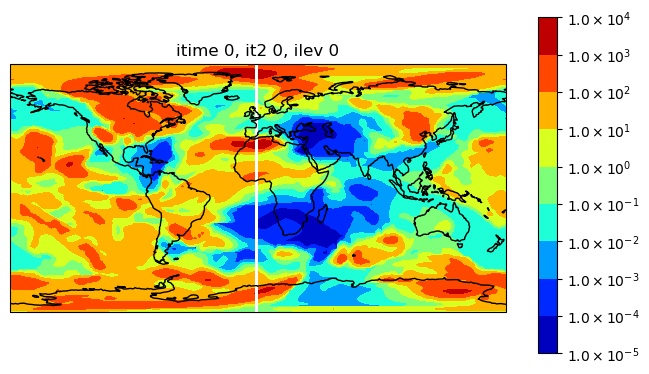

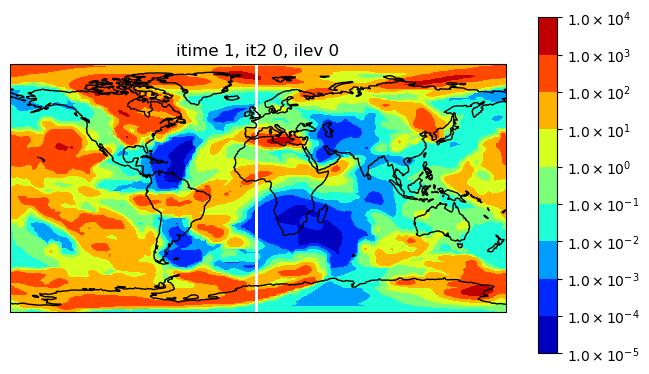

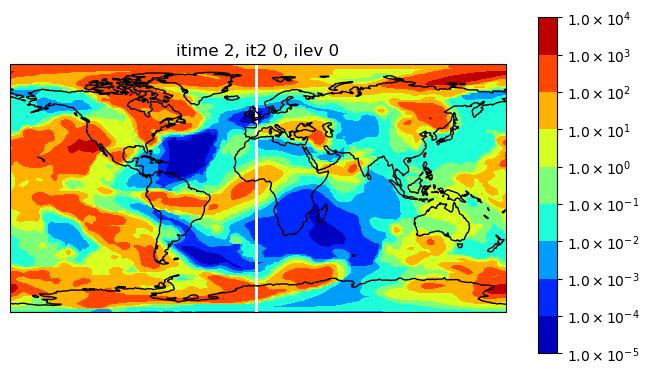

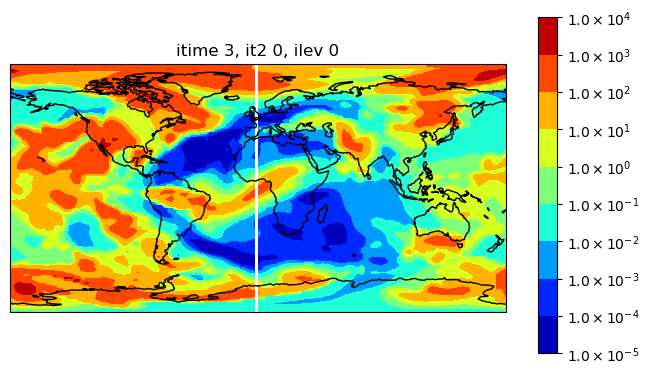

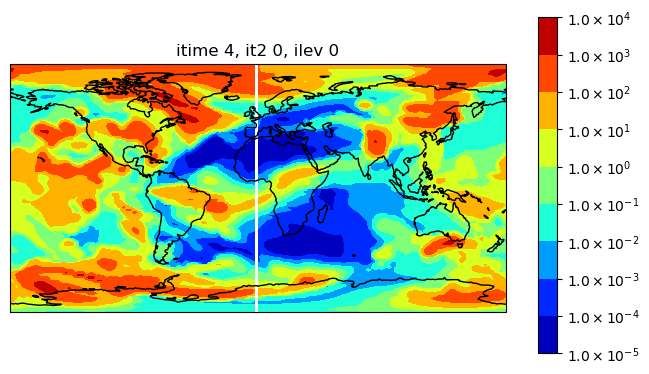

...

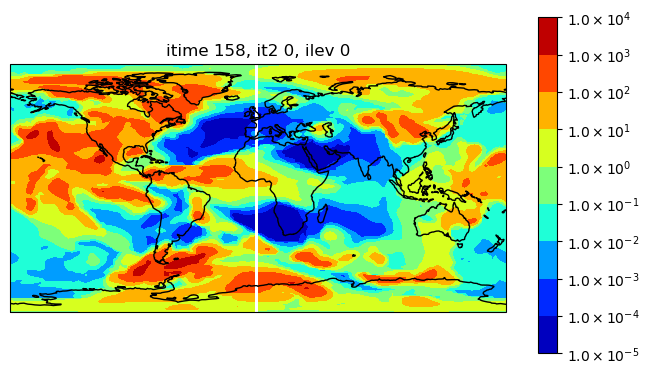

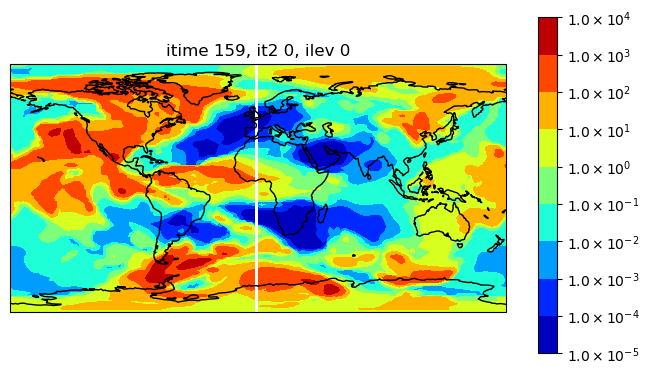

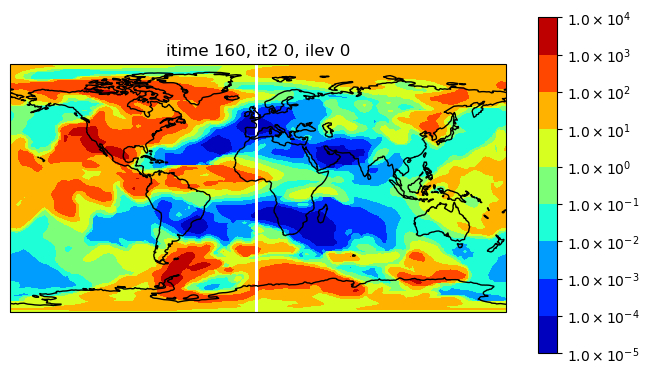

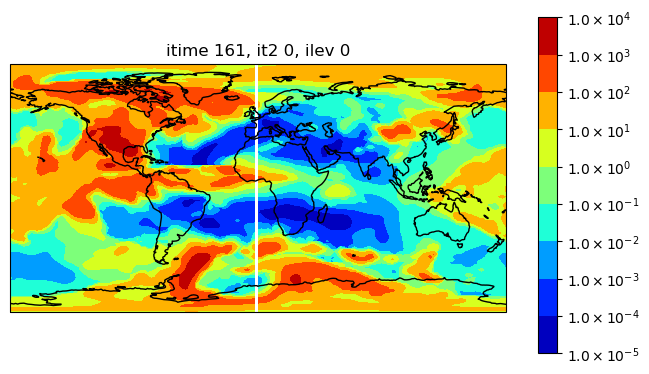

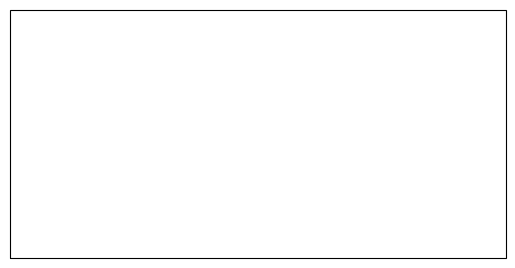

In [42]:
#Mptdens #(25, 336, 96, 144)
#Mptdens_sh #(25, 336, 96, 144, 2, 1)
  
#timee
#times

for ilev in levar:
    for itime in timear:


        fig = plt.figure()
        ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0))
        ax.set_global()

        C = plt.contourf(lon, lat, Mptdens_sh[ilev,itime,:,:, 0, 0], 
                         cmap=jet, locator=ticker.LogLocator(),
                         transform=ccrs.PlateCarree())
        ax.coastlines()

        def fmt(x, pos):
            a, b = '{:.1e}'.format(x).split('e')
            b = int(b)
            return r'${} \times 10^{{{}}}$'.format(a, b)

        cbar_ax = fig.add_axes([0.95, 0.15, 0.03, 0.7])  # Adjust these values to position and size the colorbar # [x, y, width, height]
        cbar = plt.colorbar(C, cax=cbar_ax, pad=0.07,format=ticker.FuncFormatter(fmt))
        figname = 'itime ' + str(itime) + ', it2 ' + str(it2) + ', ilev ' + str(ilev)
        ax.set_title(figname)
        plt.savefig('./Figures/' + run_name +'/Oc_fr/' + 'Apr_Test/'+str(figname), dpi = 400, bbox_inches='tight') 



In [44]:
print(ilev) #0
print(itime) #162


0
162


In [69]:
testerr = np.isinf(Mptdens_sh[:,162:335,:,:, 0, 0]).sum()
testerr #6,220,800
#print(Mptdens[0,162,:,:])#

6220800

In [119]:
Mptdens_sh.shape #(25, 336, 96, 144, 2, 1)
np.size(Mptdens_sh[:,162:335,:,:, 0, 0])  #59,788,800


Mptdens_sh[:,162,:,:, 0, 0]

Mptdens[:,180,:,:]


# times[162] #cftime.DatetimeNoLeap(1, 4, 7, 18, 0, 0, 0, has_year_zero=True)    #So, between 11th April at 18:00 to 8th April at 11:00
# times[179] #cftime.DatetimeNoLeap(1, 4, 8, 11, 0, 0, 0, has_year_zero=True)
# times

<xarray.Variable (lev: 25, lat: 96, lon: 144)>
array([[[1.44060808e-01, 1.44060792e-01, 1.44060792e-01, ...,
         1.44060792e-01, 1.44060808e-01, 1.44060808e-01],
        [3.93797519e+00, 3.56253270e+00, 3.49024749e+00, ...,
         3.10895527e+00, 3.23551938e+00, 3.47767384e+00],
        [1.38741031e+00, 1.49331518e+00, 1.62420217e+00, ...,
         1.14903758e+00, 1.21297789e+00, 1.30156970e+00],
        ...,
        [1.12241486e+01, 9.37342464e+00, 7.24659563e+00, ...,
         1.39528540e+01, 1.31784998e+01, 1.24026267e+01],
        [1.07862587e+01, 1.02455678e+01, 9.81283099e+00, ...,
         1.24652480e+01, 1.19223705e+01, 1.13818110e+01],
        [9.46398943e-01, 9.46398943e-01, 9.46398943e-01, ...,
         9.46398943e-01, 9.46398943e-01, 9.46398943e-01]],

       [[1.40276902e-01, 1.40276880e-01, 1.40276880e-01, ...,
         1.40276880e-01, 1.40276891e-01, 1.40276891e-01],
        [9.00267566e-01, 8.72397726e-01, 8.75570223e-01, ...,
         8.89197556e-01, 8.79351419e-01, 8.78281388e-01],
        [1.29671958e+00, 1.35174954e+00, 1.41489389e+00, ...,
         1.13382681e+00, 1.18074900e+00, 1.24210913e+00],
...
        [1.39320269e+02, 1.35992580e+02, 1.32992272e+02, ...,
         1.49596712e+02, 1.46365025e+02, 1.42843229e+02],
        [1.24517992e+02, 1.23434974e+02, 1.22329068e+02, ...,
         1.27215214e+02, 1.26453304e+02, 1.25538796e+02],
        [1.06326164e+01, 1.06326164e+01, 1.06326164e+01, ...,
         1.06326164e+01, 1.06326164e+01, 1.06326164e+01]],

       [[2.43347828e+00, 2.43347828e+00, 2.43347828e+00, ...,
         2.43347828e+00, 2.43347828e+00, 2.43347828e+00],
        [3.33998257e-01, 3.28518839e-01, 3.31072828e-01, ...,
         4.13103947e-01, 3.76811456e-01, 3.50516175e-01],
        [6.17332708e-02, 6.03975571e-02, 6.12847625e-02, ...,
         8.93333960e-02, 7.44618743e-02, 6.56410943e-02],
        ...,
        [2.49536097e+01, 2.64018454e+01, 2.76983885e+01, ...,
         2.04528811e+01, 2.18598221e+01, 2.34045566e+01],
        [1.20986550e+01, 1.23158637e+01, 1.25248827e+01, ...,
         1.14333848e+01, 1.16547882e+01, 1.18777223e+01],
        [2.56263555e+00, 2.56263555e+00, 2.56263555e+00, ...,
         2.56263555e+00, 2.56263555e+00, 2.56263555e+00]]])

In [ ]:
### TESTING ###

In [2]:

#---------------------------------------------------------------------------------------------
#                            P L O T T I N G 
#---------------------------------------------------------------------------------------------


Text(0, 0.5, 'Occurence Frequency (%)')

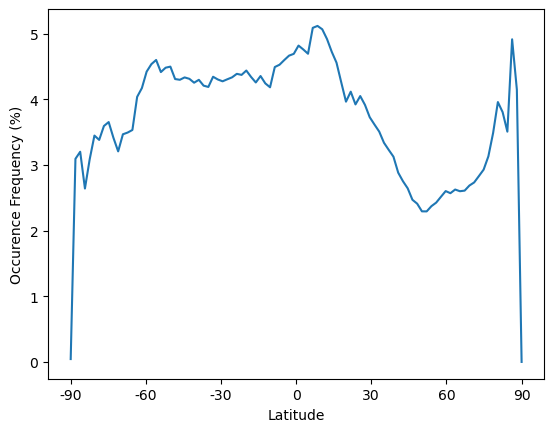

In [24]:
#Occ freq (lat, LT) averaged over LT -> Occ freq as fct of lat only

# SpEs_Occ_Fr_b_dsavglevLT = np.mean(SpEs_Occ_Fr_b_dsavglev, axis=1)
# #SpEs_Occ_Fr_b_dsavglevLT.shape

fig = plt.figure()
ax = plt.axes()

ax.plot(lat, SpEs_Occ_Fr_b_dsavglevLT)

ax.set_xlabel('Latitude')
ax.set_xticks(np.linspace(-90,90, 7)) 
ax.set_xticklabels((-90,-60,-30,0,30,60,90)) 

ax.set_ylabel('Occurence Frequency (%)')

#str(Monthfolderstr)

'Dec-Feb'

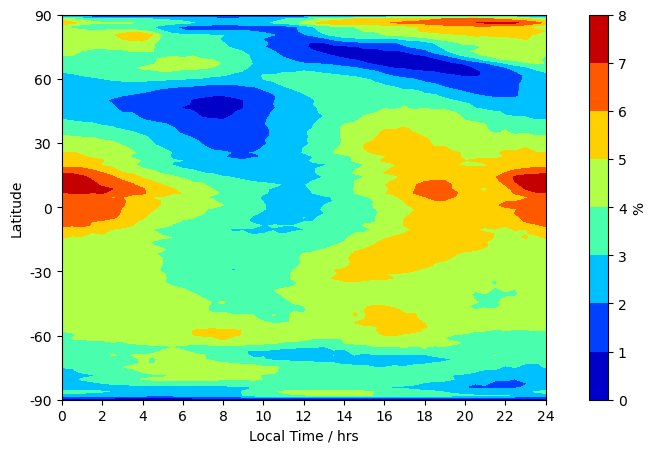

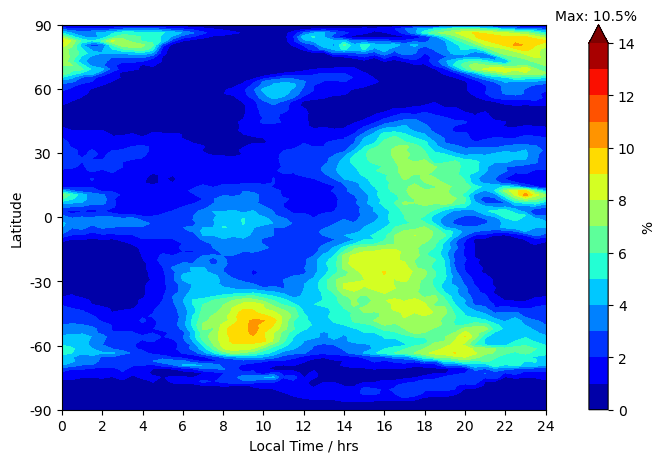

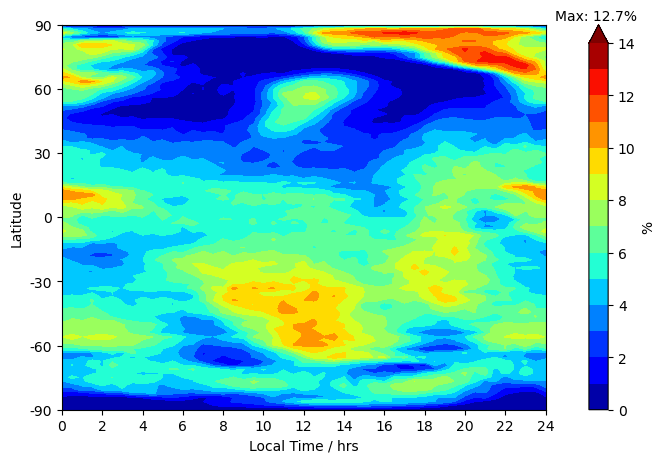

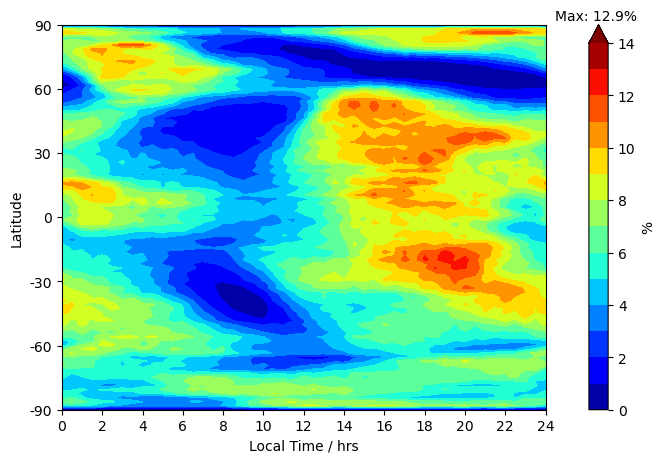

In [199]:
#SpEs Occ Freq plots - 
### Lat - Local Time at specific alt ###
### Dataset average ###
#-------------------------------------------------------------------------
# Set chosen/multiple levs to plot for lat-LT at a specific alt
lev_sl_idx_plot_multi = np.array([4,8,14],dtype=int)  #[ 4,  8, 14]  ~114km,~105km,95km
lev_sl_idx_plot_multi_shape = len(lev_sl_idx_plot_multi)  #3
lev_plot_ar = np.arange(0,lev_sl_idx_plot_multi_shape)   #[0,1,2]`

# #-------------------------------------------------------------------------
# lev_sl_idx_plot_min = 0

# lev_sl_idx_plot_max = 24
# #print('      Plot Lev = ' + str("%.1e" % lev_sl[lev_sl_idx_plot_max]) + ' hPa' + ' : ' + str("%.1e" % lev_sl[lev_sl_idx_plot_min]) + ' hPa')
# #print('      Approx Z = ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_max]) + ' km' + ' : ' + str("%.0f" %  Zavg_sl[lev_sl_idx_plot_min]) + ' km')

# Zavg_sl_plott = Zavg_sl[lev_sl_idx_plot_min:lev_sl_idx_plot_max+1]
# Zavg_sl_plott = Zavg_sl_plott.to_numpy()
# #Zavg_sl_plottt = np.round_(Zavg_sl_plott, decimals=0)


# Zavg_sl_plot_min = Zavg_sl_plott[0]
# Zavg_sl_plot_max = Zavg_sl_plott[-1]

#-------------------Set up Local Time Ticks-------------------------------
#timeconv = lon / 15
#timeconv_plot = timeconv.to_numpy() 
timeplot = np.linspace(0, 24, 49)
timeconv_plot_ticks = np.arange(0,25, dtype=float)

#-------------------------------------------------------------------------




if ds_months_shape>1:

    #--------------------Dataset avg over all heights (lat, LT)-----------------------------------------
    #-----------------------------------Lat-LT----------------------------------------------------------
    #---------------------------------------------------------------------
    SpEs_Occ_Fr_b_dsavglev_plot = SpEs_Occ_Fr_b_dsavglev[:,:]  #Whole Dataset avg over all heights ->(96, 48) lat,LT
    SpEs_Occ_Fr_b_dsavglev_plote = np.concatenate((SpEs_Occ_Fr_b_dsavglev_plot, SpEs_Occ_Fr_b_dsavglev_plot[:, :1]), axis=1)
    
    #-----------------------------------------------------

    #ticks = np.linspace(0, 8, 17)
    #ticks = np.linspace(0, 40, 21) #(F)
    vmin = 0
    vmax = 8

    
    fig, ax = plt.subplots(figsize=(8, 5))

    C = ax.contourf(timeplot, lat, SpEs_Occ_Fr_b_dsavglev_plote,

                     #levels=ticks,
                     #locator=ticker.LogLocator(),
                     #extend='min',
                     cmap=jet,
                     levels=np.linspace(vmin, vmax, 9), vmin=vmin, vmax=vmax
                     )
                     

    ax.set_ylabel('Latitude')
    ax.set_yticks(np.linspace(-90,90, 7)) 
    ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

    ax.set_xlabel('Local Time / hrs')
    
    xticks = np.linspace(0,24,13)
    #xticks = np.arange(0, 24.5, 0.5)
    ax.set_xticks(xticks) 
    ax.set_xticklabels(xticks.astype(int))
    
    #ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_b_dsavglev_plot, Lat vs LT, ' + ' \n UT ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] ) 
    
    #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
    #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

    # #------------------
    # def fmt(x, pos):
    #     a, b = '{:.1e}'.format(x).split('e')
    #     b = int(b)
    #     return r'${} \times 10^{{{}}}$'.format(a, b)

    cbar = fig.colorbar(C, pad=0.07)#,ticks=ticks[::2])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
    #-------------------

    cbar.set_label(r'%')

    figname= Crit_name +' '+ 'SpEs_Occ_Fr_b_dsavglev_plot: Lat vs LT, ' + ' ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] + '.png'


    #plt.tight_layout()
    plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr+  '/Lat-LT/'+str(figname), dpi = 400, bbox_inches='tight') #
    #---------------------------------------------------------------------------------------------------

    
    
 
    
#for ids in ds_months_ar:   #iterate over month    
    
for iplev in lev_plot_ar:   #iterate over multiple levels for lat-LT plots at a specific alt
    #-----------------------------------Lat-LT plot setup ----------------------------------------
    #print('Lat-LT plot setup:')
    lev_sl_idx_plot = lev_sl_idx_plot_multi[iplev]    #14 4.9e-04hPa~95km  #8 1.1e-04hPa~105km  #4 4.0e-05 hPa~114km

    lev_sl_plot = lev_sl[lev_sl_idx_plot]
    lev_sl_plot_str = str("%.1e" % lev_sl_plot) + ' hPa'
    #print('      Plot Lev = ' + lev_sl_plot_str )

    Zavg_sl_plot = Zavg_sl[lev_sl_idx_plot]
    Zavg_sl_plot_str = str("%.0f" % Zavg_sl_plot) + ' km'
    #print('      Approx Z = ' + Zavg_sl_plot_str )
    #===================================================================================================================================================


    if ds_months_shape>1:

        #--------------------------Dataset avg (lev, lat, LT)-----------------------------------------------
        #-----------------------------------Lat-LT at specific height----------------------------------------------------------
        #---------------------------------------------------------------------

        SpEs_Occ_Fr_b_dsavg_plot = SpEs_Occ_Fr_b_dsavg[lev_sl_idx_plot,:,:]    # =Whole Dataset avg   ->(25, 96, 48)  lev, lat, LT
        SpEs_Occ_Fr_b_dsavg_plote = np.concatenate((SpEs_Occ_Fr_b_dsavg_plot, SpEs_Occ_Fr_b_dsavg_plot[:, :1]), axis=1)
        
        #-----------------------------------------------------

        #ticks = np.linspace(0, 8, 17)
        #ticks = np.linspace(0, 40, 21) #(F)
        vmin = 0
        vmax = 14
        
        fig, ax = plt.subplots(figsize=(8, 5))

        C = ax.contourf(timeplot, lat, SpEs_Occ_Fr_b_dsavg_plote,                 
                         #levels=ticks,
                         #locator=ticker.LogLocator(),
                         extend='max',
                         cmap=jet,
                         levels=np.linspace(vmin, vmax, 15), vmin=vmin, vmax=vmax
                         )

        ax.set_ylabel('Latitude')
        ax.set_yticks(np.linspace(-90,90, 7)) 
        ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

        ax.set_xlabel('Local Time / hrs')

        xticks = np.linspace(0,24,13)    
        ax.set_xticks(xticks) 
        ax.set_xticklabels(xticks.astype(int))
         
        #ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_b_dsavg_plot, Lat vs LT, ' + lev_sl_plot_str + ' \n UT ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] ) 
        #ax.set_title(Zavg_sl_plot_str)
        
        #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
        #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

        #------------------
        def fmt(x, pos):
            a, b = '{:.1e}'.format(x).split('e')
            b = int(b)
            return r'${} \times 10^{{{}}}$'.format(a, b)

        cbar = fig.colorbar(C, pad=0.07)#,ticks=ticks[::2])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
        #-------------------

        cbar.set_label(r'%')

        # Calculate the actual maximum value in your data
        actual_max_value = np.max(SpEs_Occ_Fr_b_dsavg_plote)

        # Add a text annotation to display the actual maximum value
        ax.text(1.02, 1.04, f"Max: {actual_max_value:.1f}%", transform=ax.transAxes, ha='left', va='top', backgroundcolor='white')

        
        figname= Crit_name +' '+ 'SpEs_Occ_Fr_b_dsavg_plot: Lat vs LT, ' + lev_sl_plot_str + ' ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] + '.png'

        #plt.tight_layout()
        plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr +  '/Lat-LT/'+str(figname), dpi = 400, bbox_inches='tight') #
        #---------------------------------------------------------------------------------------------------



Plot month 0: 12
Plot month 1: 01
Plot month 2: 02


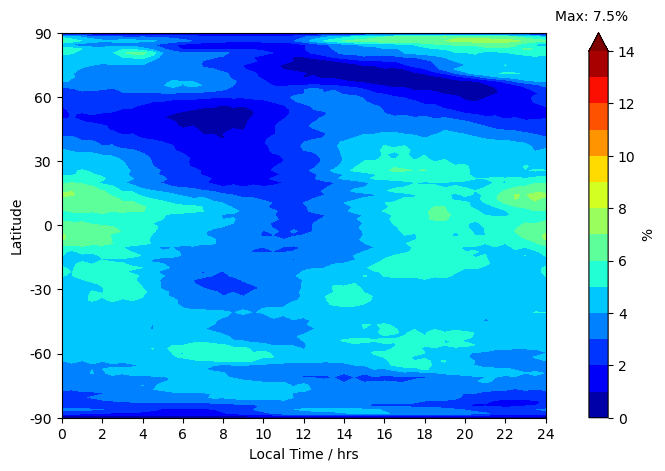

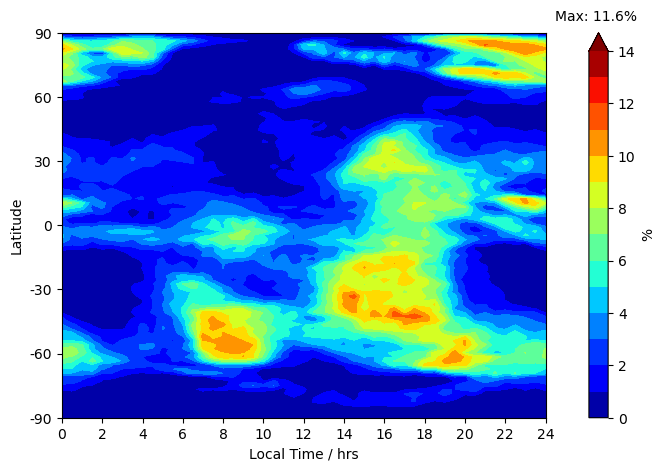

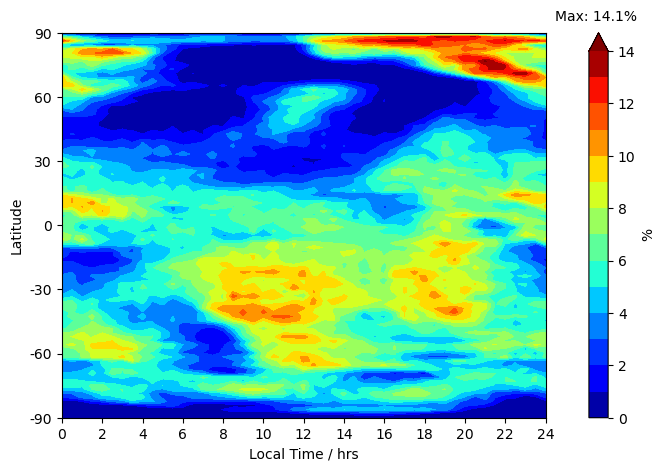

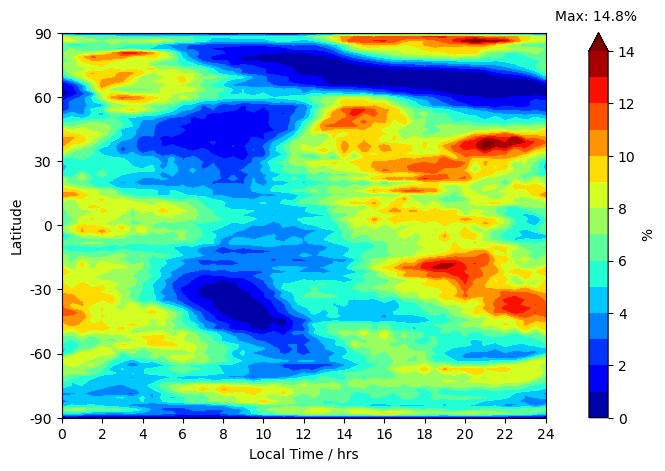

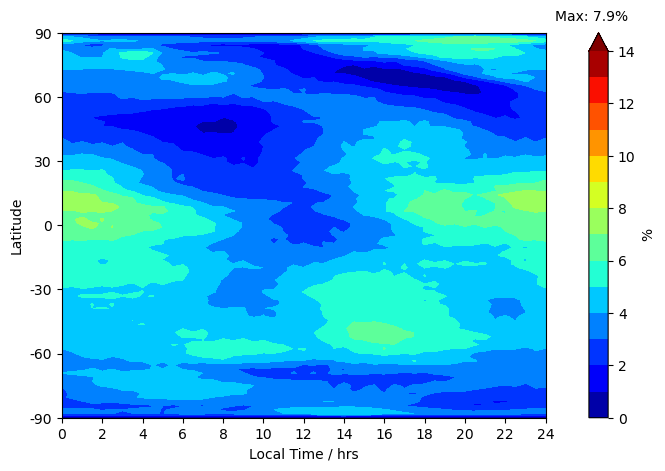

...

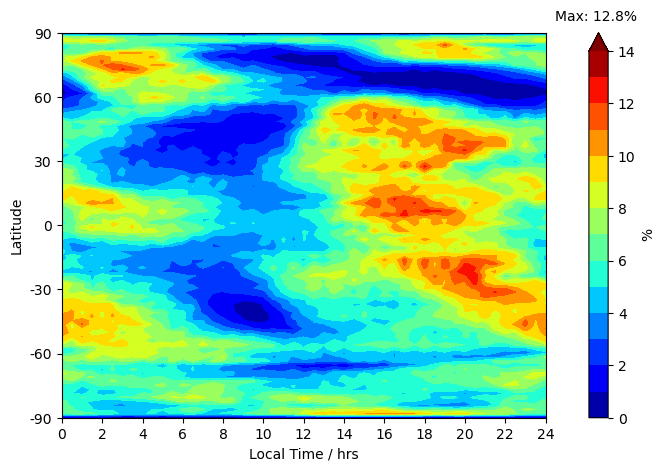

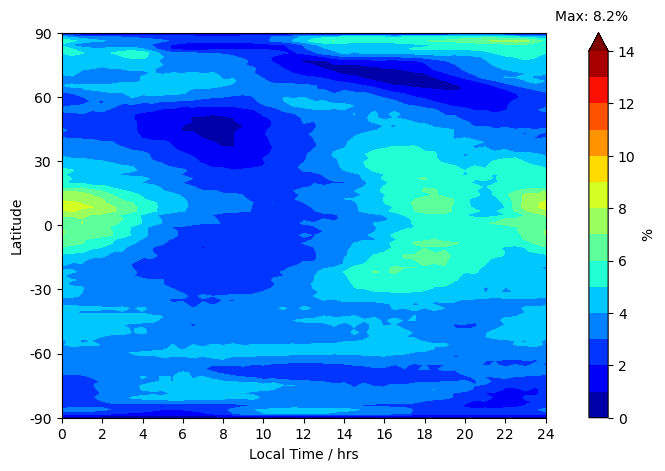

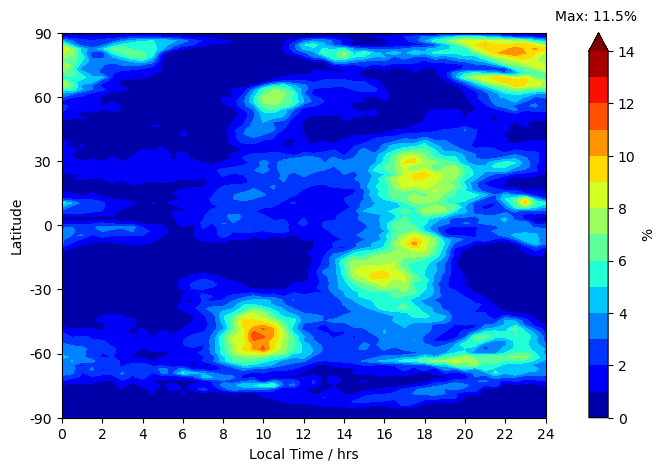

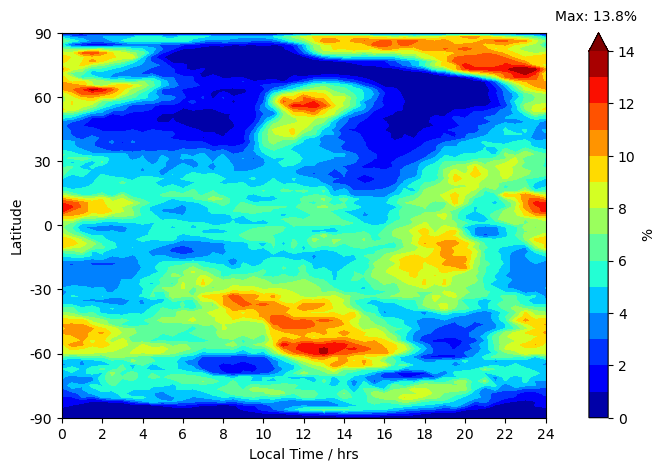

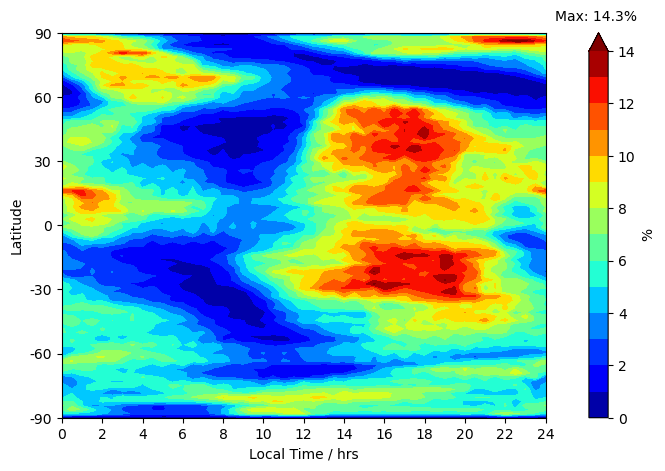

In [200]:
#SpEs Occ Freq plots - 
### Lat - Local Time ###
### Monthly average ###
#-------------------------------------------------------------------------

# Set chosen/multiple levs to plot for lat-LT at a specific alt
lev_sl_idx_plot_multi = np.array([4,8,14],dtype=int)  #[ 4,  8, 14]  ~114km,~105km,95km
lev_sl_idx_plot_multi_shape = len(lev_sl_idx_plot_multi)  #3
lev_plot_ar = np.arange(0,lev_sl_idx_plot_multi_shape)   #[0,1,2]`

#-------------------------------------------------------------------------
lev_sl_idx_plot_min = 0
lev_sl_idx_plot_max = 24
#print('      Plot Lev = ' + str("%.1e" % lev_sl[lev_sl_idx_plot_max]) + ' hPa' + ' : ' + str("%.1e" % lev_sl[lev_sl_idx_plot_min]) + ' hPa')
#print('      Approx Z = ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_max]) + ' km' + ' : ' + str("%.0f" %  Zavg_sl[lev_sl_idx_plot_min]) + ' km')

Zavg_sl_plott = Zavg_sl[lev_sl_idx_plot_min:lev_sl_idx_plot_max+1]
Zavg_sl_plott = Zavg_sl_plott.to_numpy()
#Zavg_sl_plottt = np.round_(Zavg_sl_plott, decimals=0)


Zavg_sl_plot_min = Zavg_sl_plott[0]
Zavg_sl_plot_max = Zavg_sl_plott[-1]

#-------------------Set up Local Time Ticks-------------------------------
# timeconv = lon / 15
# timeconv_plot = timeconv.to_numpy() 
timeplot = np.linspace(0, 24, 49)
timeconv_plot_ticks = np.arange(0,25, dtype=float)
#-------------------------------------------------------------------------

    
    
    

for ids in ds_months_ar:   #iterate over month
    #--------------Set value for ids for plot variables-----------------------
    ids_plot = ids
    str_ids_plot = str(ids_plot)
    print('Plot month ' + str_ids_plot + ': ' + str(ds_months[ids_plot]) )
    
    
    #-------------------Monthly avg over all heights (lat, LT, ids)-------------------------------------
    #-----------------------------------Lat-LT----------------------------------------------------------
    #---------------------------------------------------------------------

    SpEs_Occ_Fr_b_avglev_plot = SpEs_Occ_Fr_b_avglev[:,:,ids_plot]  # =Monthly avg over all heights   ->(96, 48, 3)   lat, LT,month 
    SpEs_Occ_Fr_b_avglev_plote = np.concatenate((SpEs_Occ_Fr_b_avglev_plot, SpEs_Occ_Fr_b_avglev_plot[:, :1]), axis=1)
    
    #-----------------------------------------------------

    #ticks = np.linspace(0, 8, 17)
    #ticks = np.linspace(0, 40, 21) #(F)
    vmin = 0
    vmax = 14
        
    fig, ax = plt.subplots(figsize=(8, 5))

    C = ax.contourf(timeplot, lat, SpEs_Occ_Fr_b_avglev_plote, 
                     #levels=ticks,
                     #locator=ticker.LogLocator(),
                     extend='max',
                     cmap=jet,
                     levels=np.linspace(vmin, vmax, 15), vmin=vmin, vmax=vmax
                     )

    ax.set_ylabel('Latitude')
    ax.set_yticks(np.linspace(-90,90, 7)) 
    ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

    ax.set_xlabel('Local Time / hrs')
    xticks = np.linspace(0,24,13) 
    ax.set_xticks(xticks) 
    ax.set_xticklabels(xticks.astype(int))
    
    # if ds_months_shape>1:
    #     ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_b_avglev_plot, Lat vs LT, ' + ' \n UT ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] ) 
    # else:
    #     ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_b_avglev_plot, Lat vs LT, ' + ' \n UT ' + times_str_min[0] + ' : ' + times_str_max[-1] )

    #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
    #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

    #------------------
    # def fmt(x, pos):
    #     a, b = '{:.1e}'.format(x).split('e')
    #     b = int(b)
    #     return r'${} \times 10^{{{}}}$'.format(a, b)

    cbar = fig.colorbar(C, pad=0.07)#,ticks=ticks[::2])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
    #-------------------

    cbar.set_label(r'%')

    # Calculate the actual maximum value in your data
    actual_max_value = np.max(SpEs_Occ_Fr_b_avglev_plote)

    # Add a text annotation to display the actual maximum value
    ax.text(1.02, 1.06, f"Max: {actual_max_value:.1f}%", transform=ax.transAxes, ha='left', va='top', backgroundcolor='white')

    
    if ds_months_shape>1:
        figname= Crit_name +' '+ 'SpEs_Occ_Fr_b_avglev_plot: Lat vs LT, ' + ' ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] + '.png'
    else:
        figname= Crit_name +' '+ 'SpEs_Occ_Fr_b_avglev_plot: Lat vs LT, ' + ' ' + times_str_min[0] + ' : ' + times_str_max[-1] + '.png'

    #plt.tight_layout()
    plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr +  '/Lat-LT/'+str(figname), dpi = 400, bbox_inches='tight') #
    #---------------------------------------------------------------------------------------------------    
    
    
    
    
    
    for iplev in lev_plot_ar:   #iterate over multiple levels for lat-LT plots at a specific alt
        #-----------------------------------Lat-LT plot setup ----------------------------------------
        #print('Lat-LT plot setup:')
        lev_sl_idx_plot = lev_sl_idx_plot_multi[iplev]    #14 4.9e-04hPa~95km  #8 1.1e-04hPa~105km  #4 4.0e-05 hPa~114km

        lev_sl_plot = lev_sl[lev_sl_idx_plot]
        lev_sl_plot_str = str("%.1e" % lev_sl_plot) + ' hPa'
        #print('      Plot Lev = ' + lev_sl_plot_str )

        Zavg_sl_plot = Zavg_sl[lev_sl_idx_plot]
        Zavg_sl_plot_str = str("%.0f" % Zavg_sl_plot) + ' km'
        #print('      Approx Z = ' + Zavg_sl_plot_str )
        #===================================================================================================================================================

        
        #----------------------Monthly avg (lev, lat, LT, ids)----------------------------------------------
        #-----------------------------------Lat-LT----------------------------------------------------------
        #---------------------------------------------------------------------

        SpEs_Occ_Fr_b_avg_plot = SpEs_Occ_Fr_b_avg[lev_sl_idx_plot,:,:,ids_plot]   # =Monthly avg   ->(25, 96, 48, 3)    lev, lat, LT, month
        SpEs_Occ_Fr_b_avg_plote = np.concatenate((SpEs_Occ_Fr_b_avg_plot, SpEs_Occ_Fr_b_avg_plot[:, :1]), axis=1)
        
        #-----------------------------------------------------

        #ticks = np.linspace(0, 8, 17)
        #ticks = np.linspace(0, 40, 21) #(F)
        vmin = 0
        vmax = 14
        
        fig, ax = plt.subplots(figsize=(8, 5))

        C = ax.contourf(timeplot, lat, SpEs_Occ_Fr_b_avg_plote,                 
                         #levels=ticks,
                         #locator=ticker.LogLocator(),
                         extend='max',
                         cmap=jet,
                         levels=np.linspace(vmin, vmax, 15), vmin=vmin, vmax=vmax
                         )

        ax.set_ylabel('Latitude')
        ax.set_yticks(np.linspace(-90,90, 7)) 
        ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

        ax.set_xlabel('Local Time / hrs')
        xticks = np.linspace(0,24,13) 
        ax.set_xticks(xticks) 
        ax.set_xticklabels(xticks.astype(int))
        

#         if ds_months_shape>1:
#             ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_b_avg_plot, Lat vs LT, ' + lev_sl_plot_str + ' \n UT ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] ) 
#         else:
#             ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_b_avg_plot, Lat vs LT, ' + lev_sl_plot_str + ' \n UT ' + times_str_min[0] + ' : ' + times_str_max[-1] ) 
        
        #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
        #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

        #------------------
        def fmt(x, pos):
            a, b = '{:.1e}'.format(x).split('e')
            b = int(b)
            return r'${} \times 10^{{{}}}$'.format(a, b)

        cbar = fig.colorbar(C, pad=0.07)#,ticks=ticks[::2])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
        #-------------------

        cbar.set_label(r'%')

        # Calculate the actual maximum value in your data
        actual_max_value = np.max(SpEs_Occ_Fr_b_avg_plote)

        # Add a text annotation to display the actual maximum value
        ax.text(1.02, 1.06, f"Max: {actual_max_value:.1f}%", transform=ax.transAxes, ha='left', va='top', backgroundcolor='white')


        if ds_months_shape>1:
            figname= Crit_name +' '+ 'SpEs_Occ_Fr_b_avg_plot: Lat vs LT, ' + lev_sl_plot_str + ' ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] + '.png'
        else:
            figname= Crit_name +' '+ 'SpEs_Occ_Fr_b_avg_plot: Lat vs LT, ' + lev_sl_plot_str + ' ' + times_str_min[0] + ' : ' + times_str_max[-1] + '.png'

        #plt.tight_layout()
        plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr +  '/Lat-LT/'+str(figname), dpi = 400, bbox_inches='tight') #
        #---------------------------------------------------------------------------------------------------
    
        


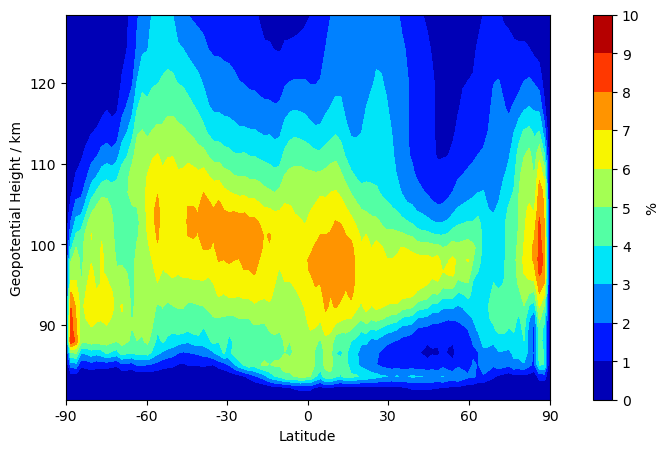

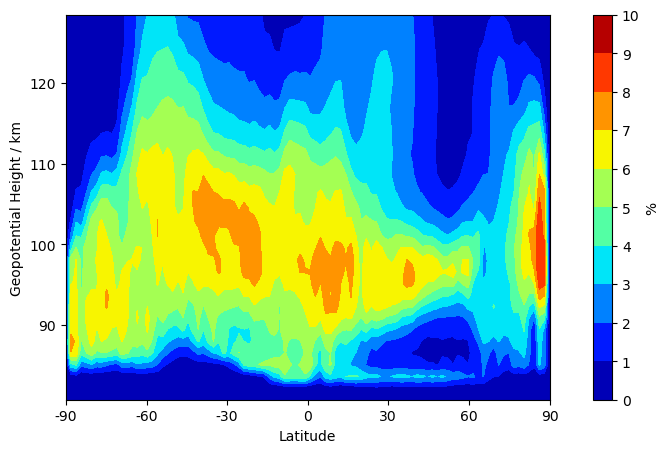

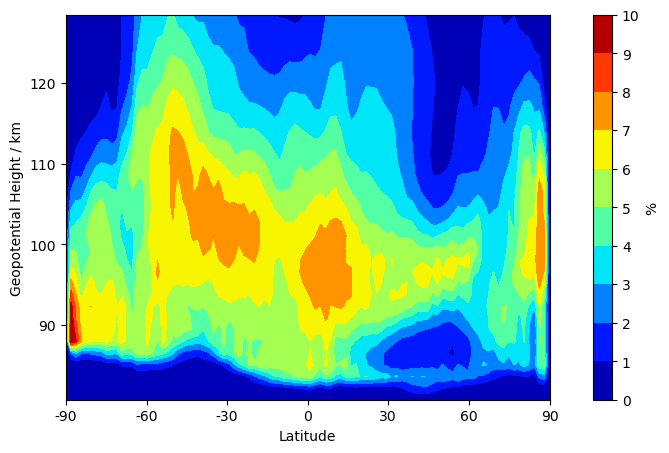

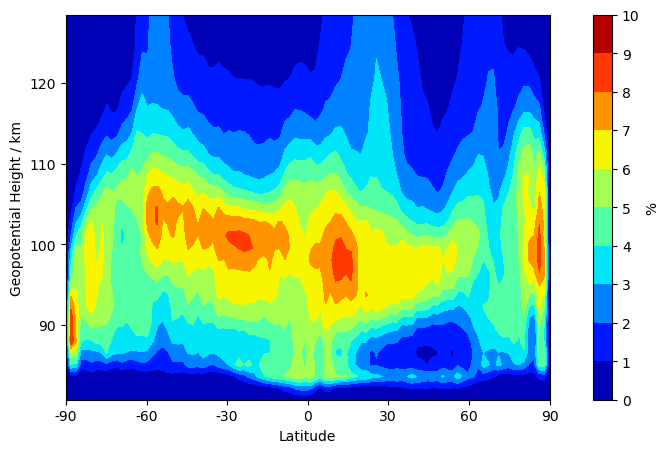

In [201]:
#SpEs Occ Freq plots - 
### Lev-Lat ###
### Dataset average ###
#-------------------------------------------------------------------------

lev_sl_idx_plot_min = 0
lev_sl_idx_plot_max = 24
#print('      Plot Lev = ' + str("%.1e" % lev_sl[lev_sl_idx_plot_max]) + ' hPa' + ' : ' + str("%.1e" % lev_sl[lev_sl_idx_plot_min]) + ' hPa')
#print('      Approx Z = ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_max]) + ' km' + ' : ' + str("%.0f" %  Zavg_sl[lev_sl_idx_plot_min]) + ' km')

Zavg_sl_plott = Zavg_sl[lev_sl_idx_plot_min:lev_sl_idx_plot_max+1]
Zavg_sl_plott = Zavg_sl_plott.to_numpy()
#Zavg_sl_plottt = np.round_(Zavg_sl_plott, decimals=0)


Zavg_sl_plot_min = Zavg_sl_plott[0]
Zavg_sl_plot_max = Zavg_sl_plott[-1]



if ds_months_shape>1:

    
    #*#*#*
    #-------------------Dataset avg over all LTs (Lev, lat)-------------------------------------
    #-----------------------------------Lev-Lat---------------------------------------------------------
    #---------------------------------------------------------------------

    #SpEs_Occ_Fr_b_dsavgLT_plot = SpEs_Occ_Fr_b_dsavgLT[:,:]  # =ds avg over all LTs   ->(25, 96   lev,lat,

    #-----------------------------------------------------

    #ticks = np.linspace(0, 10, 11)
    num_ticks = 11
    ticks = np.arange(num_ticks)

    fig, ax = plt.subplots(figsize=(8, 5))

    vmin = 0
    vmax = 10
    
    C = ax.contourf(lat, Zavg_sl, SpEs_Occ_Fr_b_dsavgLT, 
                    #levels=ticks,
                     #locator=ticker.LogLocator(),
                     #extend='both',
                     cmap=jet,
                     levels=np.linspace(vmin, vmax, 11), vmin=vmin, vmax=vmax)

    ax.set_xlabel('Latitude')
    ax.set_xticks(np.linspace(-90,90, 7)) 
    ax.set_xticklabels((-90,-60,-30,0,30,60,90)) 
    
    ax.set_ylabel('Geopotential Height / km')
    ax.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
     

#     if ds_months_shape>1:
#         ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_b_avgLT_plot, Lev vs Lat, ' + ' \n UT ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] ) 
#     else:
#         ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_b_avgLT_plot, Lev vs Lat, ' + ' \n UT ' + times_str_min[0] + ' : ' + times_str_max[-1] )

    #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
    #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

    #------------------
    def fmt(x, pos):
        a, b = '{:.1e}'.format(x).split('e')
        b = int(b)
        return r'${} \times 10^{{{}}}$'.format(a, b)

    #cbar = fig.colorbar(C, pad=0.07,ticks=ticks)#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
    cbar = fig.colorbar(C, pad=0.07)
    cbar.set_ticks(ticks)
    cbar.set_ticklabels(ticks)
    #-------------------

    cbar.set_label(r'%')
    
    if ds_months_shape>1:
        figname= Crit_name +' '+ 'SpEs_Occ_Fr_b_dsavgLT_plot: Lev vs Lat, ' + ' ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] + '.png'
    else:
        figname= Crit_name +' '+ 'SpEs_Occ_Fr_b_dsavgLT_plot: Lev vs Lat, ' + ' ' + times_str_min[0] + ' : ' + times_str_max[-1] + '.png'

    #plt.tight_layout()
    plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr +  '/Lev-Lat/'+str(figname), dpi = 400, bbox_inches='tight') #
    #---------------------------------------------------------------------------------------------------

    
    
    

for ids in ds_months_ar:   #iterate over month
    #--------------Set value for ids for plot variables-----------------------
    ids_plot = ids
    str_ids_plot = str(ids_plot)
    #print('Plot month ' + str_ids_plot + ': ' + str(ds_months[ids_plot]) )
     
    
    #*#*#*
    #-------------------Monthly avg over all LTs (Lev, lat, ids)-------------------------------------
    #-----------------------------------Lev-Lat---------------------------------------------------------
    #---------------------------------------------------------------------

    SpEs_Occ_Fr_b_avgLT_plot = SpEs_Occ_Fr_b_avgLT[:,:,ids_plot]  # =ds avg over all LTs   ->(25, 96, 3)   lev,lat,month 

    #-----------------------------------------------------

    #ticks = np.linspace(0, 10, 11)
    num_ticks = 11
    ticks = np.arange(num_ticks)

    fig, ax = plt.subplots(figsize=(8, 5))

    vmin = 0
    vmax = 10
    
    C = ax.contourf(lat, Zavg_sl, SpEs_Occ_Fr_b_avgLT_plot, 
                    #levels=ticks,
                     #locator=ticker.LogLocator(),
                     #extend='both',
                     cmap=jet,
                     levels=np.linspace(vmin, vmax, 11), vmin=vmin, vmax=vmax)

    ax.set_xlabel('Latitude')
    ax.set_xticks(np.linspace(-90,90, 7)) 
    ax.set_xticklabels((-90,-60,-30,0,30,60,90)) 
    
    ax.set_ylabel('Geopotential Height / km')
    ax.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
     

#     if ds_months_shape>1:
#         ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_b_avgLT_plot, Lev vs Lat, ' + ' \n UT ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] ) 
#     else:
#         ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_b_avgLT_plot, Lev vs Lat, ' + ' \n UT ' + times_str_min[0] + ' : ' + times_str_max[-1] )

#     #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
    #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

    #------------------
    def fmt(x, pos):
        a, b = '{:.1e}'.format(x).split('e')
        b = int(b)
        return r'${} \times 10^{{{}}}$'.format(a, b)

    #cbar = fig.colorbar(C, pad=0.07,ticks=ticks)#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
    cbar = fig.colorbar(C, pad=0.07)
    cbar.set_ticks(ticks)
    cbar.set_ticklabels(ticks)
    #-------------------

    cbar.set_label(r'%')
    
    if ds_months_shape>1:
        figname= Crit_name +' '+ 'SpEs_Occ_Fr_b_avgLT_plot: Lev vs Lat, ' + ' ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] + '.png'
    else:
        figname= Crit_name +' '+ 'SpEs_Occ_Fr_b_avgLT_plot: Lev vs Lat, ' + ' ' + times_str_min[0] + ' : ' + times_str_max[-1] + '.png'

    #plt.tight_layout()
    plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr +  '/Lev-Lat/'+str(figname), dpi = 400, bbox_inches='tight') #
    #---------------------------------------------------------------------------------------------------
    
 

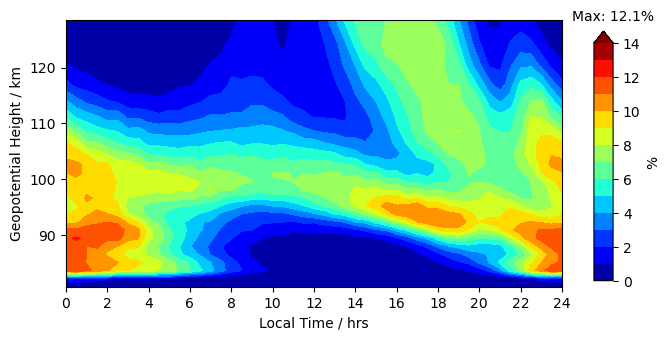

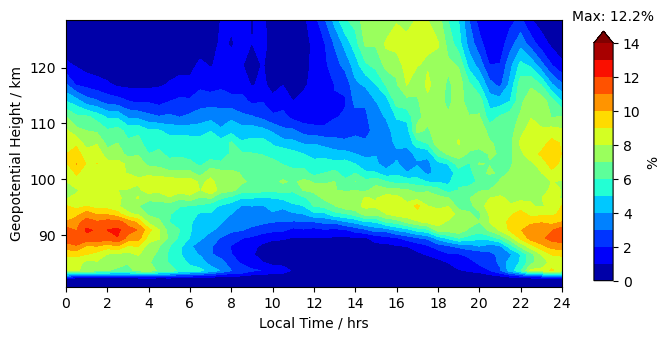

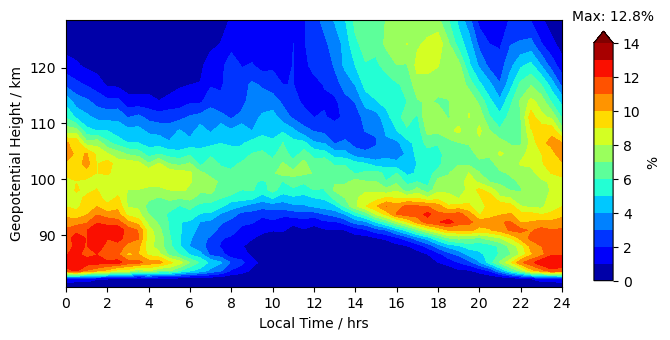

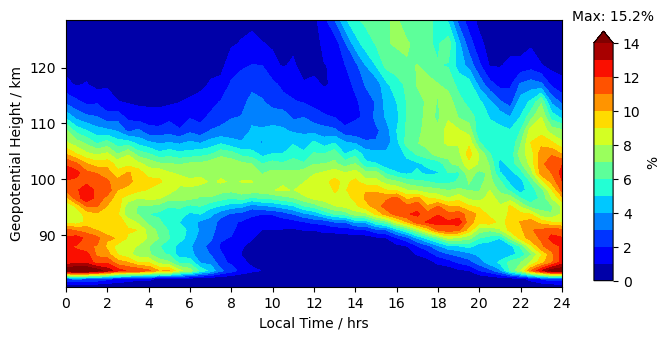

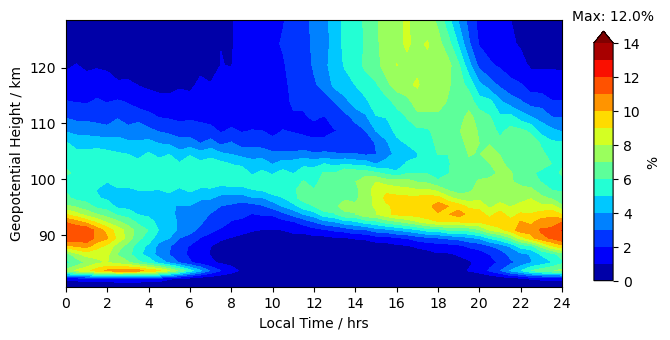

...

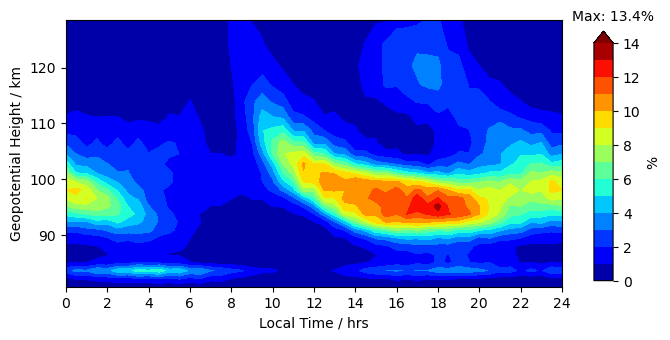

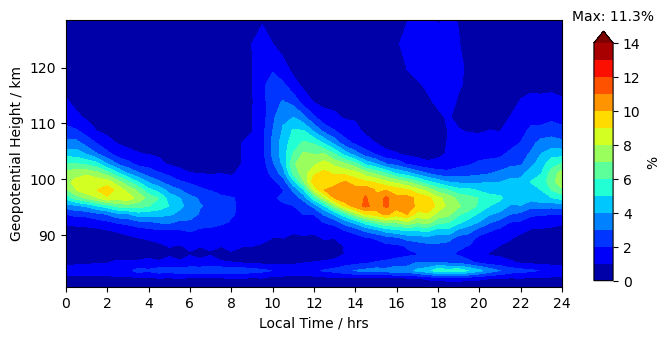

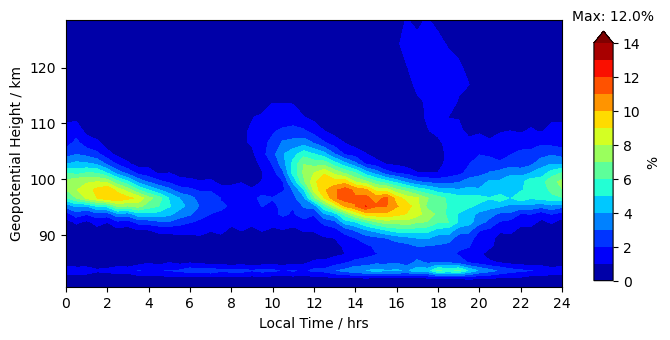

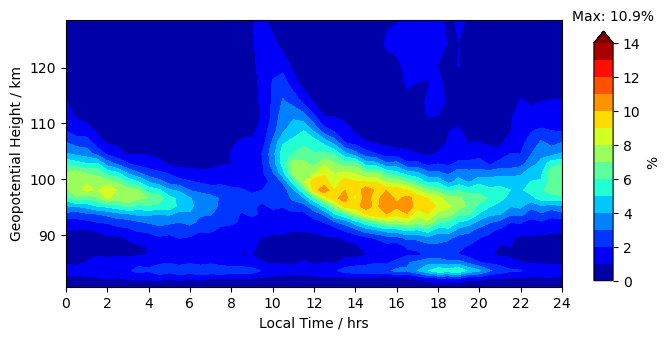

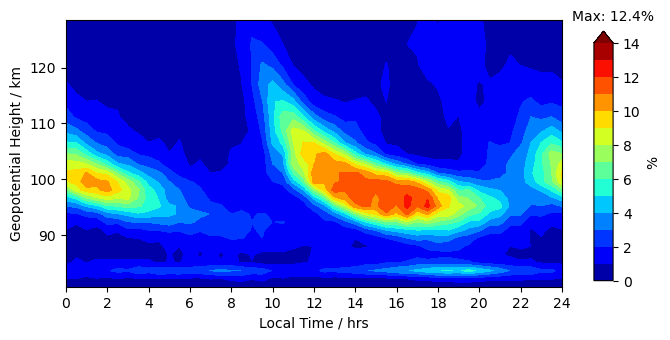

In [202]:
#SpEs Occ Freq plots
### Lev-LT ###
### Monthly and dataset average ###
#-------------------------------------------------------------------------

# Set chosen/multiple lat slices to plot
intlat_plot_idx_multi = np.array([20,22,24,26,28],dtype=int) #+ve lats 10-15', 20-25' --> 50-55'       #[7,9,11,13,15],dtype=int) #-ve lats 10-15', 20-25' --> 50-55'     
intlat_plot_idx_multi_shape = len(intlat_plot_idx_multi)  
intlat_plot_ar = np.arange(0,intlat_plot_idx_multi_shape) 


#---------------Set up lev/alt--------------------
lev_sl_idx_plot_min = 0
lev_sl_idx_plot_max = 24
#print('      Plot Lev = ' + str("%.1e" % lev_sl[lev_sl_idx_plot_max]) + ' hPa' + ' : ' + str("%.1e" % lev_sl[lev_sl_idx_plot_min]) + ' hPa')
#print('      Approx Z = ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_max]) + ' km' + ' : ' + str("%.0f" %  Zavg_sl[lev_sl_idx_plot_min]) + ' km')

Zavg_sl_plott = Zavg_sl[lev_sl_idx_plot_min:lev_sl_idx_plot_max+1]
Zavg_sl_plott = Zavg_sl_plott.to_numpy()
#Zavg_sl_plottt = np.round_(Zavg_sl_plott, decimals=0)

Zavg_sl_plot_min = Zavg_sl_plott[0]
Zavg_sl_plot_max = Zavg_sl_plott[-1]

#-------------------Set up Local Time Ticks-------------------------------
# timeconv = lon / 15
# timeconv_plot = timeconv.to_numpy() 
timeplot = np.linspace(0, 24, 49)
timeconv_plot_ticks = np.arange(0,25, dtype=float)



levLTticks = np.linspace(0, 16, 17)



for iintlatt in intlat_plot_ar:
    #print('Lev-LT plot setup (intlat):')
    intlat_plot_idx =  intlat_plot_idx_multi[iintlatt] 
    lat_plot_1 = intlat[intlat_plot_idx] -2.5
    lat_plot_2 = intlat[intlat_plot_idx] +2.5
    lat_plot_str1 = str("%.0f" % lat_plot_1) 
    lat_plot_str2 = str("%.0f" % lat_plot_2)
    #print('      Plot lat = ' + lat_plot_str1 + ':' + lat_plot_str2)





    if ds_months_shape>1:
        
        #--------------------------Dataset avg (lev, lat, LT, ids)------------------------------------------
        #-----------------------------------Lev-LT in specific lat band----------------------------------------------------------
        #------------------------data averaged in 5' lat slices---------------------------------------------

        SpEs_Occ_Fr_bb_5d_dsavg_plot2 = SpEs_Occ_Fr_bb_5d_dsavg[:,intlat_plot_idx,:]    # =Whole Dataset avg   ->(25, 36, 48)  lev, lat, LT
        SpEs_Occ_Fr_bb_5d_dsavg_plot2e = np.concatenate((SpEs_Occ_Fr_bb_5d_dsavg_plot2, SpEs_Occ_Fr_bb_5d_dsavg_plot2[:, :1]), axis=1)
        
        #-----------------------------------------------------

        #ticks = np.linspace(0, 14, 15)
        ticks = levLTticks
        #ticks = np.linspace(0, 16, 17)
        #ticks = np.linspace(0, 40, 21) #(F)
        vmin = 0
        vmax = 14
        
        fig, ax = plt.subplots()

        C = ax.contourf(timeplot, Zavg_sl, SpEs_Occ_Fr_bb_5d_dsavg_plot2e,   #lev_sl
                         #levels=ticks,
                         #locator=ticker.LogLocator(),
                         extend='max',
                         cmap=jet,
                         levels=np.linspace(vmin, vmax, 15), vmin=vmin, vmax=vmax
                         )
        
        aspect_ratio = 0.27  # Width / Height
        ax.set_aspect(aspect_ratio)
        
        #ax.set_yscale('log')
        #ax.set_ylabel('Pressure / HPa')
        #ax.set_ylim(lev_sl_plot_max, lev_sl_plot_min) 

        #ax2 = ax.twinx()
        #ax2.set_ylabel('Approx Geopotential Height / Km')
        #ax2.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
        #ax2.set_yticklabels(Zavg_sl_plottt[lev_sl_idx_plot_max:lev_sl_idx_plot_min:-5])

        ax.set_ylabel('Geopotential Height / km')
        ax.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)


        ax.set_xlabel('Local Time / hrs')
        xticks = np.linspace(0,24,13) 
        ax.set_xticks(xticks) 
        ax.set_xticklabels(xticks.astype(int))

        #ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_bb_5d_dsavg_plot2, Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ', \n UT ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] )

        #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
        #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

        cbar_ax = fig.add_axes([0.95, 0.23, 0.03, 0.52])  # Adjust these values to position and size the colorbar # [x, y, width, height]
        cbar = plt.colorbar(C, cax=cbar_ax)
        cbar.set_label(r'%')

        # Calculate the actual maximum value in your data
        actual_max_value = np.max(SpEs_Occ_Fr_bb_5d_dsavg_plot2e)

        # Add a text annotation to display the actual maximum value
        ax.text(1.02, 1.04, f"Max: {actual_max_value:.1f}%", transform=ax.transAxes, ha='left', va='top', backgroundcolor='white')        
        
        
        figname= Crit_name +' '+ 'SpEs_Occ_Fr_bb_5d_dsavg_plot2: Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ' ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] + '.png'


        #plt.tight_layout()
        plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr+  '/Lev-LT/'+str(figname), dpi = 400, bbox_inches='tight') #
        #---------------------------------------------------------------------------------------------------

        
        

    for ids in ds_months_ar:   #iterate over month
        #--------------Set value for ids for plot variables-----------------------
        ids_plot = ids
        str_ids_plot = str(ids_plot)
        #print('Plot month ' + str_ids_plot + ': ' + str(ds_months[ids_plot]) )  



        #------------------------Monthly avg (lev, lat, LT, ids)--------------------------------------------
        #-----------------------------------Lev-LT in specific lat band ----------------------------------------------------------
        #------------------------data averaged in 5' lat slices---------------------------------------------

        SpEs_Occ_Fr_bb_5d_avg_plot2 = SpEs_Occ_Fr_bb_5d_avg[:,intlat_plot_idx,:,ids_plot]   # =Monthly avg   ->(25, 36, 48, 3)    lev, lat, LT, month
        SpEs_Occ_Fr_bb_5d_avg_plot2e = np.concatenate((SpEs_Occ_Fr_bb_5d_avg_plot2, SpEs_Occ_Fr_bb_5d_avg_plot2[:, :1]), axis=1)
        
        #-----------------------------------------------------

        #ticks = np.linspace(0, 14, 15)
        ticks = levLTticks
        #ticks = np.linspace(0, 16, 17)
        #ticks = np.linspace(0, 40, 21) #(F)
        vmin = 0
        vmax = 14

        fig, ax = plt.subplots()

        C = ax.contourf(timeplot, Zavg_sl, SpEs_Occ_Fr_bb_5d_avg_plot2e,   #lev_sl
                         #levels=ticks,
                         #locator=ticker.LogLocator(),
                         extend='max',
                         cmap=jet,
                         levels=np.linspace(vmin, vmax, 15), vmin=vmin, vmax=vmax
                         )


        aspect_ratio = 0.27  # Width / Height
        ax.set_aspect(aspect_ratio)

        #ax.set_yscale('log')
        #ax.set_ylabel('Pressure / HPa')
        #ax.set_ylim(lev_sl_plot_max, lev_sl_plot_min) 

        #ax2 = ax.twinx()
        #ax2.set_ylabel('Approx Geopotential Height / Km')
        #ax2.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
        #ax2.set_yticklabels(Zavg_sl_plottt[lev_sl_idx_plot_max:lev_sl_idx_plot_min:-5])

        ax.set_ylabel('Geopotential Height / km')
        ax.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)


        ax.set_xlabel('Local Time / hrs')
        
        xticks = np.linspace(0,24,13) 
        ax.set_xticks(xticks) 
        ax.set_xticklabels(xticks.astype(int))
       
        # if ds_months_shape>1:
        #     ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_bb_5d_avg_plot2, Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ', \n UT ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] )
        # else:
        #     ax.set_title(Crit_name +' '+ 'SpEs_Occ_Fr_bb_5d_avg_plot2, Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ', \n UT ' + times_str_min[0] + ' : ' + times_str_max[-1] )


        #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
        #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

        cbar_ax = fig.add_axes([0.95, 0.23, 0.03, 0.52])  # Adjust these values to position and size the colorbar # [x, y, width, height]
        cbar = plt.colorbar(C, cax=cbar_ax)
        cbar.set_label(r'%')

        # Calculate the actual maximum value in your data
        actual_max_value = np.max(SpEs_Occ_Fr_bb_5d_avg_plot2e)

        # Add a text annotation to display the actual maximum value
        ax.text(1.02, 1.04, f"Max: {actual_max_value:.1f}%", transform=ax.transAxes, ha='left', va='top', backgroundcolor='white')
  
        
        if ds_months_shape>1:
            figname= Crit_name +' '+ 'SpEs_Occ_Fr_bb_5d_avg_plot2: Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ' ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] + '.png'
        else:
            figname= Crit_name +' '+ 'SpEs_Occ_Fr_bb_5d_avg_plot2: Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ' ' + times_str_min[0] + ' : ' + times_str_max[-1] + '.png'


        #plt.tight_layout()
        plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr +  '/Lev-LT/'+str(figname), dpi = 400, bbox_inches='tight') #
        #---------------------------------------------------------------------------------------------------




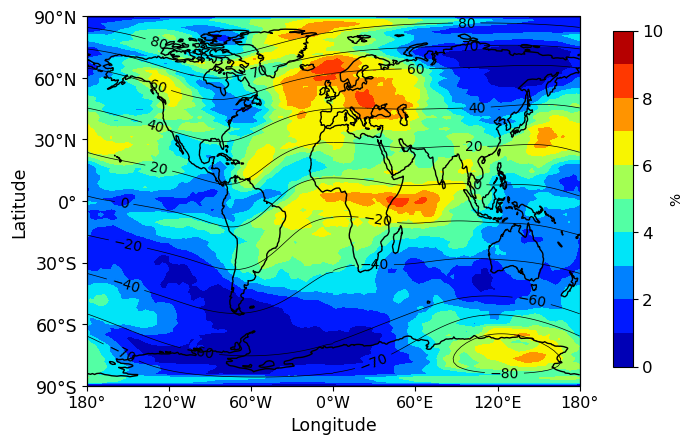

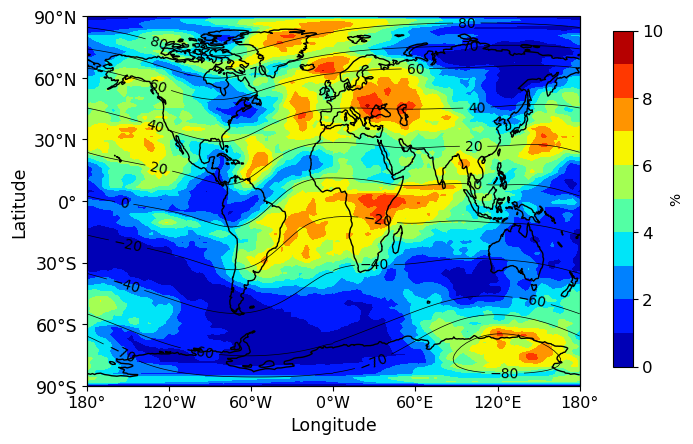

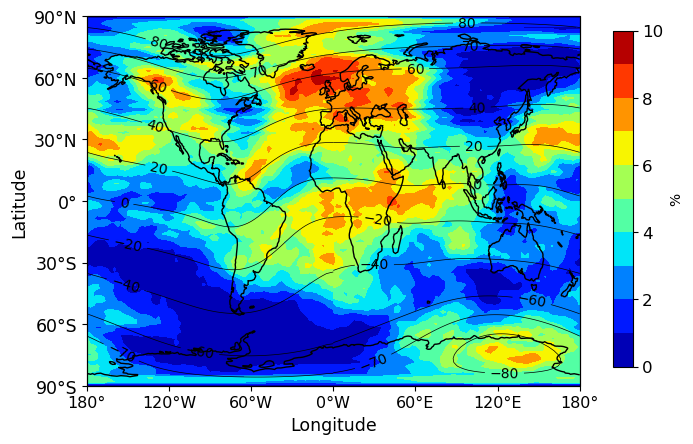

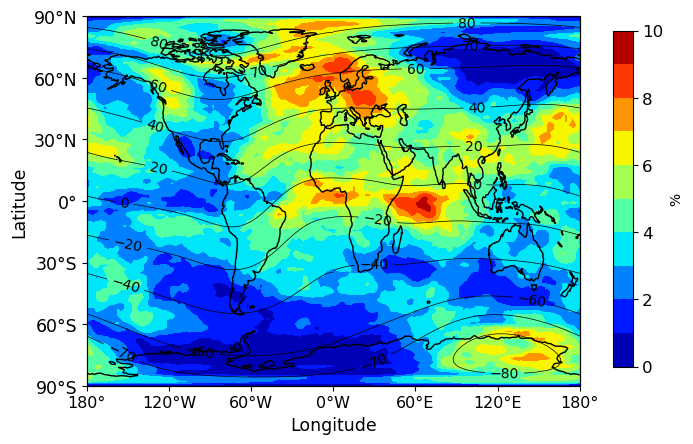

In [17]:
#SpEs Occ Freq plots
### Lat-Lon ###
### Monthly and dataset average ###
#-------------------------------------------------------------------------



filename='Nc_Files/ACP_CESM213_FX2000_f19_f19_mg16_Na_Fe_Mg_iontransport/ACP_CESM213_FX2000_f19_f19_mg16_Na_Fe_Mg_iontransport.cam.h0.0001-' + str(ds_months[0]) + '.nc' 
ds = xr.open_dataset(filename)
ALATM = ds.variables['ALATM'] #Magnetic latitude at each geographic coordinate




# Convert xarray Variable to NumPy array and set last value to 360
lon_plot = lon.values
lon_plot[-1] = 360.


if ds_months_shape>1:
    

    #SpEsns_Occ_Fr_dsavglev[:,:]  (96, 144)
    #------------------------Dataset avg (lat, lon)--------------------------------------------
    #-----------------------Lat-Lon over all heights ------------------------------------------
    #------------------------------------------------------------------------------------------
    
    #ticks = np.geomspace(1, 5*10**4)
    vmin = 0
    vmax = 10
    nolevs = vmax - vmin +1
    
    fig = plt.figure()

    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0))
    ax.set_global()

    
    C = plt.contourf(lon_plot, lat, SpEsns_Occ_Fr_dsavglev, 
                     #levels=ticks,
                     transform=ccrs.PlateCarree(),
                     #locator=ticker.LogLocator(),
                     cmap=jet,
                     #extend='max',
                     levels=np.linspace(vmin, vmax, nolevs), vmin=vmin, vmax=vmax
                     )

    aspect_ratio = 1.5  # Width / Height
    ax.set_aspect(aspect_ratio)
    
    ax.coastlines() 
    #ax.gridlines()

    ax.set_xlabel('Longitude', fontsize=12.5)
    ax.set_ylabel('Latitude', fontsize=12.5)
    
    #ax.set_xticks([0, -150, -120, -90, -60, -30, 0, 30, 60, 90, 120, 150, 180], crs=ccrs.PlateCarree())
    
    # Set the tick positions from -180 to +180 (aligned with the data)
    #ax.set_xticks([-180, -150, -120, -90, -60, -30, 0, 30, 60, 90, 120, 150, 180], crs=ccrs.PlateCarree())
    ax.set_xticks([-180, -120, -60, 0, 60, 120, 180], crs=ccrs.PlateCarree())
    ax.tick_params(axis='x', labelsize=11.5)
    ax.tick_params(axis='y', labelsize=12.5)
    
    ax.set_yticks([-90, -60, -30, 0, 30, 60, 90], crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(LongitudeFormatter(zero_direction_label=True))
    ax.yaxis.set_major_formatter(LatitudeFormatter())  

#    ax.set_title('SpEsns_Occ_Fr_dsavglev: Lat vs Lon, ' + '\n UT ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1])

    cbar_ax = fig.add_axes([0.95, 0.15, 0.03, 0.7])  # Adjust these values to position and size the colorbar # [x, y, width, height]
    cbar = plt.colorbar(C, cax=cbar_ax)
    cbar.set_label(r'%')
    cbar.ax.tick_params(labelsize=12)
    
    # Calculate the actual maximum value in your data
    actual_max_value = np.max(SpEsns_Occ_Fr_dsavglev)

    # Add a text annotation to display the actual maximum value
    #ax.text(1.02, 1.04, f"Max: {actual_max_value:.1f}%", transform=ax.transAxes, ha='left', va='top', backgroundcolor='white',fontsize=11.5)

    # for lat, (bx, by, bz) in zip(lat, magnetic_lines):
    #     plt.plot(bx, by, label=f'Magnetic Latitude {lat}°')
    
    #======================================================================
    ax2 = fig.add_subplot(111, projection=ccrs.PlateCarree())
    ax2.set_global()
    contour_levels = [-80, -70, -60, -40, -20, 0, 20, 40, 60, 70, 80]
    contour = ax2.contour(lon, lat, ALATM[0,:,:], 
                 #cmap=jet, #locator=ticker.LogLocator(),
                 transform=ccrs.PlateCarree(),
                colors='black',
                levels=contour_levels, vmin=-90, vmax=90,
                linestyles='solid',  
                linewidths=0.5
               )
    ax2.set_aspect(aspect_ratio)
    ax2.patch.set_facecolor('none')
    clabels = ax2.clabel(contour, inline=True, fontsize=10)
    #======================================================================
    
    figname='SpEsns_Occ_Fr_dsavglev: Lat vs Lon '  + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] + '.png'
    plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr +  '/Lat-Lon/'+str(figname), dpi = 400, bbox_inches='tight') #
    #plt.tight_layout()
    plt.show()
    #---------------------------------------------------------------------------------------------------
    
    

for ids in ds_months_ar:
    #--------------Set value for ids for plot variables-----------------------
    ids_plot = ids
    str_ids_plot = str(ids_plot)
    #print('Plot month ' + str_ids_plot + ': ' + str(ds_months[ids_plot]) )  
    
    ###lon = np.linspace(0, 360, num=len(lon))

    #SpEsns_Occ_Fr_avglev[:,:,ids] (96, 144, 3)
    #------------------------Monthly avg (lat, lon)--------------------------------------------
    #-----------------------Lat-Lon over all heights ------------------------------------------
    #------------------------------------------------------------------------------------------
    
    #ticks = np.geomspace(1, 5*10**4)
    vmin = 0
    vmax = 10
    nolevs = vmax - vmin +1
    
    fig = plt.figure()

    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0))
    ax.set_global()
    
    

    C = plt.contourf(lon_plot, lat, SpEsns_Occ_Fr_avglev[:,:,ids_plot], 
                     #levels=ticks,
                     transform=ccrs.PlateCarree(),
                     #locator=ticker.LogLocator(),
                     cmap=jet,
                     #extend='max',
                     levels=np.linspace(vmin, vmax, nolevs), vmin=vmin, vmax=vmax
                     )

    aspect_ratio = 1.5  # Width / Height
    ax.set_aspect(aspect_ratio)
    
    ax.coastlines() 
    #ax.gridlines()

    ax.set_xlabel('Longitude', fontsize=12.5)
    ax.set_ylabel('Latitude', fontsize=12.5)

    #ax.set_xticks([0, -150, -120, -90, -60, -30, 0, 30, 60, 90, 120, 150, 180], crs=ccrs.PlateCarree())
    
    # Set the tick positions from -180 to +180 (aligned with the data)
    #ax.set_xticks([-180, -150, -120, -90, -60, -30, 0, 30, 60, 90, 120, 150, 180], crs=ccrs.PlateCarree())
    ax.set_xticks([-180, -120, -60, 0, 60, 120, 180], crs=ccrs.PlateCarree())
    ax.tick_params(axis='x', labelsize=11.5)
    ax.tick_params(axis='y', labelsize=12.5)
        
    
    ax.set_yticks([-90, -60, -30, 0, 30, 60, 90], crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(LongitudeFormatter(zero_direction_label=True))
    ax.yaxis.set_major_formatter(LatitudeFormatter())  

    # if ds_months_shape>1:
    #     ax.set_title('SpEsns_Occ_Fr_avglev: Lat vs Lon, ' + '\n UT ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] )
    # else:
    #     ax.set_title('SpEsns_Occ_Fr_avglev: Lat vs Lon, ' + '\n UT ' + times_str_min[0] + ' : ' + times_str_max[-1] )
    

    cbar_ax = fig.add_axes([0.95, 0.15, 0.03, 0.7])  # Adjust these values to position and size the colorbar # [x, y, width, height]
    cbar = plt.colorbar(C, cax=cbar_ax)
    cbar.set_label(r'%')
    cbar.ax.tick_params(labelsize=12)
    
    # Calculate the actual maximum value in your data
    actual_max_value = np.max(SpEsns_Occ_Fr_avglev[:,:,ids_plot])

    # Add a text annotation to display the actual maximum value
    #ax.text(1.02, 1.04, f"Max: {actual_max_value:.1f}%", transform=ax.transAxes, ha='left', va='top', backgroundcolor='white',fontsize=11.5)

    
    #======================================================================
    ax2 = fig.add_subplot(111, projection=ccrs.PlateCarree())
    ax2.set_global()
    contour_levels = [-80, -70, -60, -40, -20, 0, 20, 40, 60, 70, 80]
    contour = ax2.contour(lon, lat, ALATM[0,:,:], 
                 #cmap=jet, #locator=ticker.LogLocator(),
                 transform=ccrs.PlateCarree(),
                colors='black',
                levels=contour_levels, vmin=-90, vmax=90,
                linestyles='solid',  
                linewidths=0.5
               )
    ax2.set_aspect(aspect_ratio)
    ax2.patch.set_facecolor('none')
    clabels = ax2.clabel(contour, inline=True, fontsize=10)
    #======================================================================
    
    
    
    if ds_months_shape>1:
        figname='SpEsns_Occ_Fr_avglev: Lat vs Lon '   + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] + '.png'
    else:
        figname='SpEsns_Occ_Fr_avglev: Lat vs Lon '   + times_str_min[0] + ' : ' + times_str_max[-1] + '.png'

    
    plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr +  '/Lat-Lon/'+str(figname), dpi = 400, bbox_inches='tight') #
    #plt.tight_layout()
    plt.show()
    #---------------------------------------------------------------------------------------------------
    
    
    
    
    

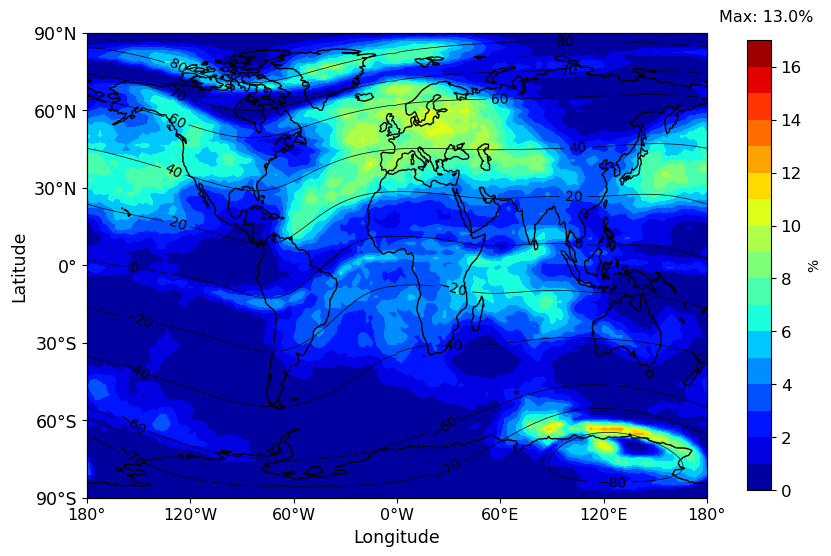

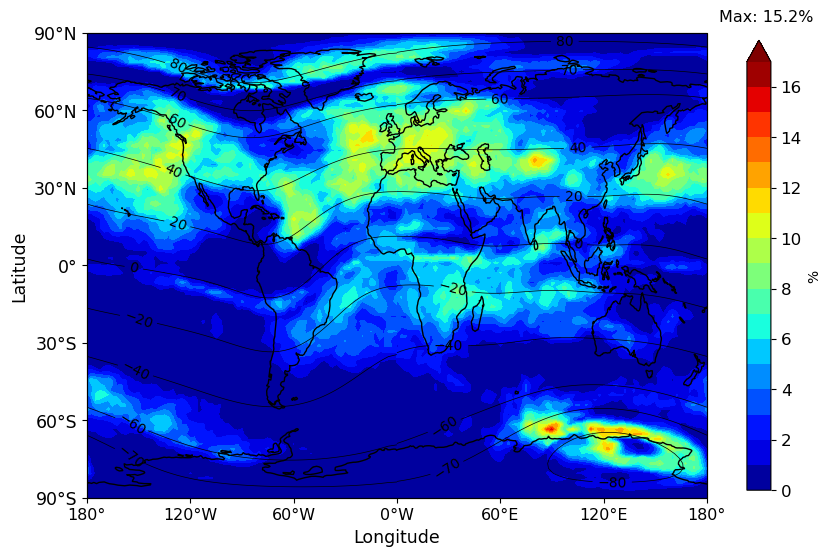

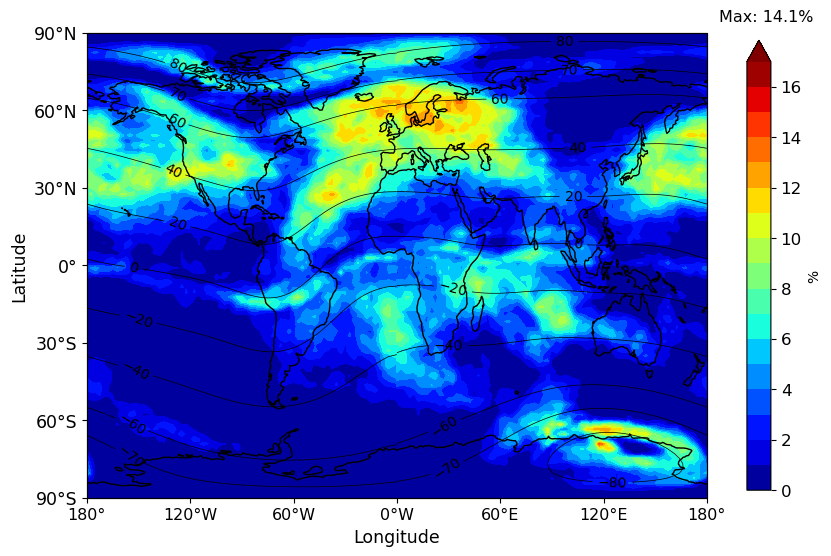

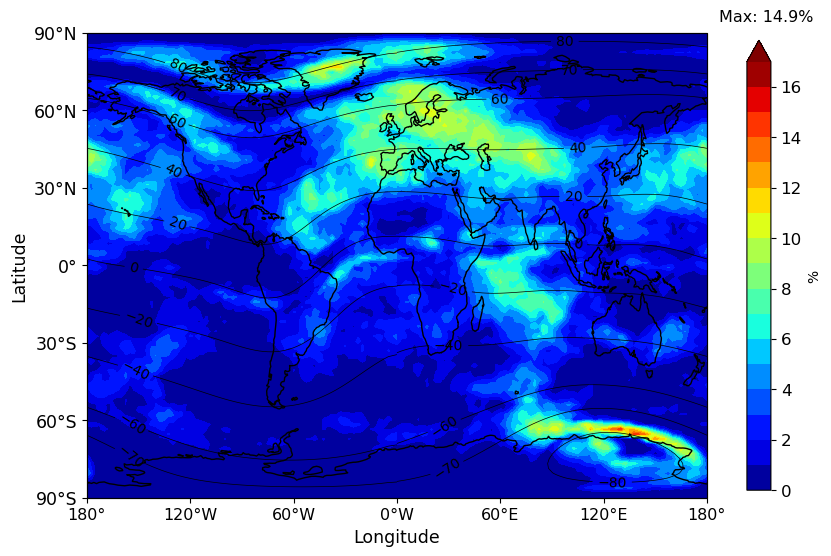

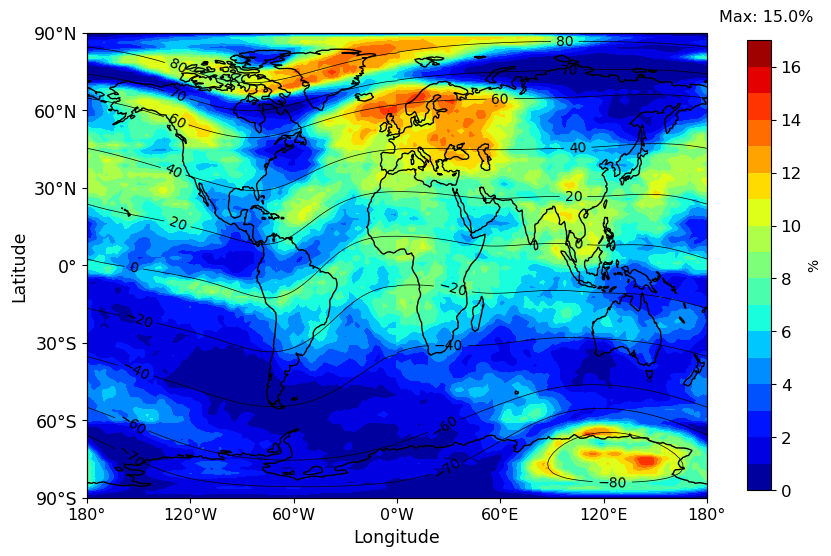

...

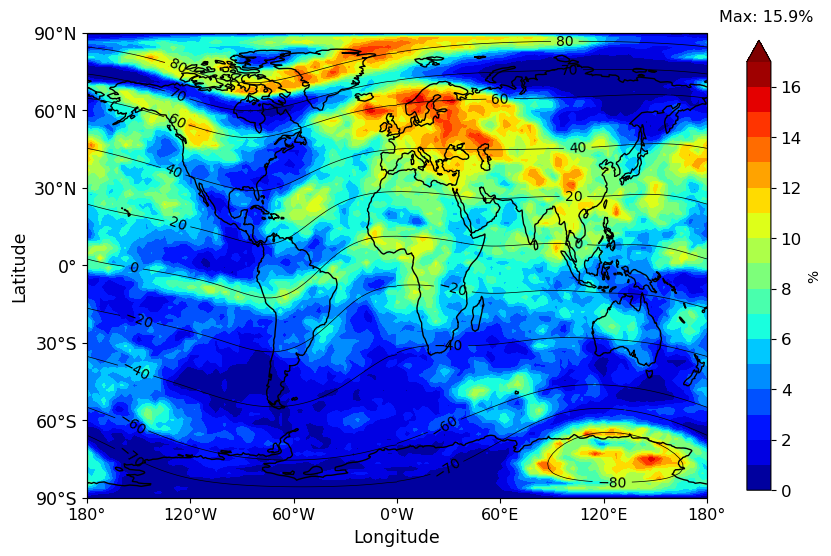

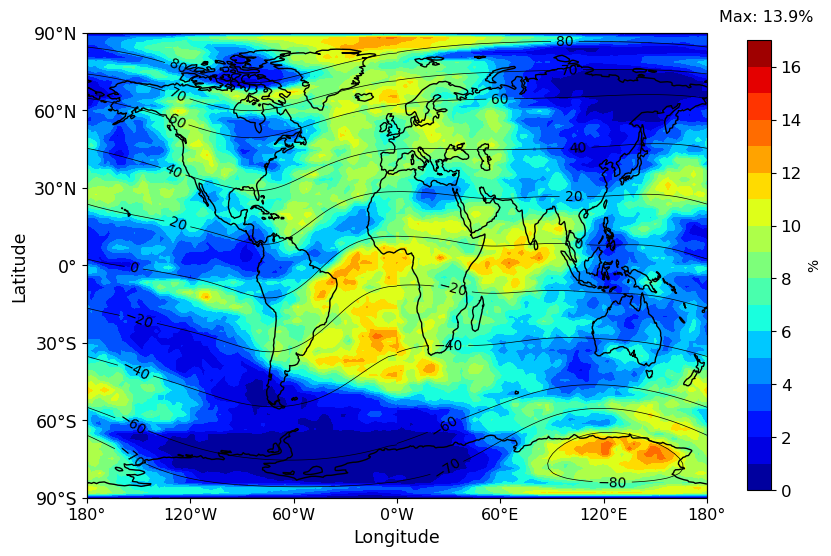

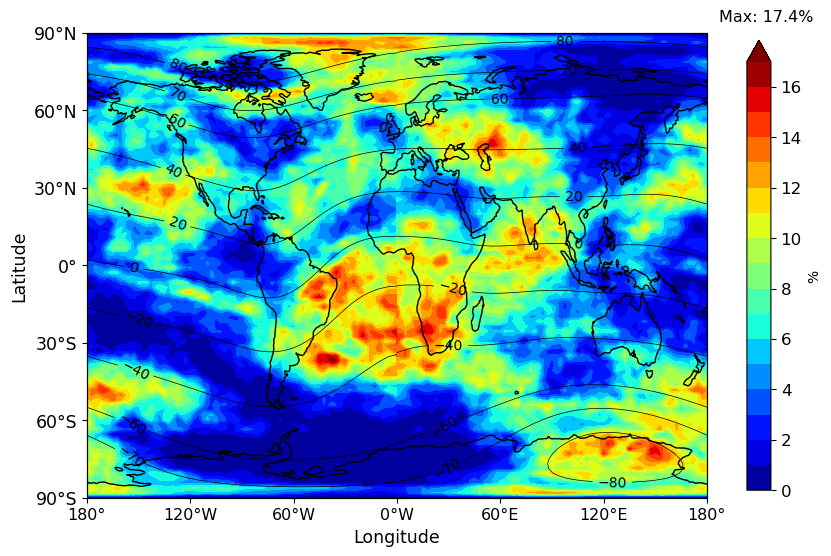

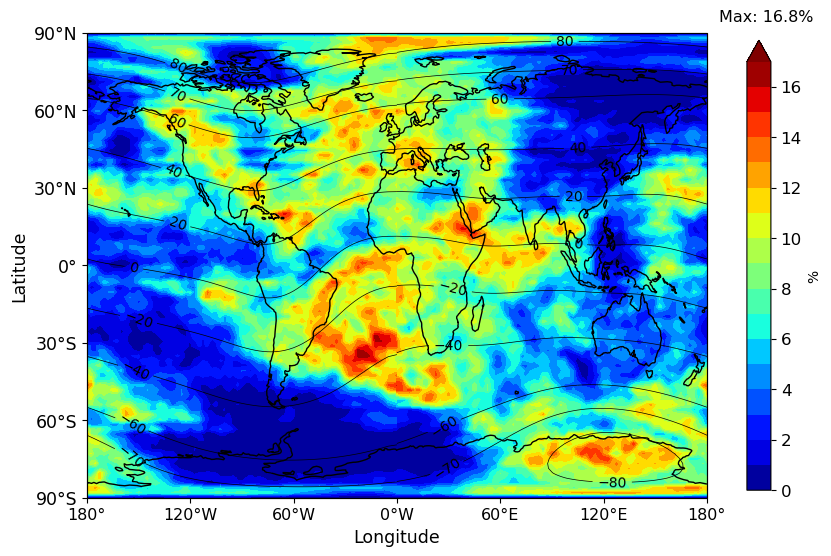

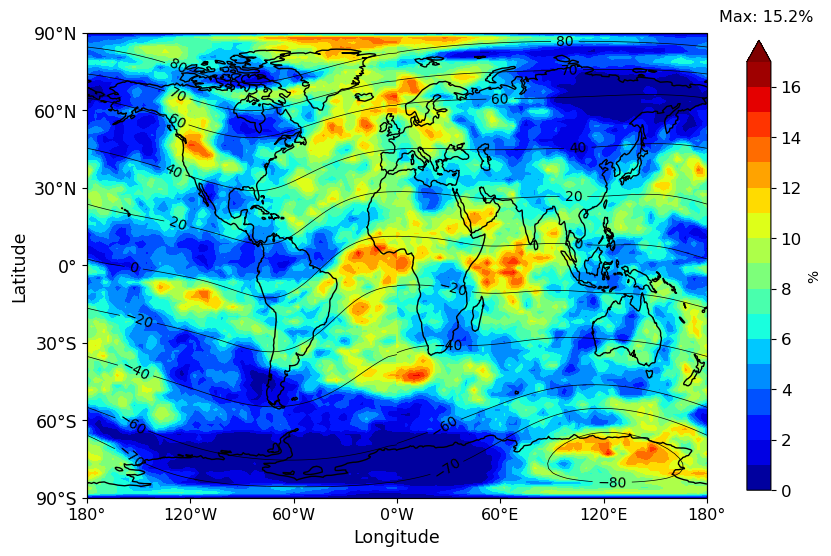

In [18]:
#SpEs Occ Freq plots
### Lat-Lon at specific height ###
### Monthly and dataset average ###
#-------------------------------------------------------------------------
#SpEsns_Occ_Fr_avg[:,:,:,ids](25,96,144,3)
#SpEsns_Occ_Fr_dsavg[:,:,:]  (25,96,144)


# Convert xarray Variable to NumPy array and set last value to 360
lon_plot = lon.values
lon_plot[-1] = 360.


lev_sl_idx_plot_multi = np.array([4,8,14],dtype=int)  #[ 4,  8, 14]  ~114km,~105km,95km
lev_sl_idx_plot_multi_shape = len(lev_sl_idx_plot_multi)  #3
lev_plot_ar = np.arange(0,lev_sl_idx_plot_multi_shape)   #[0,1,2]`


for iplev in lev_plot_ar:   #iterate over multiple levels for lat-LT plots at a specific alt
    #-----------------------------------Lat-LT plot setup ----------------------------------------
    #print('Lat-LT plot setup:')
    lev_sl_idx_plot = lev_sl_idx_plot_multi[iplev]    #14 4.9e-04hPa~95km  #8 1.1e-04hPa~105km  #4 4.0e-05 hPa~114km

    lev_sl_plot = lev_sl[lev_sl_idx_plot]
    lev_sl_plot_str = str("%.1e" % lev_sl_plot) + ' hPa'
    #print('      Plot Lev = ' + lev_sl_plot_str )

    Zavg_sl_plot = Zavg_sl[lev_sl_idx_plot]
    Zavg_sl_plot_str = str("%.0f" % Zavg_sl_plot) + ' km'
    #print('      Approx Z = ' + Zavg_sl_plot_str )
    #===================================================================================================================================================


    if ds_months_shape>1:
        
        
        #SpEsns_Occ_Fr_dsavg[:,:,:]  (25,96,144)
        #--------------------------Dataset avg (lev, lat, LT)-----------------------------------------------
        #-----------------------------------Lat-Lon at specific height----------------------------------------------------------
        #------------------------------------------------------------------------------------------

        SpEsns_Occ_Fr_dsavg_plot = SpEsns_Occ_Fr_dsavg[lev_sl_idx_plot,:,:]    # =Whole Dataset avg   (25, 96, 144)  lev, lat, Lon
        
        #ticks = np.geomspace(1, 5*10**4)
        vmin = 0
        vmax = 17
        nolevs = vmax - vmin +1
        
        fig = plt.figure(figsize=(8,10))

        ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0))
        ax.set_global()

        C = plt.contourf(lon, lat, SpEsns_Occ_Fr_dsavg_plot, 
                         #levels=ticks,
                         transform=ccrs.PlateCarree(),
                         #extend="max",
                         #locator=ticker.LogLocator(),
                         levels=np.linspace(vmin, vmax, nolevs), vmin=vmin, vmax=vmax,
                         cmap=jet)

        aspect_ratio = 1.5  # Width / Height
        ax.set_aspect(aspect_ratio)
        
        ax.coastlines() 
        #ax.gridlines()

        ax.set_xlabel('Longitude', fontsize=12.5)
        ax.set_ylabel('Latitude', fontsize=12.5)

        #ax.set_xticks([0, -150, -120, -90, -60, -30, 0, 30, 60, 90, 120, 150, 180], crs=ccrs.PlateCarree())
        
        # Set the tick positions from -180 to +180 (aligned with the data)
        #ax.set_xticks([-180, -150, -120, -90, -60, -30, 0, 30, 60, 90, 120, 150, 180], crs=ccrs.PlateCarree())
        ax.set_xticks([-180, -120, -60, 0, 60, 120, 180], crs=ccrs.PlateCarree())
        ax.tick_params(axis='x', labelsize=11.5)
        ax.tick_params(axis='y', labelsize=12.5)
        
        
        ax.set_yticks([-90, -60, -30, 0, 30, 60, 90], crs=ccrs.PlateCarree())
        ax.xaxis.set_major_formatter(LongitudeFormatter(zero_direction_label=True))
        ax.yaxis.set_major_formatter(LatitudeFormatter())  

        #ax.set_title('SpEsns_Occ_Fr_dsavg_plot: Lat vs Lon, '  + lev_sl_plot_str  + ', \n UT ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1])

        cbar_ax = fig.add_axes([0.95, 0.27, 0.03, 0.45])  # Adjust these values to position and size the colorbar # [x, y, width, height]
        cbar = plt.colorbar(C, cax=cbar_ax)
        cbar.set_label(r'%')
        cbar.ax.tick_params(labelsize=12)
        
        # Calculate the actual maximum value in your data
        actual_max_value = np.max(SpEsns_Occ_Fr_dsavg_plot)

        # Add a text annotation to display the actual maximum value
        ax.text(1.02, 1.05, f"Max: {actual_max_value:.1f}%", transform=ax.transAxes, ha='left', va='top', backgroundcolor='white',fontsize=11.5)

        
        #======================================================================
        ax2 = fig.add_subplot(111, projection=ccrs.PlateCarree())
        ax2.set_global()
        contour_levels = [-80, -70, -60, -40, -20, 0, 20, 40, 60, 70, 80]
        contour = ax2.contour(lon, lat, ALATM[0,:,:], 
                     #cmap=jet, #locator=ticker.LogLocator(),
                     transform=ccrs.PlateCarree(),
                    colors='black',
                    levels=contour_levels, vmin=-90, vmax=90,
                    linestyles='solid',  
                    linewidths=0.5
                   )
        ax2.set_aspect(aspect_ratio)
        ax2.patch.set_facecolor('none')
        clabels = ax2.clabel(contour, inline=True, fontsize=10)
        #======================================================================
        
        
        figname='SpEsns_Occ_Fr_dsavg_plot: Lat vs Lon '  + lev_sl_plot_str  + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] + '.png'
        plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr +  '/Lat-Lon/'+str(figname), dpi = 400, bbox_inches='tight') #
        #plt.tight_layout()
        plt.show()
        #---------------------------------------------------------------------

        
        
    for ids in ds_months_ar:
        #--------------Set value for ids for plot variables-----------------------
        ids_plot = ids
        str_ids_plot = str(ids_plot)
        #print('Plot month ' + str_ids_plot + ': ' + str(ds_months[ids_plot]) )



        #SpEsns_Occ_Fr_avg[:,:,:,ids](25,96,144,3)
        #--------------------------Dataset avg (lev, lat, LT)-----------------------------------------------
        #-----------------------------------Lat-Lon at specific height----------------------------------------------------------
        #------------------------------------------------------------------------------------------

        SpEsns_Occ_Fr_avg_plot = SpEsns_Occ_Fr_avg[lev_sl_idx_plot,:,:,ids_plot]    # =Whole Dataset avg   (25, 96, 144,3)  lev, lat, Lon, ids

        #ticks = np.geomspace(1, 5*10**4)
        vmin = 0
        vmax = 17
        nolevs = vmax - vmin +1
        
        fig = plt.figure(figsize=(8,10))

        ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0))
        ax.set_global()

        C = plt.contourf(lon, lat, SpEsns_Occ_Fr_avg_plot, 
                         #levels=ticks,
                         transform=ccrs.PlateCarree(),
                         extend="max",
                         #locator=ticker.LogLocator(),
                         levels=np.linspace(vmin, vmax, nolevs), vmin=vmin, vmax=vmax,
                         cmap=jet)

        aspect_ratio = 1.5  # Width / Height
        ax.set_aspect(aspect_ratio)
        
        ax.coastlines() 
        #ax.gridlines()

        ax.set_xlabel('Longitude', fontsize=12.5)
        ax.set_ylabel('Latitude', fontsize=12.5)

        #ax.set_xticks([0, -150, -120, -90, -60, -30, 0, 30, 60, 90, 120, 150, 180], crs=ccrs.PlateCarree())
        # Set the tick positions from -180 to +180 (aligned with the data)
        #ax.set_xticks([-180, -150, -120, -90, -60, -30, 0, 30, 60, 90, 120, 150, 180], crs=ccrs.PlateCarree())
        ax.set_xticks([-180, -120, -60, 0, 60, 120, 180], crs=ccrs.PlateCarree())
        ax.tick_params(axis='x', labelsize=11.5)
        ax.tick_params(axis='y', labelsize=12.5)
        
        ax.set_yticks([-90, -60, -30, 0, 30, 60, 90], crs=ccrs.PlateCarree())
        ax.xaxis.set_major_formatter(LongitudeFormatter(zero_direction_label=True))
        ax.yaxis.set_major_formatter(LatitudeFormatter())  


        
        # if ds_months_shape>1:
        #     ax.set_title('SpEsns_Occ_Fr_avg_plot: Lat vs Lon, '  + lev_sl_plot_str + ', \n UT ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] )
        # else:
        #     ax.set_title('SpEsns_Occ_Fr_avg_plot: Lat vs Lon, '  + lev_sl_plot_str + ', \n UT ' + times_str_min[0] + ' : ' + times_str_max[-1] )

        cbar_ax = fig.add_axes([0.95, 0.27, 0.03, 0.45])  # Adjust these values to position and size the colorbar # [x, y, width, height]
        cbar = plt.colorbar(C, cax=cbar_ax)
        cbar.set_label(r'%')
        cbar.ax.tick_params(labelsize=12)
        
        # Calculate the actual maximum value in your data
        actual_max_value = np.max(SpEsns_Occ_Fr_avg_plot)

        # Add a text annotation to display the actual maximum value
        ax.text(1.02, 1.05, f"Max: {actual_max_value:.1f}%", transform=ax.transAxes, ha='left', va='top', backgroundcolor='white', fontsize=11.5)


        #======================================================================
        ax2 = fig.add_subplot(111, projection=ccrs.PlateCarree())
        ax2.set_global()
        contour_levels = [-80, -70, -60, -40, -20, 0, 20, 40, 60, 70, 80]
        contour = ax2.contour(lon, lat, ALATM[0,:,:], 
                     #cmap=jet, #locator=ticker.LogLocator(),
                     transform=ccrs.PlateCarree(),
                    colors='black',
                    levels=contour_levels, vmin=-90, vmax=90,
                    linestyles='solid',  
                    linewidths=0.5
                   )
        ax2.set_aspect(aspect_ratio)
        ax2.patch.set_facecolor('none')
        clabels = ax2.clabel(contour, inline=True, fontsize=10)
        #======================================================================
        
        
        if ds_months_shape>1:
            figname='SpEsns_Occ_Fr_avg_plot: Lat vs Lon '  + lev_sl_plot_str + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] + '.png'
        else:
            figname='SpEsns_Occ_Fr_avg_plot: Lat vs Lon '  + lev_sl_plot_str + times_str_min[0] + ' : ' + times_str_max[-1] + '.png'

        plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr +  '/Lat-Lon/'+str(figname), dpi = 400, bbox_inches='tight') #
        #plt.tight_layout()
        plt.show()
        #---------------------------------------------------------------------


  

Plot month 0: 06
Plot month 1: 07
Plot month 2: 08


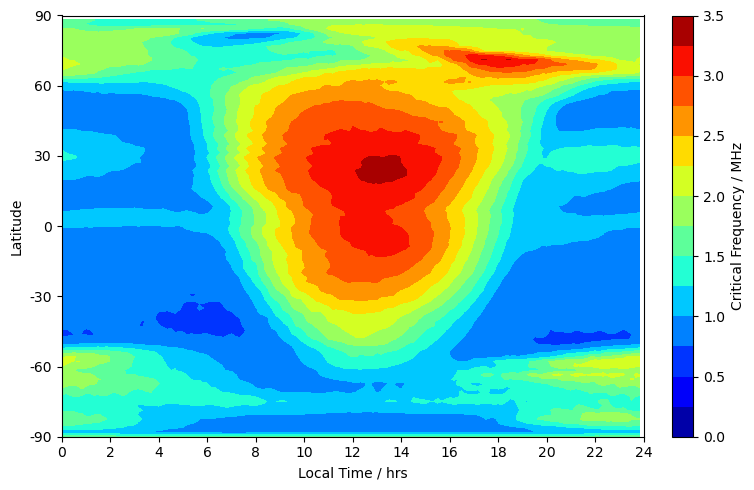

In [9]:
#Critical frequency plots:
    #SpEs_e          #The e density where SpEs have been identified using Fe+ density       
    #edens_sh        #e density in local time
    
    #maxSpEs__e      #max of SpEs_e in cm-3
    #foEs_m          #Critical freq (calculated using max e- density over lev dim in m-3)
    #foEs_m_av       #Avg of foEs_m over lev dimension
    #foEs_m_av_mth   #Average of foEs_m_av over month
    #foEs_m_av_ds    #AVerage of foEs_m_av_mth over dataset (e.g. 3mth)


# time_plot_idx = [12]#,6]#,12,18]
# timearrr = np.arange(0,len(time_plot_idx), dtype=int)


#-----------------------------------Lev-LT plot setup ----------------------------------------
# lat_plot_idx = 74   #21=-50.2   #37 #=-19.9    
# print('      Plot Lat = ' + str("%.1f" % lat[lat_plot_idx])  )
#-----------------------------------
lev_sl_idx_plot_min = 0
lev_sl_idx_plot_max = 24
# print('      Plot Lev = ' + str("%.1e" % lev_sl[lev_sl_idx_plot_max]) + ' hPa' + ' : ' + str("%.1e" % lev_sl[lev_sl_idx_plot_min]) + ' hPa')
# print('      Approx Z = ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_max]) + ' km' + ' : ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_min]) + ' km')

Zavg_sl_plott = Zavg_sl[lev_sl_idx_plot_min:lev_sl_idx_plot_max+1]
Zavg_sl_plott = Zavg_sl_plott.to_numpy()
#Zavg_sl_plottt = np.round_(Zavg_sl_plott, decimals=0)

#-------------------Set up Local Time Ticks-------------------------------
timeconv = lon / 15
timeconv_plot = timeconv.to_numpy() 
#timeconv_plot_ticks = np.arange(0,25, dtype=float)

#------------Set string values for sigma symbol to use in plot------------
#sigma = '\u03C3'
#----------------------------------------


#------------------------ foEs_m_av_ds -----------------------------
#------------------------ Lat-LT -----------------------------

#ticks = np.linspace(0, 5, 21)
vmin = 0
vmax = 3.5
nolevs = 15

fig, ax = plt.subplots(figsize=(8, 5))

C = ax.contourf(timeconv_plot, lat, foEs_m_av_ds,
                 #levels=ticks,
                 levels=np.linspace(vmin, vmax, nolevs), vmin=vmin, vmax=vmax,
                 #locator=ticker.LogLocator(),
                 #extend='min',
                 cmap=jet)

ax.set_ylabel('Latitude')
ax.set_yticks(np.linspace(-90,90, 7)) 
ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

ax.set_xlabel('Local Time / hrs')
xticks = np.linspace(0,24,13) 
ax.set_xticks(xticks) 
ax.set_xticklabels(xticks.astype(int))


#ax.set_title(Crit_name +' '+ 'foEs_m_av_ds, Lat vs LT ' + ',\n UT ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] ) #+ str(times[itr]) )

#ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
#plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

cbar = fig.colorbar(C, pad=0.04)#,ticks=ticks[::4])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
#-------------------

cbar.set_label(r'Critical Frequency / MHz')

figname= Crit_name +' '+ 'foEs_m_av_ds: Lat vs LT ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1]  + '.png'
plt.tight_layout()
path = './Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Lat-LT/foEs/'
plt.savefig(path+str(figname), dpi = 400) #
#-------------------------------------------------------------------




for ids in ds_months_ar:   #iterate over month
    
    start_cftime_date = '0001-' + str(ds_months[ids]) + '-01'
    times = xr.cftime_range(start=start_cftime_date, periods=672, freq="1H", calendar="noleap")    
    
   
    
    #--------------Set value for ids for plot variables-----------------------
    ids_plot = ids
    str_ids_plot = str(ids_plot)
    print('Plot month ' + str_ids_plot + ': ' + str(ds_months[ids_plot]) )
    

    
#     #------------------------ foEs_m_av_mth_plot -----------------------------
#     #------------------------ Lat-LT -----------------------------
#     foEs_m_av_mth_plot = foEs_m_av_mth[:, : , ids_plot]

#     #ticks = np.linspace(0, 5, 21)
#     vmin = 0
#     vmax = 3.5
#     #nolevs = 15
    
#     fig, ax = plt.subplots(figsize=(8, 5))

#     C = ax.contourf(timeconv_plot, lat, foEs_m_av_mth_plot,
#                      #levels=ticks,
#                      levels=np.linspace(vmin, vmax, nolevs), vmin=vmin, vmax=vmax,
#                      #locator=ticker.LogLocator(),
#                      #extend='min',
#                      cmap=jet)

#     ax.set_ylabel('Latitude')
#     ax.set_yticks(np.linspace(-90,90, 7)) 
#     ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

#     ax.set_xlabel('Local Time / hrs')    
#     xticks = np.linspace(0,24,13) 
#     ax.set_xticks(xticks) 
#     ax.set_xticklabels(xticks.astype(int))

#     #ax.set_title(Crit_name +' '+ 'foEs_m_av_mth_plot, Lat vs LT ' + ',\n UT ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] ) #+ str(times[itr]) )

#     #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
#     #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

#     cbar = fig.colorbar(C, pad=0.12)#,ticks=ticks[::4])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
#     #-------------------

#     cbar.set_label(r'Critical Frequency / MHz')

#     figname= Crit_name +' '+ 'foEs_m_av_mth_plot: Lat vs LT ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1]  + '.png'
#     plt.tight_layout()
#     path = './Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Lat-LT/foEs/'
#     plt.savefig(path+str(figname), dpi = 400) #
#     #-------------------------------------------------------------------
        
   










#--------------------------------------------------------






    
#     for it2 in time_ar_2wk:  #iterate over each 2wk sample period
        
#         #--------------Set value for it2 for plot variables-----------------------
#         it2_plot = it2
#         str_it2_plot = str(it2_plot)
     


#         #------------------------ foEs_m_av_plot -----------------------------
#         #------------------------ Lat-LT -----------------------------
#         foEs_m_av_plot = foEs_m_av[:, :, it2_plot , ids_plot]

#         ticks = np.linspace(0, 5, 21)

#         fig, ax = plt.subplots(figsize=(8, 5))

#         C = ax.contourf(timeconv_plot, lat, foEs_m_av_plot,
#                          levels=ticks,
#                          #locator=ticker.LogLocator(),
#                          #extend='min',
#                          cmap=jet)

#         ax.set_ylabel('Latitude')
#         ax.set_yticks(np.linspace(-90,90, 7)) 
#         ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

#         ax.set_xlabel('Local Time / hrs')
#         ax.set_xticks(np.linspace(0,24,13)) 
#         ax.set_xticklabels(timeconv_plot_ticks[::2]) 

#         ax.set_title(Crit_name +' '+ 'foEs_m_av_plot, Lat vs LT ' + ',\n UT ' + times_str_min[ids_plot][it2_plot] + ' : ' + times_str_max[ids_plot][it2_plot] ) #+ str(times[itr]) )

#         #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
#         #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

#         cbar = fig.colorbar(C, pad=0.12)#,ticks=ticks[::4])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
#         #-------------------

#         cbar.set_label(r'Critical Frequency / MHz')

#         figname= Crit_name +' '+ 'foEs_m_av_plot: Lat vs LT ' + times_str_min[ids_plot][it2_plot] + ' : ' + times_str_max[ids_plot][it2_plot]  + '.png'
#         plt.tight_layout()
#         path = './Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Lat-LT/foEs/'
#         #plt.savefig(path+str(figname), dpi = 400) #
#         #-------------------------------------------------------------------
        
        
        
        
#         for itr in timearrr:  #iterate over chosen timesteps for plotting
#             if it2_plot == 0:
#                 plottime = times[ time_plot_idx[itr] ]
#             else:
#                 plottime = times [ time_plot_idx[itr] + 336]
#                 print(plottime)
                

#             #------------------------ maxSpEs_e_plot -----------------------------
#             #------------------------ Lat-LT -----------------------------
#             maxSpEs__e_plot = maxSpEs__e[itr , :, :, it2_plot , ids_plot]
            
#             ticks = np.geomspace(1*10**3, 2*10**5, 30)
#             #ticks = np.geomspace(1*10**9, 1*10**12, 30)
            
#             fig, ax = plt.subplots(figsize=(8, 5))

#             C = ax.contourf(timeconv_plot, lat, maxSpEs__e_plot,
#                              levels=ticks,
#                              locator=ticker.LogLocator(),
#                              #extend='min',
#                              cmap=jet)

#             ax.set_ylabel('Latitude')
#             ax.set_yticks(np.linspace(-90,90, 7)) 
#             ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 
        
#             ax.set_xlabel('Local Time / hrs')
#             ax.set_xticks(np.linspace(0,24,13)) 
#             ax.set_xticklabels(timeconv_plot_ticks[::2]) 

#             ax.set_title(Crit_name +' '+ 'maxSpEs__e_plot, Lat vs LT ' + ',\n UT ' + str(plottime) ) #+ str(times[itr]) )

#             #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
#             #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)
            
#             #------------------
#             def fmt(x, pos):
#                 a, b = '{:.1e}'.format(x).split('e')
#                 b = int(b)
#                 return r'${} \times 10^{{{}}}$'.format(a, b)
        
#             cbar = fig.colorbar(C, pad=0.12,ticks=ticks[::4],format=ticker.FuncFormatter(fmt))#fraction=0.023, 
#             #-------------------

#             cbar.set_label(r'cm$^{-3}$')

#             figname= Crit_name +' '+ 'maxSpEs__e_plot: Lat vs LT ' + str(plottime)  + '.png'
#             plt.tight_layout()
#             path = './Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Lat-LT/foEs/'
#             #plt.savefig(path+str(figname), dpi = 400) #
#             #-------------------------------------------------------------------
            
            

#             #------------------------ foEs_m_plot -----------------------------
#             #------------------------ Lat-LT -----------------------------
#             foEs_m_plot = foEs_m[itr , :, :, it2_plot , ids_plot]
            
#             ticks = np.linspace(0, 5, 21)

#             fig, ax = plt.subplots(figsize=(8, 5))

#             C = ax.contourf(timeconv_plot, lat, foEs_m_plot,
#                              levels=ticks,
#                              #locator=ticker.LogLocator(),
#                              #extend='min',
#                              cmap=jet)

#             ax.set_ylabel('Latitude')
#             ax.set_yticks(np.linspace(-90,90, 7)) 
#             ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 
        
#             ax.set_xlabel('Local Time / hrs')
#             ax.set_xticks(np.linspace(0,24,13)) 
#             ax.set_xticklabels(timeconv_plot_ticks[::2]) 

#             ax.set_title(Crit_name +' '+ 'foEs_m_plot, Lat vs LT ' + ',\n UT ' + str(plottime) ) #+ str(times[itr]) )

#             #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
#             #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

#             cbar = fig.colorbar(C, pad=0.12)#,ticks=ticks[::4])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
#             #-------------------

#             cbar.set_label(r'Critical Frequency / MHz')

#             figname= Crit_name +' '+ 'foEs_m_plot: Lat vs LT ' + str(plottime)  + '.png'
#             plt.tight_layout()
#             path = './Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Lat-LT/foEs/'
#             #plt.savefig(path+str(figname), dpi = 400) #
#             #-------------------------------------------------------------------
        
        
        
        

#             #------------------------ SpEs_e_plot -----------------------------
#             SpEs_e_plot = SpEs_e[:, itr , lat_plot_idx, :, it2_plot , ids_plot]
            
#             ticks = np.geomspace(1*10**2, 2*10**5, 30)
#             #ticks = np.linspace(1*10**2, 2*10**4, 30)

#             fig, ax = plt.subplots(figsize=(8, 5))

#             #C = ax.pcolormesh(timeconv_plot, lev_sl, SpEs_plot)
#             C = ax.contourf(timeconv_plot, Zavg_sl, SpEs_e_plot,   #lev_sl
#                              levels=ticks,
#                              locator=ticker.LogLocator(),
#                              #extend='min',
#                              cmap=jet)

#             #ax.set_yscale('log')
#             #ax.set_ylabel('Pressure / HPa')
#             #ax.set_ylim(lev_sl_plot_max, lev_sl_plot_min) 

#             #ax2 = ax.twinx()
#             #ax2.set_ylabel('Approx Geopotential Height / Km')
#             #ax2.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
#             #ax2.set_yticklabels(Zavg_sl_plottt[lev_sl_idx_plot_max:lev_sl_idx_plot_min:-5])

#             ax.set_ylabel('Approx Geopotential Height / Km')
#             ax.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
            
#             ax.set_xlabel('Local Time / hrs')
#             ax.set_xticks(np.linspace(0,24,13)) 
#             ax.set_xticklabels(timeconv_plot_ticks[::2]) 

#             ax.set_title(Crit_name +' '+ 'SpEs_e_plot, Lev vs LT, lat' + lat_plot_str + ',\n UT ' + str(plottime) ) #+ str(times[itr]) )

#             #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
#             #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)
    
#             cbar = fig.colorbar(C, pad=0.12,ticks=ticks[::4],format=ticker.FuncFormatter(fmt))#fraction=0.023, 
#             #-------------------

#             #cbar.set_label(r'Number of Occurences')

#             figname= Crit_name +' '+ 'SpEs_e_plot: Lev vs LT, lat' + lat_plot_str + ' ' + str(plottime)  + '.png'
#             plt.tight_layout()
#             path = './Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Lev-LT/foEs/'
#             #plt.savefig(path+str(figname), dpi = 400) #
#             #-------------------------------------------------------------------
            
            
            
            
            
#             #------------------------ edens_sh[ilev,it,:,:,it2,ids] -----------------------------
#             edens_sh_plot = edens_sh[:, itr , lat_plot_idx, :, it2_plot , ids_plot]
            
            
#             ticks = np.geomspace(1*10**2, 2*10**5, 30)
#             #ticks = np.linspace(1*10**2, 2*10**4, 30)

#             fig, ax = plt.subplots(figsize=(8, 5))

#             C = ax.contourf(timeconv_plot, Zavg_sl, edens_sh_plot,   #lev_sl
#                              levels=ticks,
#                              locator=ticker.LogLocator(),
#                              extend='min',
#                              cmap=jet)

#             #ax.set_yscale('log')
#             #ax.set_ylabel('Pressure / HPa')
#             #ax.set_ylim(lev_sl_plot_max, lev_sl_plot_min) 

#             #ax2 = ax.twinx()
#             #ax2.set_ylabel('Approx Geopotential Height / Km')
#             #ax2.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
#             #ax2.set_yticklabels(Zavg_sl_plottt[lev_sl_idx_plot_max:lev_sl_idx_plot_min:-5])

#             ax.set_ylabel('Approx Geopotential Height / Km')
#             ax.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
            
#             ax.set_xlabel('Local Time / hrs')
#             ax.set_xticks(np.linspace(0,24,13)) 
#             ax.set_xticklabels(timeconv_plot_ticks[::2]) 

#             ax.set_title(Crit_name +' '+ 'edens_sh_plot, Lev vs LT, lat' + lat_plot_str + ',\n UT ' + str(plottime) ) #+ str(times[itr]) )

#             #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
#             #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

#             cbar = fig.colorbar(C, pad=0.12,ticks=ticks[::4],format=ticker.FuncFormatter(fmt))#fraction=0.023, 
#             #-------------------

#             #cbar.set_label(r'Number of Occurences')

#             figname= Crit_name +' '+ 'edens_sh_plot: Lev vs LT, lat' + lat_plot_str + ' ' + str(plottime)  + '.png'
#             plt.tight_layout()
#             path = './Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Lev-LT/foEs/'
#             #plt.savefig(path+str(figname), dpi = 400) #
#             #-------------------------------------------------------------------




In [ ]:
#===================================================================================================
# Main calculations - for Winds
#===================================================================================================


import xarray as xr
import numpy as np
import cftime
import nc_time_axis
import pandas as pd
import matplotlib.pyplot as plt 
from matplotlib import ticker, cm
from cftime import datetime 
import matplotlib.colors as colors
import math
import random
import matplotlib.cm as mcm
jet = mcm.get_cmap('jet')
import cartopy.crs as ccrs # CRS stands for "Coordinate reference systems" for map projection
from cartopy.crs import PlateCarree
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from dateutil import tz
import pytz
import time
from time import process_time
%matplotlib inline 
#import line_profiler
#%load_ext line_profiler

#===================================================================================================
start_time = time.process_time() 
#===================================================================================================


#/////////////////////////////////////////////////////////////////////////////////////////////////////////
#////////////////////////////  Things to check/change before running  ////////////////////////////////////
#/////////////////////////////////////////////////////////////////////////////////////////////////////////

#winds_on = 1
#--------------------------------------------------------------------------------------------------

#ds_months = ['12','01','02']
#Monthstr = [ 'Dec', 'Jan', 'Feb' ]

#ds_months = ['06','07','08']
#Monthstr = [ 'Jun', 'Jul', 'Aug' ]

#ds_months = ['06','07']
#Monthstr = ['Jun','Jul']

ds_months = ['06']
Monthstr = ['Jun']
#--------------------------------------------------------------------------------------------------
time_ar_2wk = np.arange(0,2)

#times_str_min = np.array( (time_ar_2wk,time_ar_2wk,time_ar_2wk) , dtype=str  ) 
#times_str_max = np.array( (time_ar_2wk,time_ar_2wk,time_ar_2wk) , dtype=str  ) 
#times_str_min = np.array( (time_ar_2wk,time_ar_2wk) , dtype=str  ) 
#times_str_max = np.array( (time_ar_2wk,time_ar_2wk) , dtype=str  ) 
times_str_min = np.array( (time_ar_2wk) , dtype=str  ) 
times_str_max = np.array( (time_ar_2wk) , dtype=str  ) 

#--------------------------------------------------------------------------------------------------

run_name = 'Jianfei_run'
Metal='Fe'

#run_name = 'Wuhu_IonTr_run'    
#run_name = 'Wuhu_IonTr_run_6m'  


'''////////////////  Additional Checks before running  ////////////////

- Check file paths below are correct for datasets
- Check Monthfolderstr is correct (i.e. set manually if doing one month only)
- Check lev_sl_idx_min/max are set to chosen heights (currently ~80-130km). 
        If changing this, N.B some of the [plotting code](?) is set to 25 levs rather than responding if the no of sliced levs changes


- Check Time parameters are correct (time_it_shape, time_ind_2wk_min, time_ind_2wk_max, time_shape) 
        Currently set to iterate over 2x 2wk time slices per month. Each time slice is 336 long. N.B. offset array is set up for 2x2wk periods per mth
'''

#/////////////////////////////////////////////////////////////////////////////////////////////////////////
#/////////////////////////////////////////////////////////////////////////////////////////////////////////
#/////////////////////////////////////////////////////////////////////////////////////////////////////////

Monthfolderstr = Monthstr[0] + '-' + Monthstr[-1]
#Monthfolderstr = 'Jun-Aug'

ds_months_shape = len(ds_months)  #3
ds_months_ar = np.arange(0,ds_months_shape)   #[0,1,2]
#===================================================================================================

#Set time parameters - No of time samples to iterate over (2x 2 week periods)
time_it_shape = 2   
time_ind_2wk_min = [  0, 336]
time_ind_2wk_max = [335, 671]

#Set time parameters - No of timesteps in one time sample (2 week period)
time_shape = 336
timear = np.arange(0,time_shape) # 2 week period (hourly data) 
#--------------------------------------------------------------------------------------------------

lon_shape = 144
lonar = np.arange(0,lon_shape)        
#it_arr = np.arange(0,48) # array 0->47   #0.5h LT bins
#it_ar = np.arange(1,48) # array 1->47 # Used to bin LT (144x 10 min bins) into 0.5h LT bins. N.B. Starting from index1 as index0 is calculated differently

lat_shape = 96
latar= np.arange(0,lat_shape)

newlat = np.arange(-89.5,90.5,1)
newlat_shape = 180
#weights_newlat = np.cos(np.deg2rad(newlat))

intlat = np.arange(-87.5,92.5,5)
intlat_shape = 36
intlat_ar = np.arange(0,intlat_shape)  # array 0->35

lev_sl_idx_min = 42
lev_sl_idx_max = 66
lev_shape = (lev_sl_idx_max-lev_sl_idx_min)+1

levar = np.arange(0,lev_shape)
levarch = levar[1:-1]
ilevar = np.arange(0,lev_shape+1)
levarsl = np.arange(0,lev_shape-1)
levarr = np.arange(1,lev_shape+1) #1-->25


#--------------------------------------------------------------------------------------------------

# Create an array with offset needed for each UT time step (24h period)
# Offset by 15 degrees lon each time, lon axis is in 2.5 degree intervals
offset =  np.arange(0,24) * 15 / 2.5 
offset = offset.astype(int)

# Stack multiple offset arrays to create offsets for consecutive days in the 2 week dataset 
#offset = np.stack((offset, offset, offset, offset, offset, offset, offset, offset, offset, offset, offset, offset, offset, offset), axis=0)   #2wks
#offset = np.reshape(offset, (168*2))
offset = np.tile(offset, 2 * 168)
#--------------------------------------------------------------------------------------------------


#--------------------------------------------------------------------------------------------------

#=================================  Defining Variables  ===========================================

U_wind_sh = np.ndarray( (lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) 

U_wind_sl2_sh = np.ndarray((lev_shape+2,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) 

dz = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
dz_sh = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) 

alt_up = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) 
alt_low = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) 

U_up = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
U_low = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
dU = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)  
dUdz = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)

U_wind_sh_2wk = np.ndarray((lev_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
U_wind_sh_mth = np.ndarray((lev_shape, lat_shape, lon_shape, ds_months_shape), dtype = float)
U_wind_sh_ds = np.ndarray((lev_shape, lat_shape, lon_shape), dtype = float)

dUdz_2wk = np.ndarray((lev_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
dUdz_mth = np.ndarray((lev_shape, lat_shape, lon_shape, ds_months_shape), dtype = float)
dUdz_ds = np.ndarray((lev_shape, lat_shape, lon_shape), dtype = float)

#V_wind_sh = np.ndarray( (lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
#V_wind_sh_2wk = np.ndarray((lev_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
#V_wind_sh_mth = np.ndarray((lev_shape, lat_shape, lon_shape, ds_months_shape), dtype = float)
#V_wind_sh_ds = np.ndarray((lev_shape, lat_shape, lon_shape), dtype = float)

##V_up = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
##V_low = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
##dV = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)  
##dVdz = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
##V_wind_sl2_sh = np.ndarray((lev_shape+2,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float) 

#dU2V2 = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
##dU2V2dz = np.ndarray((lev_shape,time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)

dUdz_2 = np.ndarray((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
dUdz_2_NaN = np.empty((lev_shape, time_shape, lat_shape, lon_shape, time_it_shape, ds_months_shape), dtype = float)
dUdz_2_NaN[:] = np.NaN
#===================================================================================================


for ids in ds_months_ar:
        #===================================================================================================
    if run_name=='Jianfei_run':
        file1name ='Nc_Files/Jianfei_WACCMX_files/waccmx_' + str(Metal) + '_' + str(Metal) + 'p_' + ds_months[ids] + '.nc'
        ds = xr.open_dataset(file1name)
    elif run_name=='Wuhu_IonTr_run':
        file1name='Nc_Files/ACP_CESM213_FX2000_f19_f19_mg16_Na_Fe_Mg_iontransport/ACP_CESM213_FX2000_f19_f19_mg16_Na_Fe_Mg_iontransport.cam.h2.0001-'  + ds_months[ids] +  '-*.nc'
        ds = xr.open_mfdataset(file1name)
    elif run_name=='Wuhu_IonTr_run_6m':
        file1name='Nc_Files/CESM213_FX2000_f19_f19_mg16_Na_Fe_Mg_Si_Ca_K_iontransport/CESM213_FX2000_f19_f19_mg16_Na_Fe_Mg_Si_Ca_K_iontransport.cam.h2.0001-'  + ds_months[ids] +  '-*.nc' 
        ds = xr.open_mfdataset(file1name)
    #===================================================================================================
 
    print('Dataset: Month ' + str(ds_months[ids]) )

    timee = ds.variables['time']
    start_cftime_date = '0001-' + str(ds_months[ids]) + '-01'
    times = xr.cftime_range(start=start_cftime_date, periods=672, freq="1H", calendar="noleap")    

    lon = ds.variables['lon']
    lat = ds.variables['lat']
    lev = ds.variables['lev']
    dst = ds.transpose("lev", ...)
    #===================================================================================================
    
    if run_name=='Jianfei_run':
        file2name='Nc_Files/Jianfei_WACCMX_files/waccmx_Z3_T_e_' + ds_months[ids] + '.nc' 
        ds2 = xr.open_dataset(file2name) 
        ds2t = ds2.transpose("lev", ...)
        temp = ds2t.variables['T']
        geopH = ds2t.variables['Z3'] / 1000 #m-> km
    elif run_name=='Wuhu_IonTr_run' or run_name=='Wuhu_IonTr_run_6m':
        temp = dst.variables['T']
        elect = dst.variables['e']
        geopH = dst.variables['Z3'] / 1000 #m-> km 
    #===================================================================================================
        
    file3name ='Nc_Files/Jianfei_WACCMX_files/waccmx_winds_' + ds_months[ids] + '.nc'
    ds3 = xr.open_dataset(file3name)
    ds3t = ds3.transpose("lev", ...)
    ilev = ds3t.variables['ilev'] #(127)
    U = ds3t.variables['U'] #(126, 672, 96, 144) #U component is positive for a west to east flow (eastward wind) 
    #V = ds3t.variables['V'] #(126, 672, 96, 144) #V component is positive for south to north flow (northward wind)
    #===================================================================================================
    
    Zavg = geopH.mean(('time','lat', 'lon'))

    #===================================================================================================
    
    # Slice arrays (lev & alt) between chosen range & print
    lev_sl = lev[lev_sl_idx_min:lev_sl_idx_max+1]
    Zavg_sl = Zavg[lev_sl_idx_min:lev_sl_idx_max+1]
    
    print('    Array lev = ' + str("%.1e" % lev[lev_sl_idx_max] ) + 'hPa : ' + str("%.1e" % lev[lev_sl_idx_min] ) + 'hPa'
               + ' (approx ' + str("%.0f" % Zavg[lev_sl_idx_max]) + 'km : ' + str("%.0f" % Zavg[lev_sl_idx_min] ) + 'km' + ')'   )
    
    geopH_sl = geopH[lev_sl_idx_min:lev_sl_idx_max+1,:,:,:]

    #===================================================================================================
    #Latitude weighting - not using atm, don't think it's necessary(?)
    #weights = np.cos(np.deg2rad(lat))
    #weights.name = "weights" #doesn't work..
    #print(weights)
    #===================================================================================================

    for it2 in time_ar_2wk:
        #===================================================================================================
        
        #Select time indices for current loop iteration
        times_idx_min = time_ind_2wk_min[it2]
        times_idx_max = time_ind_2wk_max[it2]
        
        # Generate time strings for figure labelling
        if ds_months_shape>1:
            times_str_min[ids][it2] = str( times[times_idx_min] ) 
            times_str_max[ids][it2] = str( times[times_idx_max] ) 
            print( '      Time slice ' + str(it2+1) + ' = ' +times_str_min[ids][it2] + ' : ' + times_str_max[ids][it2] ) 
        else:
            times_str_min[it2] = str( times[times_idx_min] ) #~~#
            times_str_max[it2] = str( times[times_idx_max] ) #~~#
            print( '      Time slice ' + str(it2+1) + ' = ' +times_str_min[it2] + ' : ' + times_str_max[it2] ) 

        #===================================================================================================
        
        # Slice array between chosen time range, leave alt dim unsliced
        geopH_sl_time = geopH[:,times_idx_min:times_idx_max+1,:,:] 

        # Slice by chosen alt range and time range 
        geopH_sl = geopH[lev_sl_idx_min:lev_sl_idx_max+1,times_idx_min:times_idx_max+1,:,:]
        U_wind = U[lev_sl_idx_min:lev_sl_idx_max+1,times_idx_min:times_idx_max+1,:,:] #(25, 336, 96, 144)
        #V_wind = V[lev_sl_idx_min:lev_sl_idx_max+1,times_idx_min:times_idx_max+1,:,:] #(25, 336, 96, 144)
        
        #Slice by one extra either side in lev dim so can calculate dU at array edges
        U_wind_sl2 = U[lev_sl_idx_min-1:lev_sl_idx_max+2,times_idx_min:times_idx_max+1,:,:] #(126, 336, 96, 144)
        #V_wind_sl2 = V[lev_sl_idx_min-1:lev_sl_idx_max+2,times_idx_min:times_idx_max+1,:,:] #(126, 336, 96, 144) 

        #===================================================================================================

        #Iterate over timear (2wk period, hrly data), offsetting at each UT by 15 degrees lon        
        for it in timear:
            U_wind_sh[:,it,:,:,it2,ids] = np.roll(U_wind[:,it,:,:], offset[it] , axis=2)
            U_wind_sl2_sh[:,it,:,:,it2,ids] = np.roll(U_wind_sl2[:,it,:,:], offset[it] , axis=2)
            #V_wind_sh[:,it,:,:,it2,ids] = np.roll(V_wind[:,it,:,:], offset[it] , axis=2)
            #V_wind_sl2_sh[:,it,:,:,it2,ids] = np.roll(V_wind_sl2[:,it,:,:], offset[it] , axis=2)
 
        #===================================================================================================
        
        #Calc dz for first and last lev index (N.B. arrays are sliced but not shifted into LT)
        alt_up[0,:,:,:,it2,ids] = ( geopH_sl_time[lev_sl_idx_min-1,:,:,:] + geopH_sl[0,:,:,:] ) / 2.  
        alt_low[0,:,:,:,it2,ids] = ( geopH_sl[0,:,:,:] + geopH_sl[1,:,:,:] ) / 2.
        dz[0,:,:,:,it2,ids] = alt_up[0,:,:,:,it2,ids] - alt_low[0,:,:,:,it2,ids]

        alt_up[24,:,:,:,it2,ids] = ( geopH_sl[23,:,:,:] + geopH_sl[24,:,:,:] ) / 2.
        alt_low[24,:,:,:,it2,ids] = ( geopH_sl[24,:,:,:] + geopH_sl_time[lev_sl_idx_max+1,:,:,:] ) / 2.
        dz[24,:,:,:,it2,ids] = alt_up[24,:,:,:,it2,ids] - alt_low[24,:,:,:,it2,ids]

        #Iterate over remaining indices and calc dz
        for ilevch in levarch:
            alt_up[ilevch,:,:,:,it2,ids] = ( geopH_sl[ilevch-1,:,:,:] + geopH_sl[ilevch,:,:,:] ) / 2.
            alt_low[ilevch,:,:,:,it2,ids] = ( geopH_sl[ilevch,:,:,:] + geopH_sl[ilevch+1,:,:,:] ) / 2.
            dz[ilevch,:,:,:,it2,ids] = alt_up[ilevch,:,:,:,it2,ids] - alt_low[ilevch,:,:,:,it2,ids] 
            
        dz = dz * 1000. #km --> m

        #Convert dz into local time grid--------------------------------------------
        #Iterate over timear, offsetting at each time by 15 degrees lon
        for it in timear:
            dz_sh[:,it,:,:,it2,ids] = np.roll(dz[:,it,:,:,it2,ids], offset[it] , axis=2)
        #---------------------------------------------------------------------------

        #Calc dU.
        for ilev in levarr: #iterate inds 1->25
            U_up[ilev-1,:,:,:,it2,ids] = U_wind_sl2_sh[ilev-1,:,:,:,it2,ids] - U_wind_sl2_sh[ilev,:,:,:,it2,ids] #ms-1
            U_low[ilev-1,:,:,:,it2,ids] = U_wind_sl2_sh[ilev,:,:,:,it2,ids] - U_wind_sl2_sh[ilev+1,:,:,:,it2,ids] #ms-1
            dU[ilev-1,:,:,:,it2,ids] = U_up[ilev-1,:,:,:,it2,ids] - U_low[ilev-1,:,:,:,it2,ids] #ms-1
            #V_up[ilev-1,:,:,:,it2,ids] = V_wind_sl2_sh[ilev-1,:,:,:,it2,ids] - V_wind_sl2_sh[ilev,:,:,:,it2,ids] #ms-1
            #V_low[ilev-1,:,:,:,it2,ids] = V_wind_sl2_sh[ilev,:,:,:,it2,ids] - V_wind_sl2_sh[ilev+1,:,:,:,it2,ids] #ms-1
            #dV[ilev-1,:,:,:,it2,ids] = V_up[ilev-1,:,:,:,it2,ids] - V_low[ilev-1,:,:,:,it2,ids] #ms-1
        
        #Calc dUdz.
        dUdz[:,:,:,:,it2,ids] = dU[:,:,:,:,it2,ids] / dz_sh[:,:,:,:,it2,ids] #s-1
        #dVdz[:,:,:,:,it2,ids] = dV[:,:,:,:,it2,ids] / dz_sh[:,:,:,:,it2,ids] #s-1

        #Select only data where westward wind above and eastward wind below (theoretical criteria for SpE)
        dUdz_2[:,:,:,:,it2,ids] = np.where( (U_up[:,:,:,:,it2,ids]<0.)&(U_low[:,:,:,:,it2,ids]>0.), dUdz[:,:,:,:,it2,ids] , dUdz_2_NaN[:,:,:,:,it2,ids] )

        #Calc dU2V2. 
        #May be possible to remove loop to speed up code, but not tested
        #for ilev in levar:
        #    for it in timear:
        #        for ilat in latar:
        #            for ilon in lonar:
        #                dU2V2[ilev,it,ilat,ilon,it2,ids] = math.sqrt( ( dU[ilev,it,ilat,ilon,it2,ids]**2 ) + ( dV[ilev,it,ilat,ilon,it2,ids]**2 ) )
        #dU2V2dz[:,:,:,:,it2,ids] = dU2V2[:,:,:,:,it2,ids] / dz_sh[:,:,:,:,it2,ids]

        #Avg over it dim (avg all timesteps within 2wk slice) -> 2wk avg
        U_wind_sh_2wk[:,:,:,it2,ids] = np.mean( U_wind_sh[:,:,:,:,it2,ids] , axis=1 )   
        #V_wind_sh_2wk[:,:,:,it2,ids] = np.mean( V_wind_sh[:,:,:,:,it2,ids] , axis=1 )  
        dUdz_2wk[:,:,:,it2,ids] = np.mean( dUdz[:,:,:,:,it2,ids] , axis=1 )   

        #===================================================================================================
 
    #--- Out of it2 loop (2wk time periods), still in ds loop (month) ---
    #avg over it2 dim -> monthly avg
    U_wind_sh_mth[:,:,:,ids] = np.mean( U_wind_sh_2wk[:,:,:,:,ids], axis=3 )
    #V_wind_sh_mth[:,:,:,ids] = np.mean( V_wind_sh_2wk[:,:,:,:,ids], axis=3 )
    dUdz_mth[:,:,:,ids] = np.mean( dUdz_2wk[:,:,:,:,ids], axis=3 )    
    
#--- Out of it2 loop (2wk time periods) AND ds loop (month) ---
#avg over ids dim -> dataset avg
U_wind_sh_ds[:,:,:] = np.mean( U_wind_sh_mth[:,:,:,:], axis=3 )
#V_wind_sh_ds[:,:,:] = np.mean( V_wind_sh_mth[:,:,:,:], axis=3 )
dUdz_ds[:,:,:] = np.mean( dUdz_mth[:,:,:,:], axis=3 )
    
#===================================================================================================
end_time = time.process_time()
time_taken = end_time - start_time
time_taken_min = time_taken / 60.
print('========================================')
print('Calculation Time = ' + str(time_taken_min) + ' mins' )  


In [ ]:
#U_wind_sh_plot & SpE_sh at individual time step
#U_winds plotted above/at same alt as/below the SpE layer alt
#Trying to see whether there is any correlation between 'zero wind line' and SpE occurrence (i.e. where wind shear changes

#-----------------------------------Lev-LT plot setup ----------------------------------------
lat_plot_idx = 74   #21=-50.2   #37 #=-19.9    +50.2
print('      Plot Lat = ' + str("%.1f" % lat[lat_plot_idx]) )
#-----------------------------------
lev_sl_idx_plot_min = 0
lev_sl_idx_plot_max = 24
print('      Plot Lev = ' + str("%.1e" % lev_sl[lev_sl_idx_plot_max] ) + ' hPa' + ' : ' + str("%.1e" % lev_sl[lev_sl_idx_plot_min] ) + ' hPa')
print('      Approx Z = ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_max]) + ' km' + ' : ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_min]) + ' km')

Zavg_sl_plott = Zavg_sl[lev_sl_idx_plot_min:lev_sl_idx_plot_max+1]
Zavg_sl_plott = Zavg_sl_plott.to_numpy()
#Zavg_sl_plottt = np.round_(Zavg_sl_plott, decimals=0)

#-------------------Set up Local Time Ticks-------------------------------
timeconv = lon / 15
timeconv_plot = timeconv.to_numpy() 
timeconv_plot_ticks = np.arange(0,25, dtype=float)

#------------Set string values for sigma symbol to use in plot------------
sigma = '\u03C3'
#----------------------------------------

# Set chosen/multiple levs to plot for lat-LT at a specific alt
lev_sl_idx_plot_multi = np.array([4,8,14],dtype=int)  #[ 4,  8, 14] ~114km,~105km,95km
lev_sl_idx_plot_multi_shape = len(lev_sl_idx_plot_multi)  #3
lev_plot_ar = np.arange(0,lev_sl_idx_plot_multi_shape)   #[0,1,2]


#Set values for below loops
time_plot_idx = [18]
timearrr = np.arange(0,len(time_plot_idx), dtype=int)

it2_plot = 1
str_it2_plot = str(it2_plot)

ids_plot = 0
ds_months_ar = [0] #np.arange(0,len(ids_plot), dtype=int)

str_ids_plot = str(ids_plot)



for ids in ds_months_ar:   #iterate over month
    
    start_cftime_date = '0001-' + str(ds_months[ids]) + '-01'
    times = xr.cftime_range(start=start_cftime_date, periods=672, freq="1H", calendar="noleap")    
    
   
    
    #--------------Set value for ids for plot variables-----------------------
    ids_plot = ids
    print('Plot month ' + str(ids_plot) + ': ' + str(ds_months[ids_plot]) )
  

    for iplev in lev_plot_ar:   #iterate over multiple levels for lat-LT plots at a specific alt
        #-----------------------------------Lat-LT plot setup ----------------------------------------
        #print('Lat-LT plot setup:')
        lev_sl_idx_plot = lev_sl_idx_plot_multi[iplev]    #14 4.9e-04hPa~95km  #8 1.1e-04hPa~105km  #4 4.0e-05 hPa~114km

        print('      Plot Lev = ' + str("%.1e" % lev_sl[lev_sl_idx_plot]) + ' hPa' )
        print('      Approx Z = ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot]) + ' km' )
        
        lev_sl_plot1_str = str("%.1e" % lev_sl[lev_sl_idx_plot+1]) + ' hPa'
        lev_sl_plot2_str = str("%.1e" % lev_sl[lev_sl_idx_plot-1]) + ' hPa'
        
        Zavg_sl_plot1_str = str("%.0f" % Zavg_sl[lev_sl_idx_plot+1]) + ' km'
        Zavg_sl_plot2_str = str("%.0f" % Zavg_sl[lev_sl_idx_plot-1]) + ' km'
        

        for itr in timearrr:  #
            if it2_plot == 0:
                plottime = times[ time_plot_idx[itr] ]
                #print('1= ' + str(plottime))
            else:
                plottime = times[ time_plot_idx[itr] + 336]
                #print('2= ' + str(plottime))

            plottimestr = str(plottime)
            #print('3= ' + plottimestr)
            
            print('Plot slice ' + str_it2_plot + ': ' + str(times[it2_plot]) )

            #----------------------------------U_wind_sh at specified height-----------------------------------------------------------
            #---------------------------------------------------------------------------------------------

            U_wind_sh_plot = U_wind_sh[lev_sl_idx_plot+1, itr , :, :,  it2_plot , ids_plot ]    #(25, 336, 96, 144, 2, 3)
            
            SpEs_plot = SpEs[lev_sl_idx_plot, itr , :, :,  it2_plot , ids_plot ]    #(25, 336, 96, 144, 2, 3) 
            

            #ticks = np.linspace(0, 12, 25)
            ticks = np.linspace(-120, 120, 7)
            #ticks = np.linspace(0, 40, 21) #(F)

            fig, ax = plt.subplots(figsize=(11, 7))

            C = ax.contour(timeconv_plot, lat, U_wind_sh_plot, 
                             levels=ticks,
                             #locator=ticker.LogLocator(),
                             #extend='min',
                             #cmap=jet)
                              colors='black')

                            
            #P = ax.quiver(timeconv_plot[::6], lat[::6], U_wind_sh_plot[::6,::6], 0 #V_wind_sh_ds_plot[::6,::6]
            #              , scale=100
            #              , scale_units='inches'
            #              , units='inches'
            #              , width=0.02
            #                ) 
            
            ticks2 = np.geomspace(1*10**2, 4*10**4, 30)
            P = ax.contourf(timeconv_plot, lat, SpEs_plot, 
                             levels=ticks2,
                             locator=ticker.LogLocator(),
                             #extend='min',
                             #colors='black'
                             cmap=jet
                             )
            

            ax.set_ylabel('Latitude')
            ax.set_yticks(np.linspace(-90,90, 7)) 
            ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

            ax.set_xlabel('Local Time / hrs')
            ax.set_xticks(np.linspace(0,24,13)) 
            ax.set_xticklabels(timeconv_plot_ticks[::2]) 

            ax.set_title('U_wind_sh_plot, Lat vs LT, ' + lev_sl_plot1_str + ' (approx '+ Zavg_sl_plot1_str + ')' 
                         + ' \n SpEs_plot, ' + lev_sl_plot_str + ' (approx '+ Zavg_sl_plot_str + ')' 
                         + ' \n UT ' + plottimestr )

            #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
            #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

            #------------------
            def fmt(x, pos):
                a, b = '{:.1e}'.format(x).split('e')
                b = int(b)
                return r'${} \times 10^{{{}}}$'.format(a, b)
            
            CB = fig.colorbar(P, fraction=0.05,format=ticker.FuncFormatter(fmt), pad=0.01)
            CB.set_label(r'Fe$^{+}$ density, cm$^{-3}$')
            
            cbar = fig.colorbar(C, pad=0.04)#, orientation='horizontal')#, fraction=0.025,ticks=ticks[::2],format=ticker.FuncFormatter(fmt))#fraction=0.023, 
            cbar.set_label(r'U, ms$^{-1}$')
            
            figname= 'U_wind_sh_plot: Lat vs LT, ' + lev_sl_plot1_str + ' & SpEs_plot ' + lev_sl_plot_str + ' ' + plottimestr + '.png'

            plt.tight_layout()
            #plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Winds' + '/Lat-LT/'+str(figname), dpi = 400) #
            #---------------------------------------------------------------------------------------------------


            
            
                       
            #----------------------------------U_wind_sh at specified height-----------------------------------------------------------
            #---------------------------------------------------------------------------------------------

            U_wind_sh_plot = U_wind_sh[lev_sl_idx_plot, itr , :, :,  it2_plot , ids_plot ]    #(25, 336, 96, 144, 2, 3)


            #ticks = np.linspace(0, 12, 25)
            ticks = np.linspace(-120, 120, 33)
            #ticks = np.linspace(0, 40, 21) #(F)

            #ticks = np.linspace(0, 12, 25)
            ticks = np.linspace(-120, 120, 7)
            #ticks = np.linspace(0, 40, 21) #(F)

            fig, ax = plt.subplots(figsize=(11, 7))

            C = ax.contour(timeconv_plot, lat, U_wind_sh_plot, 
                             levels=ticks,
                             #locator=ticker.LogLocator(),
                             #extend='min',
                             #cmap=jet)
                              colors='black')

                            
            #P = ax.quiver(timeconv_plot[::6], lat[::6], U_wind_sh_plot[::6,::6], 0 #V_wind_sh_ds_plot[::6,::6]
            #              , scale=100
            #              , scale_units='inches'
            #              , units='inches'
            #              , width=0.02
            #                ) 
            
            ticks2 = np.geomspace(1*10**2, 4*10**4, 30)
            P = ax.contourf(timeconv_plot, lat, SpEs_plot, 
                             levels=ticks2,
                             locator=ticker.LogLocator(),
                             #extend='min',
                             #colors='black'
                             cmap=jet
                             )
    
            ax.set_ylabel('Latitude')
            ax.set_yticks(np.linspace(-90,90, 7)) 
            ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

            ax.set_xlabel('Local Time / hrs')
            ax.set_xticks(np.linspace(0,24,13)) 
            ax.set_xticklabels(timeconv_plot_ticks[::2]) 

            #ax.set_title('U_wind_sh_plot, Lat vs LT, ' + lev_sl_plot2_str + ' (approx '+ Zavg_sl_plot2_str + ') \n UT ' + plottimestr )
            
            ax.set_title('U_wind_sh_plot, Lat vs LT, ' #+ lev_sl_plot2_str + ' (approx '+ Zavg_sl_plot2_str + ')' 
             + '& SpEs_plot, ' + lev_sl_plot_str + ' (approx '+ Zavg_sl_plot_str + ')' 
             + ' \n UT ' + plottimestr )

            #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
            #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

            #------------------
            def fmt(x, pos):
                a, b = '{:.1e}'.format(x).split('e')
                b = int(b)
                return r'${} \times 10^{{{}}}$'.format(a, b)

            CB = fig.colorbar(P, fraction=0.05,format=ticker.FuncFormatter(fmt), pad=0.01)
            CB.set_label(r'Fe$^{+}$ density, cm$^{-3}$')
            
            cbar = fig.colorbar(C, pad=0.04)#, orientation='horizontal')#, fraction=0.025,ticks=ticks[::2],format=ticker.FuncFormatter(fmt))#fraction=0.023, 
            cbar.set_label(r'U, ms$^{-1}$')

            figname= 'U_wind_sh_plot: Lat vs LT, ' + lev_sl_plot_str + ' & SpEs_plot ' + lev_sl_plot_str + ' ' + plottimestr + '.png'

            plt.tight_layout()
            #plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Winds' + '/Lat-LT/'+str(figname), dpi = 400) #
            #---------------------------------------------------------------------------------------------------

            
            
            
            
            
            #----------------------------------U_wind_sh at specified height-----------------------------------------------------------
            #---------------------------------------------------------------------------------------------

            U_wind_sh_plot = U_wind_sh[lev_sl_idx_plot-1, itr , :, :,  it2_plot , ids_plot ]    #(25, 336, 96, 144, 2, 3)


            #ticks = np.linspace(0, 12, 25)
            ticks = np.linspace(-120, 120, 33)
            #ticks = np.linspace(0, 40, 21) #(F)

            #ticks = np.linspace(0, 12, 25)
            ticks = np.linspace(-120, 120, 7)
            #ticks = np.linspace(0, 40, 21) #(F)

            fig, ax = plt.subplots(figsize=(11, 7))

            C = ax.contour(timeconv_plot, lat, U_wind_sh_plot, 
                             levels=ticks,
                             #locator=ticker.LogLocator(),
                             #extend='min',
                             #cmap=jet)
                              colors='black')

                            
            #P = ax.quiver(timeconv_plot[::6], lat[::6], U_wind_sh_plot[::6,::6], 0 #V_wind_sh_ds_plot[::6,::6]
            #              , scale=100
            #              , scale_units='inches'
            #              , units='inches'
            #              , width=0.02
            #                ) 
            
            ticks2 = np.geomspace(1*10**2, 4*10**4, 30)
            P = ax.contourf(timeconv_plot, lat, SpEs_plot, 
                             levels=ticks2,
                             locator=ticker.LogLocator(),
                             #extend='min',
                             #colors='black'
                             cmap=jet
                             )
    
            ax.set_ylabel('Latitude')
            ax.set_yticks(np.linspace(-90,90, 7)) 
            ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

            ax.set_xlabel('Local Time / hrs')
            ax.set_xticks(np.linspace(0,24,13)) 
            ax.set_xticklabels(timeconv_plot_ticks[::2]) 

            #ax.set_title('U_wind_sh_plot, Lat vs LT, ' + lev_sl_plot2_str + ' (approx '+ Zavg_sl_plot2_str + ') \n UT ' + plottimestr )
            
            ax.set_title('U_wind_sh_plot, Lat vs LT, ' + lev_sl_plot2_str + ' (approx '+ Zavg_sl_plot2_str + ')' 
             + ' \n SpEs_plot, ' + lev_sl_plot_str + ' (approx '+ Zavg_sl_plot_str + ')' 
             + ' \n UT ' + plottimestr )

            #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
            #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

            #------------------
            def fmt(x, pos):
                a, b = '{:.1e}'.format(x).split('e')
                b = int(b)
                return r'${} \times 10^{{{}}}$'.format(a, b)

            CB = fig.colorbar(P, fraction=0.05,format=ticker.FuncFormatter(fmt), pad=0.01)
            CB.set_label(r'Fe$^{+}$ density, cm$^{-3}$')
            
            cbar = fig.colorbar(C, pad=0.04)#, orientation='horizontal')#, fraction=0.025,ticks=ticks[::2],format=ticker.FuncFormatter(fmt))#fraction=0.023, 
            cbar.set_label(r'U, ms$^{-1}$')


            figname= 'U_wind_sh_plot: Lat vs LT, ' + lev_sl_plot2_str + ' & SpEs_plot ' + lev_sl_plot_str + ' ' + plottimestr + '.png'

            plt.tight_layout()
            #plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Winds' + '/Lat-LT/'+str(figname), dpi = 400) #
            #---------------------------------------------------------------------------------------------------

            
            
            
            

            #----------------------------------SpEs at specified height-----------------------------------------------------------
            #---------------------------------------------------------------------------------------------

#            SpEs_plot = SpEs[lev_sl_idx_plot, itr , :, :,  it2_plot , ids_plot ]    #(25, 336, 96, 144, 2, 3)     

#            ticks = np.geomspace(1*10**2, 2*10**4, 30)

            #ticks = np.linspace(0, 12, 25)
            #ticks = np.linspace(-120, 120, 33)
            #ticks = np.linspace(0, 40, 21) #(F)

#            fig, ax = plt.subplots(figsize=(8, 5))

#            C = ax.contourf(timeconv_plot, lat, SpEs_plot, 
#                             levels=ticks,
#                             locator=ticker.LogLocator(),
#                             #extend='min',
#                             cmap=jet)

            #P = ax.quiver(timeconv_plot[::6], lat[::6], U_wind_sh_plot[::6,::6], 0 #V_wind_sh_ds_plot[::6,::6]
            #              , scale=100
            #              , scale_units='inches'
            #              , units='inches'
            #              , width=0.02
            #                ) 

#            ax.set_ylabel('Latitude')
#            ax.set_yticks(np.linspace(-90,90, 7)) 
#            ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

#            ax.set_xlabel('Local Time / hrs')
#            ax.set_xticks(np.linspace(0,24,13)) 
#            ax.set_xticklabels(timeconv_plot_ticks[::2]) 

#            ax.set_title('SpEs_plot, Lat vs LT, ' + lev_sl_plot_str + ' (approx '+ Zavg_sl_plot_str + ') \n UT ' + plottimestr )

#            ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
#            plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

            #------------------
#            def fmt(x, pos):
#                a, b = '{:.1e}'.format(x).split('e')
#                b = int(b)
#                return r'${} \times 10^{{{}}}$'.format(a, b)

#            cbar = fig.colorbar(C, pad=0.07,ticks=ticks[::2])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
            #-------------------

#            cbar.set_label(r'ms$^{-1}$')


#            figname= 'SpEs_plot: Lat vs LT, ' + lev_sl_plot_str + ' ' + plottimestr + '.png'

#            plt.tight_layout()
            #plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr +'/Winds' +  '/Lat-LT/'+str(figname), dpi = 400) #
            #---------------------------------------------------------------------------------------------------

           

NameError: name 'Zavg_sl_plot_max' is not defined

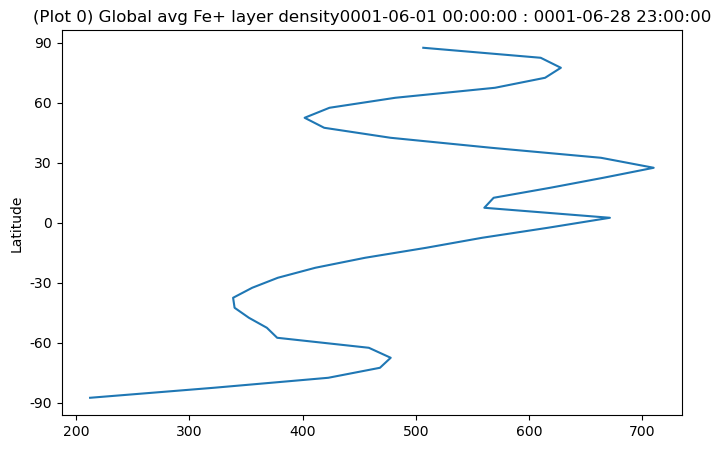

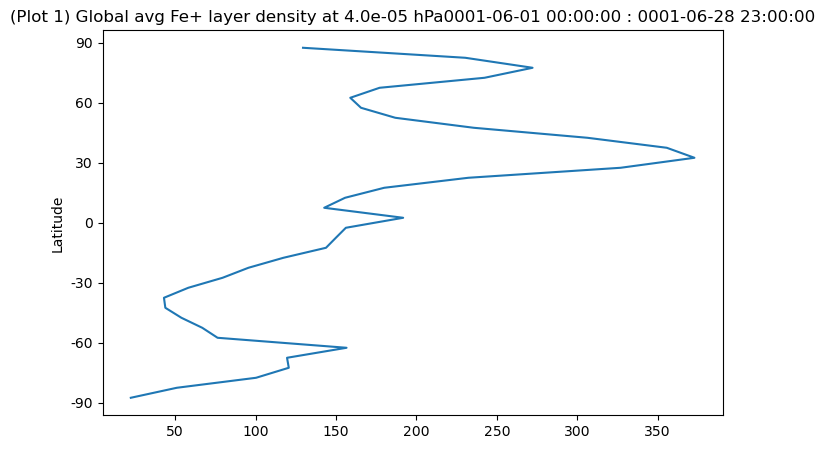

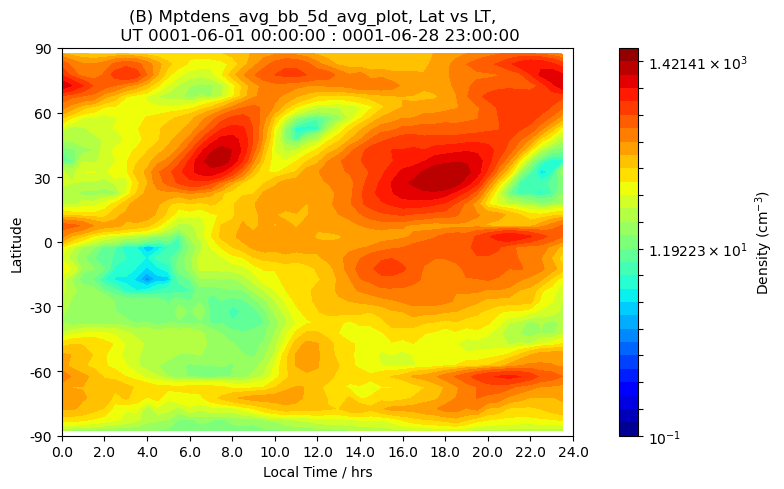

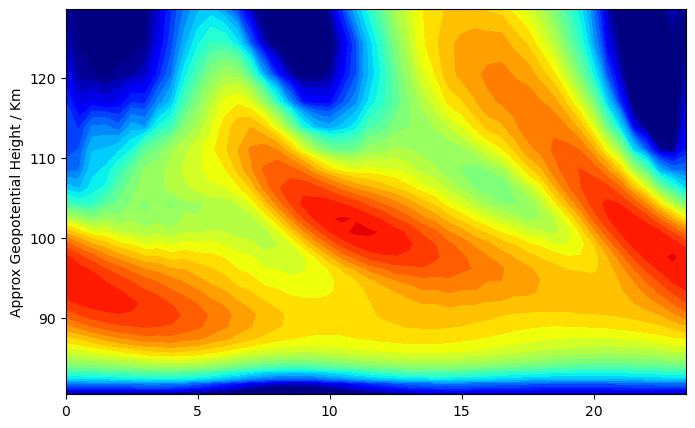

In [3]:
#Plots for testing purposes

    #Metal density in half hour LT bins and 5' lat slices - monthly and dataset avg
        #Mptdens_avg_bb_5d_avg_plot
        #Mptdens_avg_bb_5d_dsavg_plot
    

#===================================================================================================
start_time = time.process_time() 
#===================================================================================================

# Set chosen/multiple lat slices to plot

intlat_plot_idx_multi = np.array([24],dtype=int)    #[20,22,24,26,28],dtype=int) #+ve lats 10-15', 20-25' --> 50-55'       #[7,9,11,13,15],dtype=int) #-ve lats 10-15', 20-25' --> 50-55'     
intlat_plot_idx_multi_shape = len(intlat_plot_idx_multi)  
intlat_plot_ar = np.arange(0,intlat_plot_idx_multi_shape) 



#-----------------------------------Lev-LT plot setup ----------------------------------------
lat_plot_idx = 74   #21=-50.2   #37 #=-19.9    
lat_plot_str = str("%.1f" % lat[lat_plot_idx]) 

#-----------------------------------
lev_sl_idx_plot_min = 0
lev_sl_idx_plot_max = 24
#print('      Plot Lev = ' + str("%.1e" % lev_sl[lev_sl_idx_plot_max]) + ' hPa' + ' : ' + str("%.1e" % lev_sl[lev_sl_idx_plot_min]) + ' hPa')
#print('      Approx Z = ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_max]) + ' km' + ' : ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_min]) + ' km')

#Think this was used to set up tick labels but this is not being used any more
Zavg_sl_plott = Zavg_sl[lev_sl_idx_plot_min:lev_sl_idx_plot_max+1]
Zavg_sl_plott = Zavg_sl_plott.to_numpy()
#Zavg_sl_plottt = np.round_(Zavg_sl_plott, decimals=0)

#-------------------Set up Local Time Ticks-------------------------------
timeconv = lon / 15
timeconv_plot = timeconv.to_numpy() 
timeconv_plot_ticks = np.arange(0,25, dtype=float)

#------------Set string values for sigma symbol to use in plot------------
sigma = '\u03C3'
#----------------------------------------


#levLTticks = np.linspace(0, 16, 17)



#-----------------------------------Lat-LT plot setup ----------------------------------------
# Set chosen/multiple levs to plot for lat-LT at a specific alt

lev_sl_idx_plot_multi = np.array([4],dtype=int)  #[ 4,  8, 14]   ~114km,~105km,95km
lev_sl_idx_plot_multi_shape = len(lev_sl_idx_plot_multi)  #3
lev_plot_ar = np.arange(0,lev_sl_idx_plot_multi_shape)   #[0,1,2]





for ids in ds_months_ar:   #iterate over month
    #--------------Set value for ids for plot variables-----------------------
    ids_plot = ids
    str_ids_plot = str(ids_plot)
    #print('Plot month ' + str_ids_plot + ': ' + str(ds_months[ids_plot]) )
      
        
        
    #---------------------------(Plot 0)--------------------------
    #-----------------------global avg Fe+ layer ------------------------------
    #-----------------------------------------------------      
    Mptdens_avg_bb_5d_avg_plot_a = np.mean ( Mptdens_avg_bb_5d_avg[:,:,:,ids_plot], axis=2 ) #avg over lon
    #print(Mptdens_avg_bb_5d_avg_plot_a.shape)
    Mptdens_avg_bb_5d_avg_plot_avl = np.mean ( Mptdens_avg_bb_5d_avg_plot_a[:,:], axis=0 )  #avg over lev

    fig, ax = plt.subplots(figsize=(8, 5))
    C = ax.plot(Mptdens_avg_bb_5d_avg_plot_avl, intlat)
    ax.set_ylabel('Latitude')
    ax.set_yticks(np.linspace(-90,90, 7)) 
    ax.set_yticklabels((-90,-60,-30,0,30,60,90))
    ax.set_title('(Plot 0) Global avg '+ Metal + '+ layer density' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1])
    #-----------------------------------------------------  
        


        

      
        
        
        
        
    #===================================================================================================================================================
    for iplev in lev_plot_ar:   #iterate over multiple levels for lat-LT plots at a specific alt
        #-----------------------------------Lat-LT plot setup ----------------------------------------
        #print('Lat-LT plot setup:')
        lev_sl_idx_plot = lev_sl_idx_plot_multi[iplev]    #14 4.9e-04hPa~95km  #8 1.1e-04hPa~105km  #4 4.0e-05 hPa~114km
       
        lev_sl_plot = lev_sl[lev_sl_idx_plot]
        lev_sl_plot_str = str("%.1e" % lev_sl_plot) + ' hPa'
        #print('      Plot Lev = ' + lev_sl_plot_str )
        
        #Zavg_sl_plot = Zavg_sl[lev_sl_idx_plot]
        #Zavg_sl_plot_str = str("%.0f" % Zavg_sl_plot) + ' km'
        ##print('      Approx Z = ' + Zavg_sl_plot_str )          
        
        #print('      Plot Lev = ' + str("%.1e" % lev_sl[lev_sl_idx_plot]) + ' hPa' )
        #print('      Approx Z = ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot]) + ' km' )
        #===================================================================================================================================================

              
        
        #-----------------------------------------------------
        #---------------------------global avg Fe+ layer at plot lev --------------------------
        #-----------------------------------------------------
        Mptdens_avg_bb_5d_avg_plot_av = np.mean ( Mptdens_avg_bb_5d_avg[lev_sl_idx_plot,:,:,ids_plot], axis=1 )
        
        fig, ax = plt.subplots(figsize=(8, 5))
        C = ax.plot(Mptdens_avg_bb_5d_avg_plot_av, intlat)
        ax.set_ylabel('Latitude')
        ax.set_yticks(np.linspace(-90,90, 7)) 
        ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 
        ax.set_title(' Global avg '+ Metal + '+ layer density at ' + lev_sl_plot_str + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1])
        #-----------------------------------------------------
        
        
        

        
        
                                         
        #----------------------Monthly avg (lev, lat, LT, ids)----------------------------------------------
        #-----------------------------------Lat-LT----------------------------------------------------------
        #------------------------data averaged in 5' lat slices---------------------------------------------

        Mptdens_avg_bb_5d_avg_plot = Mptdens_avg_bb_5d_avg[lev_sl_idx_plot,:,:,ids_plot]
        
        #-----------------------------------------------------
        ticks = np.geomspace(1*10**-1, 2*10**3, 30)


        fig, ax = plt.subplots(figsize=(8, 5))

        C = ax.contourf(timeconv_plot[::3], intlat, Mptdens_avg_bb_5d_avg_plot,                 
                         levels=ticks,
                         locator=ticker.LogLocator(),
                         #extend='min',
                         cmap=jet)

        ax.set_ylabel('Latitude')
        ax.set_yticks(np.linspace(-90,90, 7)) 
        ax.set_yticklabels((-90,-60,-30,0,30,60,90)) 

        ax.set_xlabel('Local Time / hrs')
        ax.set_xticks(np.linspace(0,24,13)) 
        ax.set_xticklabels(timeconv_plot_ticks[::2]) 

        if ds_months_shape>1:
            ax.set_title(Crit_name +' '+ 'Mptdens_avg_bb_5d_avg_plot, Lat vs LT, ' + ' \n UT ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] ) 
        else:
            ax.set_title(Crit_name +' '+ 'Mptdens_avg_bb_5d_avg_plot, Lat vs LT, ' + ' \n UT ' + times_str_min[0] + ' : ' + times_str_max[-1] ) 

        #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
        #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

        #------------------
        def fmt(x, pos):
            a, b = '{:.1e}'.format(x).split('e')
            b = int(b)
            return r'${} \times 10^{{{}}}$'.format(a, b)

        cbar = fig.colorbar(C, pad=0.07,ticks=ticks[::2])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
        #-------------------

        cbar.set_label(r'Density (cm$^{-3}$)')

        if ds_months_shape>1:
            figname= Crit_name +' '+ 'Mptdens_avg_bb_5d_avg_plot: Lat vs LT, ' + ' ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] + '.png'
        else:
            figname= Crit_name +' '+ 'Mptdens_avg_bb_5d_avg_plot: Lat vs LT, ' + ' ' + times_str_min[0] + ' : ' + times_str_max[-1] + '.png'

        plt.tight_layout()
        #plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/5deg_latbins' + '/Lat-LT/'+str(figname), dpi = 400) #
        #---------------------------------------------------------------------------------------------------

            
            
    for iintlatt in intlat_plot_ar:
        #print('Lev-LT plot setup (intlat):')
        intlat_plot_idx =  intlat_plot_idx_multi[iintlatt] 
        lat_plot_1 = intlat[intlat_plot_idx] -2.5
        lat_plot_2 = intlat[intlat_plot_idx] +2.5
        #print('      Plot lat = ' + str("%.0f" % lat_plot_1)  + ':' + str("%.0f" % lat_plot_2))
  
        
        
        #------------------------Monthly avg (lev, lat, LT, ids)--------------------------------------------
        #-----------------------------------Lev-LT----------------------------------------------------------
        #------------------------data averaged in 5' lat slices---------------------------------------------

        Mptdens_avg_bb_5d_avg_plot = Mptdens_avg_bb_5d_avg[:, intlat_plot_idx, :, ids_plot] 
        #-----------------------------------------------------

        ticks = np.geomspace(1*10**1, 5*10**3, 30)


        fig, ax = plt.subplots(figsize=(8, 5))

        C = ax.contourf(timeconv_plot[::3], Zavg_sl, Mptdens_avg_bb_5d_avg_plot,  #lev_sl
                         levels=ticks,
                         locator=ticker.LogLocator(),
                         extend='min',
                         cmap=jet)

        #ax.set_yscale('log')
        #ax.set_ylabel('Pressure / HPa')
        #ax.set_ylim(lev_sl_plot_max, lev_sl_plot_min) 
        
        #ax2 = ax.twinx()
        #ax2.set_ylabel('Approx Geopotential Height / Km')
        #ax2.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
        #ax2.set_yticklabels(Zavg_sl_plottt[lev_sl_idx_plot_max:lev_sl_idx_plot_min:-5])
        
        ax.set_ylabel('Approx Geopotential Height / Km')
        ax.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)

        
        ax.set_xlabel('Local Time / hrs')
        ax.set_xticks(np.linspace(0,24,13)) 
        ax.set_xticklabels(timeconv_plot_ticks[::2]) 
        
        if ds_months_shape>1:
            ax.set_title(Crit_name +' '+ 'Mptdens_avg_bb_5d_avg_plot, Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ', \n UT ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] )
        else:
            ax.set_title(Crit_name +' '+ 'Mptdens_avg_bb_5d_avg_plot, Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ', \n UT ' + times_str_min[0] + ' : ' + times_str_max[-1] )           
            
        #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
        #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

        #------------------
        def fmt(x, pos):
            a, b = '{:.1e}'.format(x).split('e')
            b = int(b)
            return r'${} \times 10^{{{}}}$'.format(a, b)

        cbar = fig.colorbar(C, pad=0.12,ticks=ticks[::2])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
        #-------------------

        cbar.set_label(r'Density (cm$^{-3}$)')
        if ds_months_shape>1:
            figname= Crit_name +' '+ 'Mptdens_avg_bb_5d_avg_plot: Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ' ' + times_str_min[ids_plot][0] + ' : ' + times_str_max[ids_plot][-1] + '.png'
        else:
            figname= Crit_name +' '+ 'Mptdens_avg_bb_5d_avg_plot: Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ' ' + times_str_min[0] + ' : ' + times_str_max[-1] + '.png'

                         
        plt.tight_layout()
        #plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/5deg_latbins'+ '/Lev-LT/'+str(figname), dpi = 400) #
        #---------------------------------------------------------------------------------------------------

        if ds_months_shape>1:
            
            #--------------------------Dataset avg (lev, lat, LT, ids)------------------------------------------
            #-----------------------------------Lev-LT----------------------------------------------------------
            #------------------------data averaged in 5' lat slices---------------------------------------------
            Mptdens_avg_bb_5d_dsavg_plot = Mptdens_avg_bb_5d_dsavg[:, intlat_plot_idx, :]

            #-----------------------------------------------------


            fig, ax = plt.subplots(figsize=(8, 5))

            C = ax.contourf(timeconv_plot[::3], Zavg_sl, Mptdens_avg_bb_5d_dsavg_plot,    #lev_sl
                             levels=ticks,
                             locator=ticker.LogLocator(),
                             extend='min',
                             cmap=jet)

            #ax.set_yscale('log')
            #ax.set_ylabel('Pressure / HPa')
            #ax.set_ylim(lev_sl_plot_max, lev_sl_plot_min) 

            #ax2 = ax.twinx()
            #ax2.set_ylabel('Approx Geopotential Height / Km')
            #ax2.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
            #ax2.set_yticklabels(Zavg_sl_plottt[lev_sl_idx_plot_max:lev_sl_idx_plot_min:-5])

            ax.set_ylabel('Approx Geopotential Height / Km')
            ax.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)

            ax.set_xlabel('Local Time / hrs')
            ax.set_xticks(np.linspace(0,24,13)) 
            ax.set_xticklabels(timeconv_plot_ticks[::2]) 
            ax.set_title(Crit_name +' '+ 'Mptdens_avg_bb_5d_dsavg_plot, Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ', \n UT ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] )

            #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
            #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

            #------------------
            def fmt(x, pos):
                a, b = '{:.1e}'.format(x).split('e')
                b = int(b)
                return r'${} \times 10^{{{}}}$'.format(a, b)

            cbar = fig.colorbar(C, pad=0.12,ticks=ticks[::2])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
            #-------------------

            cbar.set_label(r'Density (cm$^{-3}$)')

            figname= Crit_name +' '+ 'Mptdens_avg_bb_5d_dsavg_plot: Lev vs LT, lat'  + lat_plot_str1 + ':' + lat_plot_str2 + ' ' + times_str_min[0][0] + ' : ' + times_str_max[-1][-1] + '.png'


            plt.tight_layout()
            #plt.savefig('./Figures/' + run_name +'/Oc_fr/' + Monthfolderstr+ '/5deg_latbins' + '/Lev-LT/'+str(figname), dpi = 400) #
            #---------------------------------------------------------------------------------------------------


        
        
        #for it2 in time_ar_2wk:  #iterate over each 2wk sample period
        #    #--------------Set value for it2 for plot variables-----------------------
        #    it2_plot = it2
        #    str_it2_plot = str(it2_plot)
        #    #print('Plot time ' + str_it2_plot + ': ' + times_str_min[ids_plot][it2_plot] + ' : ' + times_str_max[ids_plot][it2_plot] )
        #    #print('----------------------------------------')   
                
#===================================================================================================
end_time = time.process_time()
time_taken = end_time - start_time
time_taken_min = time_taken / 60.
print('========================================')
print('Calculation Time = ' + str(time_taken_min) + ' mins' ) 

      Plot Lat = 50.2
      Plot Lev = 6.0e-03 hPa : 1.5e-05 hPa
      Approx Z = 36 km : 58 km
Plot month 0: 03


IndexError: too many indices for array: array is 5-dimensional, but 6 were indexed

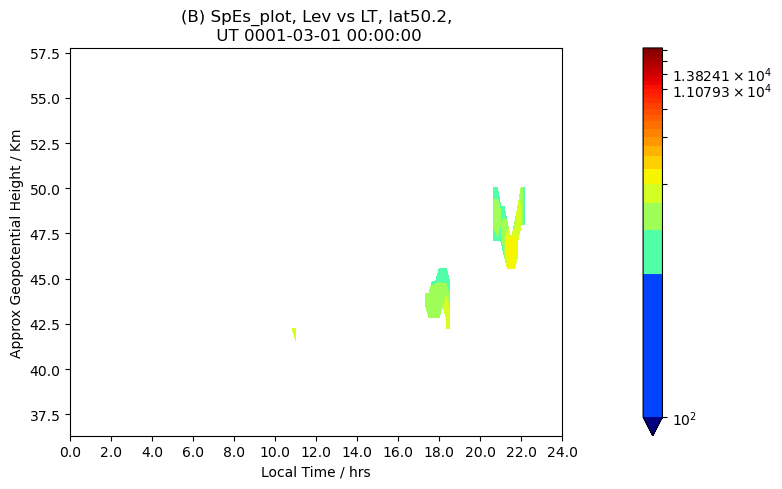

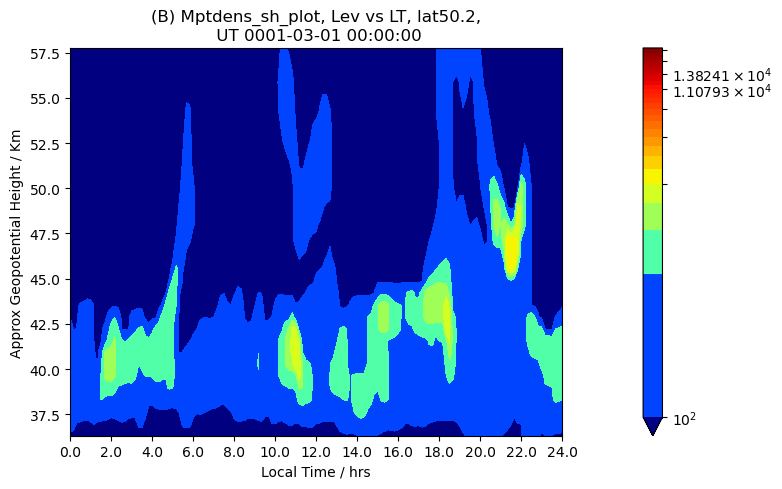

In [31]:
#Plots for testing purposes

#SpEs & Mptdens_sh



time_plot_idx = [0,6,12,18]
timearrr = np.arange(0,len(time_plot_idx), dtype=int)


#-----------------------------------Lev-LT plot setup ----------------------------------------
lat_plot_idx = 74   #21=-50.2   #37 #=-19.9    
lat_plot = lat[lat_plot_idx]
lat_plot_str = str("%.1f" % lat_plot) 
print('      Plot Lat = ' + lat_plot_str )
#-----------------------------------
lev_sl_idx_plot_min = 0
lev_sl_idx_plot_max = 24
print('      Plot Lev = ' + str("%.1e" % lev_sl[lev_sl_idx_plot_max]) + ' hPa' + ' : ' + str("%.1e" % lev_sl[lev_sl_idx_plot_min]) + ' hPa')
print('      Approx Z = ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_max]) + ' km' + ' : ' + str("%.0f" % Zavg_sl[lev_sl_idx_plot_min]) + ' km')

Zavg_sl_plott = Zavg_sl[lev_sl_idx_plot_min:lev_sl_idx_plot_max+1]
Zavg_sl_plott = Zavg_sl_plott.to_numpy()
#Zavg_sl_plottt = np.round_(Zavg_sl_plott, decimals=0)

#-------------------Set up Local Time Ticks-------------------------------
timeconv = lon / 15
timeconv_plot = timeconv.to_numpy() 
timeconv_plot_ticks = np.arange(0,25, dtype=float)

#------------Set string values for sigma symbol to use in plot------------
sigma = '\u03C3'
#----------------------------------------



for ids in ds_months_ar:   #iterate over month
    
    start_cftime_date = '0001-' + str(ds_months[ids]) + '-01'
    times = xr.cftime_range(start=start_cftime_date, periods=672, freq="1H", calendar="noleap")    
    
   
    
    #--------------Set value for ids for plot variables-----------------------
    ids_plot = ids
    str_ids_plot = str(ids_plot)
    print('Plot month ' + str_ids_plot + ': ' + str(ds_months[ids_plot]) )
       
    
    for it2 in time_ar_2wk:  #iterate over each 2wk sample period
        
        #--------------Set value for it2 for plot variables-----------------------
        it2_plot = it2
        str_it2_plot = str(it2_plot)
     
        
        for itr in timearrr:  #
            if it2_plot == 0:
                plottime = times[ time_plot_idx[itr] ]
            else:
                plottime = times [ time_plot_idx[itr] + 336]
                print(plottime)
                
                
    
            
            #------------------------ SpEs_plot -----------------------------
            SpEs_plot = SpEs[:, itr , lat_plot_idx, :, it2_plot , ids_plot]
            
            
            #ticks = np.geomspace(1*10**2, 1*10**3, 30)
            ticks = np.linspace(1*10**2, 2*10**4, 30)

            fig, ax = plt.subplots(figsize=(8, 5))

            #C = ax.pcolormesh(timeconv_plot, lev_sl, SpEs_plot)
            C = ax.contourf(timeconv_plot, Zavg_sl, SpEs_plot,    #lev_sl
                             levels=ticks,
                             locator=ticker.LogLocator(),
                             extend='min',
                             cmap=jet)

            #ax.set_yscale('log')
            #ax.set_ylabel('Pressure / HPa')
            #ax.set_ylim(lev_sl_plot_max, lev_sl_plot_min) 

            #ax2 = ax.twinx()
            #ax2.set_ylabel('Approx Geopotential Height / Km')
            #ax2.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
            #ax2.set_yticklabels(Zavg_sl_plottt[lev_sl_idx_plot_max:lev_sl_idx_plot_min:-5])

            ax.set_ylabel('Approx Geopotential Height / Km')
            ax.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
            
            ax.set_xlabel('Local Time / hrs')
            ax.set_xticks(np.linspace(0,24,13)) 
            ax.set_xticklabels(timeconv_plot_ticks[::2]) 

            ax.set_title(Crit_name +' '+ 'SpEs_plot, Lev vs LT, lat' + lat_plot_str + ',\n UT ' + str(plottime) ) #+ str(times[itr]) )

            #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
            #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

            cbar = fig.colorbar(C, pad=0.12,ticks=ticks[::4])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
            #-------------------

            #cbar.set_label(r'Number of Occurences')

            figname= Crit_name +' '+ 'SpEs_plot: Lev vs LT, lat' + lat_plot_str + ' ' + str(plottime)  + '.png'
            plt.tight_layout()
            path = './Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Lev-LT/SpEs/'
            #plt.savefig(path+str(figname), dpi = 400) #
            
            
            
            
            
            
            
            #------------------------ Mptdens_sh[ilev,it,:,:,it2,ids] -----------------------------
            Mptdens_sh_plot = Mptdens_sh[:, itr , lat_plot_idx, :, it2_plot , ids_plot]
            
            
            #ticks = np.geomspace(1*10**2, 2*10**4, 30)

            fig, ax = plt.subplots(figsize=(8, 5))

            C = ax.contourf(timeconv_plot, Zavg_sl, Mptdens_sh_plot,   #lev_sl
                             levels=ticks,
                             locator=ticker.LogLocator(),
                             extend='min',
                             cmap=jet)

            #ax.set_yscale('log')
            #ax.set_ylabel('Pressure / HPa')
            #ax.set_ylim(lev_sl_plot_max, lev_sl_plot_min) 

            #ax2 = ax.twinx()
            #ax2.set_ylabel('Approx Geopotential Height / Km')
            #ax2.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
            #ax2.set_yticklabels(Zavg_sl_plottt[lev_sl_idx_plot_max:lev_sl_idx_plot_min:-5])

            ax.set_ylabel('Approx Geopotential Height / Km')
            ax.set_ylim(Zavg_sl_plot_max,Zavg_sl_plot_min)
            
            ax.set_xlabel('Local Time / hrs')
            ax.set_xticks(np.linspace(0,24,13)) 
            ax.set_xticklabels(timeconv_plot_ticks[::2]) 

            ax.set_title(Crit_name +' '+ 'Mptdens_sh_plot, Lev vs LT, lat' + lat_plot_str + ',\n UT ' + str(plottime) ) #+ str(times[itr]) )

            #ax.grid(axis='x',color = 'grey', linestyle = '-', linewidth = 0.5)
            #plt.grid(axis='y',color = 'grey', linestyle = '-', linewidth = 0.5)

            cbar = fig.colorbar(C, pad=0.12,ticks=ticks[::4])#,format=ticker.FuncFormatter(fmt))#fraction=0.023, 
            #-------------------

            #cbar.set_label(r'Number of Occurences')

            figname= Crit_name +' '+ 'Mptdens_sh_plot: Lev vs LT, lat' + lat_plot_str + ' ' + str(plottime)  + '.png'
            plt.tight_layout()
            path = './Figures/' + run_name +'/Oc_fr/' + Monthfolderstr + '/Lev-LT/SpEs/'
            #plt.savefig(path+str(figname), dpi = 400) #
            
            
            
            
            
    